In [1]:
import pandas as pd
import numpy as np
import seaborn
import matplotlib
import statistics
from sklearn.decomposition import PCA
from sklearn.decomposition import KernelPCA
from sklearn.manifold import TSNE
from sklearn.manifold import MDS
#from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
import math
import glob
from itertools import combinations
from matplotlib import pyplot as plt
#from ipynb.fs.full.Plot_PCA_functions import *


In [2]:
## ANOTATION DATA
anotation = pd.read_csv('/branchinecta/jbazanwilliamson/SGDP_anotation.csv', sep=',', encoding='latin-1',  index_col=0)
telomeres = pd.read_table('/branchinecta/jbazanwilliamson/telomere_hg38')
centromeres = pd.read_table('/branchinecta/jbazanwilliamson/centromeres_hg38')
hm3_cnv_data = pd.read_table('/branchinecta/jbazanwilliamson/hm3_cnv_submission.txt')
header_list = ['SAMPLE_NAME','TYPE', 'POSITION', 'LENGHT', 'RD', 'T-TEST-EVAL', 'GAUSSIAN-EVAL', 'T-TEST-EVAL(MIDDLE)','GAUSSIAN-EVAL(MIDDLE)', 'FRAQ-READ-QUALITY' ]
cnvnator_data = pd.read_table('/branchinecta/jbazanwilliamson/CNVnator/CNVnator_results.txt', names=header_list)
telomeres['chrom'] = telomeres['chrom'].str.replace('chr', '')

anotation_cnvnator = pd.read_csv('/branchinecta/jbazanwilliamson/SGDP_anotation.csv', sep=',', encoding='latin-1',  index_col=1)

centromeres['chrom'] = centromeres['chrom'].str.replace('chr', '')

black_header = ['chr','start', 'end']
blacklist = pd.read_table('/branchinecta/jbazanwilliamson/bin_anotation/ENCFF356LFX.bed', names=black_header)
blacklist['chr'] = blacklist['chr'].str.replace('chr', '')
black_header = ['chr','start', 'end', 'type', 'score', 'none']
blacklist_2 = pd.read_table('/branchinecta/jbazanwilliamson/bin_anotation/ENCFF220FIN.bed', names=black_header)
blacklist_2['chr'] = blacklist_2['chr'].str.replace('chr', '')
#Table browser is 0-based coordinates, changed to 1-based for compability with CNV data
telomeres['chromStart'] = telomeres['chromStart'] + 1

centromeres['chromStart'] = centromeres['chromStart'] + 1

hm3_cnv_data['chr'] = hm3_cnv_data['chr'].astype(str)

anotation['10-Region'].value_counts()

#CNVNATOR DATA

anotation_cnvnator = anotation_cnvnator.drop(columns=['4-reich_id', '5-ena_ftp_bam_ptr', '6-Sequencing_Panel', '7-Gender', '8-Population_ID', '9-Contributor', '10-Region', '11-Country', '12-Town', '13-Latitude', '14-Longitude', '15-DNA_Source', '16-BioSamples Accession', '17-Embargo'])

features = anotation_cnvnator.merge(cnvnator_data , left_index=True, right_index=True)

### WiseconderX data
header_list_wisecondor = ['SAMPLE_NAME', 'CHR', 'START', 'END', 'RATIO', 'ZSCORE',' TYPE']
wisecondor_data = pd.read_table('/branchinecta/jbazanwilliamson/wisecondor/results/results.txt', names=header_list_wisecondor)


blacklist

,chr,start,end
0,1,628903,635104
1,1,5850087,5850571
2,1,8909610,8910014
3,1,9574580,9574997
4,1,32043823,32044203
...,...,...,...
905,Y,11290797,11334278
906,Y,11493053,11592850
907,Y,11671014,11671046
908,Y,11721528,11749472


In [3]:
def read_vcf_files(vcf_files):
    """
    Read the path of vcf files to a dataframe.

    :param str vcf_file: Path to a vcf files.
    :return: dict of lists of vcf records
    :rtype: dict
    """
    files = glob.glob(vcf_files+'*.vcf')
    vcf_list = []
    for file in files:
        #return pd.DataFrame(read_vcf(file))
        vcf_list.append(read_vcf(file))
    
    return (vcf_list)
    

def read_vcf(vcf_file):
    """
    Read a vcf file to a dict of lists.

    :param str vcf_file: Path to a vcf file.
    :return: dict of lists of vcf records
    :rtype: dict
    """
    vcf_dict = []
    #df = pd.DataFrame()
    with open(vcf_file, 'r') as invcf:
        for line in invcf:
            if line.startswith('#'):
                continue
            line = line.strip().split()
            name = str(vcf_file.split('/')[4])
            name_2 = str(name.split('.')[0])
            CHR = line[0]
            START = line[1]
            INFO = str(line[7].split(';'))
            INFO = INFO.split('=')
            #INFO = INFO.split(',')
            END = INFO
            
        
            #vcf_dict.append((name_2,line[0], line[1], END))
            
            
            vcf_dict.append([name_2,line[0], line[1], line[7], line[9]])
            
    return vcf_dict

In [4]:
df = read_vcf_files('/branchinecta/jbazanwilliamson/QDNASEQ_5K/')
df

Output = []
  
# Using iteration
for temp in df:
    for elem in temp:
        Output.append(elem)

pd.DataFrame(Output)

,0,1,2,3,4
0,SAMEA3302854,2,34470001,SVTYPE=DEL;END=34505000;SVLEN=35000;BINS=6;SCO...,1/1
1,SAMEA3302854,3,75665001,SVTYPE=DUP;END=75710000;SVLEN=45000;BINS=7;SCO...,0/1
2,SAMEA3302854,3,198095001,SVTYPE=DEL;END=198170000;SVLEN=75000;BINS=6;SC...,1/1
3,SAMEA3302854,4,9010001,SVTYPE=DUP;END=9505000;SVLEN=495000;BINS=20;SC...,0/1
4,SAMEA3302854,4,68815001,SVTYPE=DUP;END=68855000;SVLEN=40000;BINS=8;SCO...,0/1
...,...,...,...,...,...
21492,SAMEA3302800,X,154555001,SVTYPE=DEL;END=154650000;SVLEN=95000;BINS=19;S...,1/1
21493,SAMEA3302800,X,155335001,SVTYPE=DEL;END=155385000;SVLEN=50000;BINS=10;S...,1/1
21494,SAMEA3302800,X,155455001,SVTYPE=DEL;END=155505000;SVLEN=50000;BINS=10;S...,1/1
21495,SAMEA3302800,Y,2780001,SVTYPE=DEL;END=26640000;SVLEN=23860000;BINS=44...,1/1


In [5]:
df = pd.DataFrame(Output)
info = df[3].str.split(';', expand=True)


end = info[1].str.split('=', expand=True)
end = end[1]


size = info[2].str.split('=', expand=True)
size = size[1]

score = info[4].str.split('=', expand=True)
score = score[1]

log2 = info[5].str.split('=', expand=True)
log2 = log2[1]


In [6]:
qdnaseq_df = pd.DataFrame()
qdnaseq_df['SAMPLE'] = df[0]
qdnaseq_df['CHR'] = df[1]
qdnaseq_df['START'] = df[2].astype(int)
qdnaseq_df['END'] = end.astype(int)
qdnaseq_df['SIZE'] = size.astype(int)
qdnaseq_df['SCORE'] = score
qdnaseq_df['LOG2'] = log2.astype(float)

#CHANGING to HAPMAP format


qdnaseq_df.SCORE.value_counts()

qdnaseq_df['SCORE'].replace('-2', 0, inplace=True)
qdnaseq_df['SCORE'].replace('-1', 1, inplace=True)
qdnaseq_df['SCORE'].replace('1', 3, inplace=True)
qdnaseq_df['SCORE'].replace('2', 4, inplace=True)
qdnaseq_df['SCORE'].replace('3', 5, inplace=True)


#Filter by CNV size
#qdnaseq_df = qdnaseq_df.loc[((qdnaseq_df['SIZE'] > 1000000) & (qdnaseq_df['SIZE'] < 5000000)),:]
qdnaseq_df.to_csv('/branchinecta/jbazanwilliamson/1_122_QDNASEQ_DATA.csv')

qdnaseq_df['SAMPLE'].value_counts()

#DROP Y AND X CHRs

#FILTERR BY LOG SIGNIFICATION
qdnaseq_df_low = qdnaseq_df[qdnaseq_df.LOG2 < -0.3]
qdnaseq_df_high = qdnaseq_df[qdnaseq_df.LOG2 > 0.3]
qdnaseq_df = pd.concat([qdnaseq_df_high,qdnaseq_df_low])

#FILTER OUT SAMPLES WITH HIGH NUMBER OF CNVS 
qdnaseq_df = qdnaseq_df[qdnaseq_df.groupby("SAMPLE")["SAMPLE"].transform('size') < 1000]


samples_with_aberrations = ['SAMEA3302841', 'SAMEA3302787','SAMEA3302646', 'SAMEA3302785']

qdnaseq_df = qdnaseq_df[~qdnaseq_df.SAMPLE.isin(samples_with_aberrations)]

## Filter by chromosomes
qdnaseq_df_x = qdnaseq_df[qdnaseq_df.CHR == 'X']
qdnaseq_df_no_sex_chr = qdnaseq_df[qdnaseq_df.CHR != 'Y']
qdnaseq_df_no_sex_chr = qdnaseq_df_no_sex_chr[qdnaseq_df_no_sex_chr.CHR != 'X']


#qdnaseq_df = qdnaseq_df[qdnaseq_df.CHR != 'Y']
#qdnaseq_df = qdnaseq_df[qdnaseq_df.CHR != 'X']


# To array for loop purposes 

np_data_style = qdnaseq_df.to_numpy()

telomere = telomeres.to_numpy()
centromere = centromeres.to_numpy()

np_hm3 = hm3_cnv_data.to_numpy()


qdnaseq_df

,SAMPLE,CHR,START,END,SIZE,SCORE,LOG2
1,SAMEA3302854,3,75665001,75710000,45000,3,0.90
3,SAMEA3302854,4,9010001,9505000,495000,3,0.59
4,SAMEA3302854,4,68815001,68855000,40000,3,0.45
9,SAMEA3302854,7,2230001,2315000,85000,3,0.58
11,SAMEA3302854,7,65795001,65815000,20000,3,0.94
...,...,...,...,...,...,...,...
21492,SAMEA3302800,X,154555001,154650000,95000,0,-2.54
21493,SAMEA3302800,X,155335001,155385000,50000,0,-6.19
21494,SAMEA3302800,X,155455001,155505000,50000,0,-6.15
21495,SAMEA3302800,Y,2780001,26640000,23860000,0,-20.51


<h1> Telomeres and centromers remotion 


In [7]:
wotelomeres= []

wocentromeres = []


for telomere in telomere:
    for cnv in np_data_style:
    
        if cnv[1] == telomere[1]: #Chromosome
            if telomere[2] <= cnv[2] <= telomere[3]:
                wotelomeres.append(cnv)
                
            if telomere[3] <= cnv[3] <= telomere[3]:
                wotelomeres.append(cnv)
         
        
wotelomeres = np.array(wotelomeres)

for centromere in centromere:
    for cnv in np_data_style:
        
        if cnv[1] == centromere[1]: #Chromosome
            if centromere[2] <= cnv[2] <= centromere[3]:
                wocentromeres.append(cnv) 
                
            if centromere[2] <= cnv[3] <= centromere[3]:
                wocentromeres.append(cnv) 
wocentromeres = np.array(wocentromeres)

<h1> Blacklist regions elimination

In [8]:
wobl_1= []

wobl_2 = []


for black in blacklist.to_numpy():
    for cnv in np_data_style:
    
        if cnv[1] == black[0]: #Chromosome
            if cnv[2] <= black[1] <= cnv[3] or cnv[2] <= black[1] <= cnv[3]:
            #if black[1] <= cnv[2] <= black[2] or black[1] <= cnv[3] <= black[2]:
                wobl_1.append(cnv)
                
         #   if black[1] <= cnv[3] <= black[2]:
         #       wobl_1.append(cnv)
         
        
wobl_1 = np.array(wobl_1)

for black_2 in blacklist_2.to_numpy():
    for cnv in np_data_style:
        
        if cnv[1] == black_2[0]: #Chromosome
            if cnv[2] <= black_2[1] <= cnv[3] or cnv[2] <= black_2[1] <= cnv[3]:
           # if black_2[1] <= cnv[2] <= black_2[2]:
                wobl_2.append(cnv) 
                
            if black_2[1] <= cnv[3] <= black_2[2]:
                wobl_2.append(cnv) 
wobl_2 = np.array(wobl_2)

In [9]:
telomeres_data = pd.DataFrame(wotelomeres)
centromeres_data = pd.DataFrame(wocentromeres)

frames = [telomeres_data, centromeres_data]

blacklist_data = pd.DataFrame(wobl_1)
blacklist_2_data = pd.DataFrame(wobl_2)



frames = [telomeres_data,centromeres_data, blacklist_data, blacklist_2_data]

result = pd.concat(frames)

result.columns =['SAMPLE', 'CHR', 'START', 'END', 'SIZE','SCORE', 'LOG2']
#result = result.drop_duplicates()
#result


df = pd.concat([result, qdnaseq_df])
df = df.drop_duplicates(keep=False)

chromosomes= ['1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22','X','Y']

df = df[df.CHR.isin(chromosomes)]

df['START'] = df['START'].astype(int)
df['END'] = df['END'].astype(int)
df['SCORE'] = df['SCORE'].astype(int)
df['LOG2'] = df['LOG2'].astype(float)

#df.to_csv("cnvator_data_no_telo_no_centro.csv",  index= False)
qdnaseq_df = df
qdnaseq_df

,SAMPLE,CHR,START,END,SIZE,SCORE,LOG2
3,SAMEA3302854,4,9010001,9505000,495000,3,0.59
4,SAMEA3302854,4,68815001,68855000,40000,3,0.45
9,SAMEA3302854,7,2230001,2315000,85000,3,0.58
11,SAMEA3302854,7,65795001,65815000,20000,3,0.94
15,SAMEA3302854,9,42260001,42405000,145000,3,0.69
...,...,...,...,...,...,...,...
21491,SAMEA3302800,X,154145001,154295000,150000,0,-6.55
21492,SAMEA3302800,X,154555001,154650000,95000,0,-2.54
21493,SAMEA3302800,X,155335001,155385000,50000,0,-6.19
21494,SAMEA3302800,X,155455001,155505000,50000,0,-6.15


In [10]:
qdnaseq_df



,SAMPLE,CHR,START,END,SIZE,SCORE,LOG2
3,SAMEA3302854,4,9010001,9505000,495000,3,0.59
4,SAMEA3302854,4,68815001,68855000,40000,3,0.45
9,SAMEA3302854,7,2230001,2315000,85000,3,0.58
11,SAMEA3302854,7,65795001,65815000,20000,3,0.94
15,SAMEA3302854,9,42260001,42405000,145000,3,0.69
...,...,...,...,...,...,...,...
21491,SAMEA3302800,X,154145001,154295000,150000,0,-6.55
21492,SAMEA3302800,X,154555001,154650000,95000,0,-2.54
21493,SAMEA3302800,X,155335001,155385000,50000,0,-6.19
21494,SAMEA3302800,X,155455001,155505000,50000,0,-6.15


In [8]:
deletions = qdnaseq_df[qdnaseq_df['SCORE'] < 2] 
duplications= qdnaseq_df[qdnaseq_df['SCORE'] > 2] 

deletions

,SAMPLE,CHR,START,END,SIZE,SCORE,LOG2
765,SAMEA3302795,1,820001,55045000,54225000,0,1.30
774,SAMEA3302795,6,155001,2935000,2780000,1,0.54
776,SAMEA3302795,6,2990001,3830000,840000,1,1.01
783,SAMEA3302795,6,29500001,44685000,15185000,0,1.13
784,SAMEA3302795,7,40001,159335000,159295000,1,0.34
...,...,...,...,...,...,...,...
21492,SAMEA3302800,X,154555001,154650000,95000,0,-2.54
21493,SAMEA3302800,X,155335001,155385000,50000,0,-6.19
21494,SAMEA3302800,X,155455001,155505000,50000,0,-6.15
21495,SAMEA3302800,Y,2780001,26640000,23860000,0,-20.51


In [17]:
qdnaseq_pvt = qdnaseq_df.pivot_table(index=["CHR", "START", "END"], 
                    columns='SAMPLE', 
                    values='SCORE').reset_index()

qdnaseq_pvt

SAMPLE,CHR,START,END,SAMEA3302610,SAMEA3302611,SAMEA3302612,SAMEA3302613,SAMEA3302614,SAMEA3302615,SAMEA3302616,...,SAMEA3302894,SAMEA3302896,SAMEA3302900,SAMEA3302902,SAMEA3302903,SAMEA3302904,SAMEA3302906,SAMEA3302908,SAMEA3302911,SAMEA3449877
0,1,820001,930000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,820001,55045000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,1445001,1500000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,1470001,1510000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,1475001,1510000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3861,Y,25195001,26310000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3862,Y,26310001,26675000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN
3863,Y,26525001,26645000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3864,Y,26630001,26675000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN


In [26]:
import seaborn
counts = qdnaseq_pvt.iloc[:,3:283]

counts = counts.fillna(2)

#hist = (np.array(counts).flatten())
#seaborn.histplot(hist)


counts

SAMPLE,SAMEA3302610,SAMEA3302611,SAMEA3302612,SAMEA3302613,SAMEA3302614,SAMEA3302615,SAMEA3302616,SAMEA3302618,SAMEA3302619,SAMEA3302620,...,SAMEA3302894,SAMEA3302896,SAMEA3302900,SAMEA3302902,SAMEA3302903,SAMEA3302904,SAMEA3302906,SAMEA3302908,SAMEA3302911,SAMEA3449877
0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
1,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
2,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
3,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
4,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,4.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3861,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
3862,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0
3863,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
3864,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,1.0,2.0,2.0,2.0,2.0


#DELETE EUROPEAN SAMPLES
#NOT DIFERENCE

#track features for pca & tsne
cnvs = counts.T
features = anotation.merge(count, left_index=True, right_index=True)
features = features.loc[:,["7-Gender","10-Region", "11-Country"]]
features


non_europ = features.merge(cnvs, left_index=True, right_index=True)
non_europ = non_europ[non_europ['10-Region'] != 'WestEurasia']
non_europ = non_europ.drop(['7-Gender','10-Region','11-Country'], axis=1)

counts = non_europ.T


ValueError: zero-size array to reduction operation minimum which has no identity

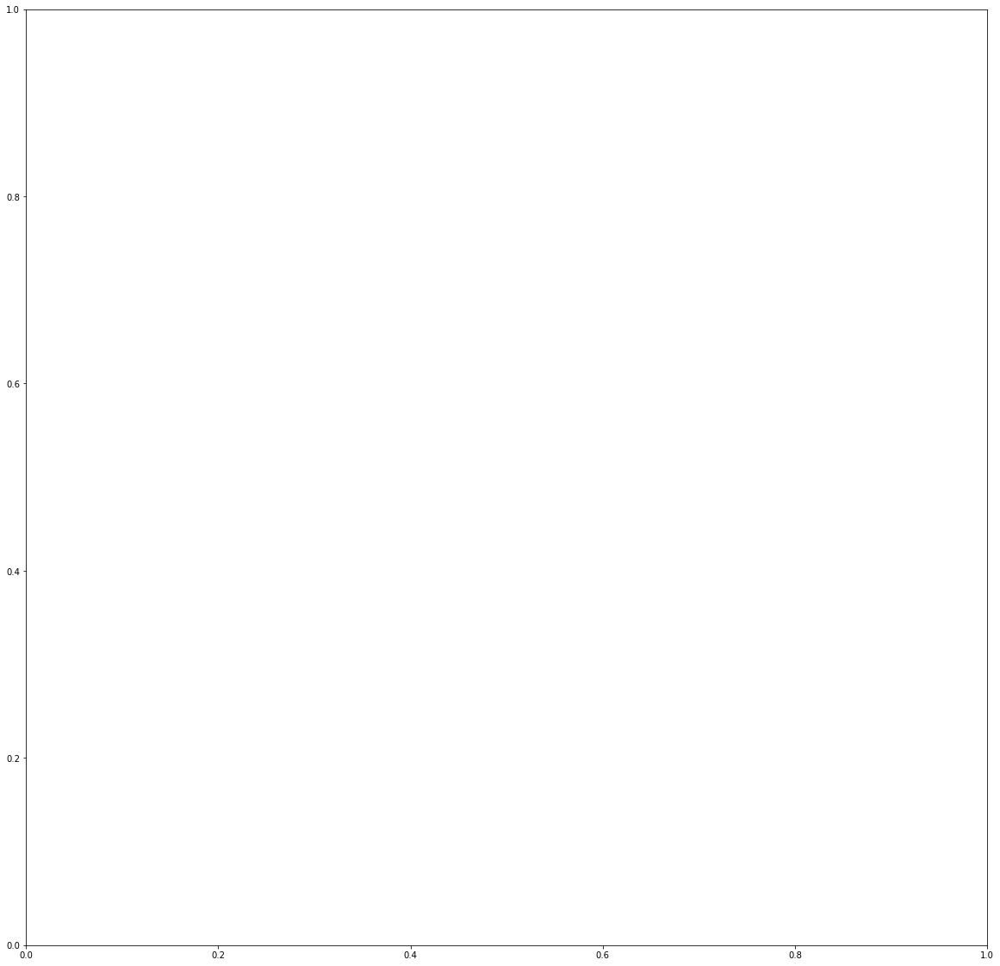

In [25]:

f, ax = plt.subplots(figsize=(20, 20))

input_matrix = counts.rename(columns=anotation['10-Region'])
corrmatrix = input_matrix.corr(method='spearman', min_periods=10)
#corrmatrix = np.corrcoef(input_matrix)
seaborn.heatmap(corrmatrix)
plt.show()



/opt/anaconda3/lib/python3.6/site-packages/seaborn/matrix.py:624: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


ValueError: The condensed distance matrix must contain only finite values.

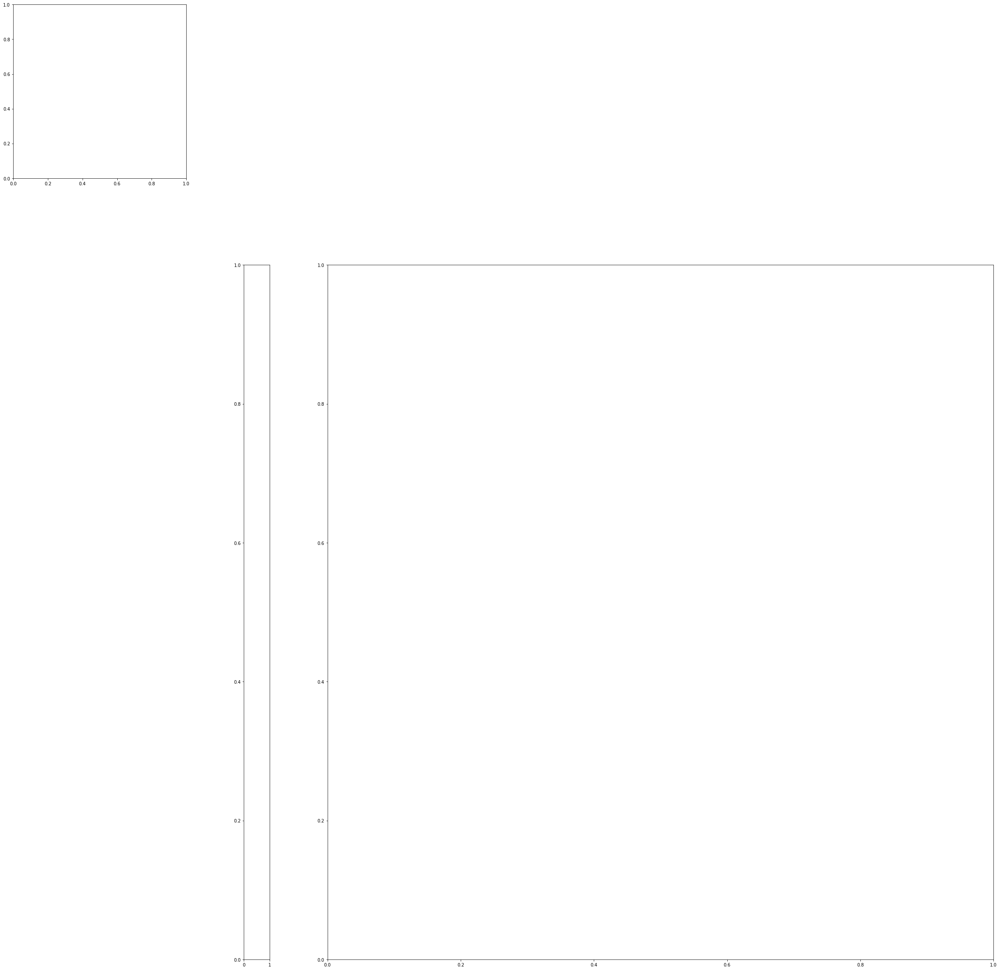

In [15]:
import seaborn as sns#; sns.set_theme(color_codes=True)
lut = dict(zip(corrmatrix.columns.unique(), "rbgymck"))
lut

row_colors = corrmatrix.columns.map(lut)
seaborn.clustermap(corrmatrix, method='complete',row_colors=row_colors, row_cluster=True, figsize=(40,40))

In [ ]:
row_colors


In [18]:
corrmatrix.columns

Index(['SouthAsia', 'EastAsia', 'WestEurasia', 'EastAsia', 'EastAsia',
       'EastAsia', 'SouthAsia', 'America', 'America', 'EastAsia',
       ...
       'Africa', 'CentralAsiaSiberia', 'America', 'Africa', 'WestEurasia',
       'America', 'EastAsia', 'Oceania', 'SouthAsia', 'SouthAsia'],
      dtype='object', name='SAMPLE', length=229)

<h1> Freq by regions

In [19]:
freq = qdnaseq_pvt.iloc[:,3:283]
freq_input = freq.rename(columns=anotation['10-Region'])
df = freq_input.T
#df = df.reset_index()

#df.groupby('SAMPLE').count().div(df.groupby('SAMPLE').size(),0)


df = df.notnull().groupby(level=0).mean()

df = df.T

df

SAMPLE,Africa,America,CentralAsiaSiberia,EastAsia,Oceania,SouthAsia,WestEurasia
0,0.000000,0.00,0.037037,0.03125,0.000000,0.000000,0.000000
1,0.027778,0.00,0.000000,0.00000,0.000000,0.000000,0.000000
2,0.000000,0.00,0.037037,0.00000,0.000000,0.000000,0.000000
3,0.000000,0.00,0.000000,0.00000,0.047619,0.000000,0.000000
4,0.000000,0.00,0.000000,0.03125,0.000000,0.096774,0.032258
...,...,...,...,...,...,...,...
1495,0.027778,0.00,0.037037,0.09375,0.190476,0.064516,0.048387
1496,0.000000,0.00,0.037037,0.00000,0.000000,0.000000,0.000000
1497,0.055556,0.00,0.000000,0.06250,0.238095,0.064516,0.064516
1498,0.000000,0.00,0.000000,0.00000,0.047619,0.000000,0.000000


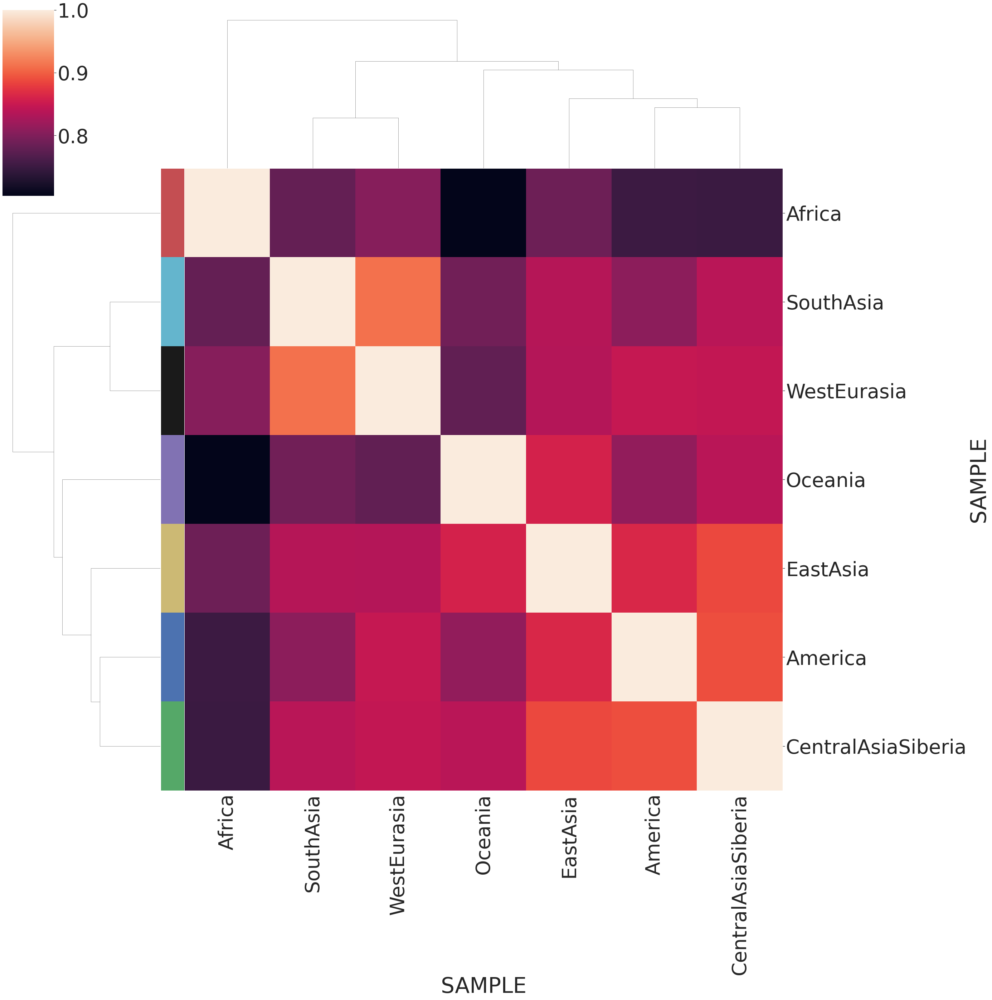

In [20]:
lut = dict(zip(df.columns.unique(), "rbgymck"))
lut

seaborn.set(font_scale=5)
corrmatrix = df.corr(method='pearson')
row_colors = df.columns.map(lut)
seaborn.clustermap(corrmatrix, row_colors=row_colors, row_cluster=True, figsize=(40,40))

In [32]:
row_colors

lut

{'Abkhazia': 'r',
 'Algeria': 'b',
 'Argentina': 'g',
 'Armenia': 'y',
 'Australia': 'm',
 'Bangladesh': 'c',
 'BotswanaOrNamibia': 'k'}

<h1> Freq by countries

In [33]:
freq = qdnaseq_pvt.iloc[:,3:283]
freq_input = freq.rename(columns=anotation['11-Country'])
df = freq_input.T
#df = df.reset_index()

#df.groupby('SAMPLE').count().div(df.groupby('SAMPLE').size(),0)


df = df.notnull().groupby(level=0).mean()

df



,0,1,2,3,4,5,6,7,8,9,...,1490,1491,1492,1493,1494,1495,1496,1497,1498,1499
SAMPLE,,,,,,,,,,,,,,,,,,,,,
Abkhazia,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
Algeria,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Argentina,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Armenia,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.5,0.5,0.0,0.0,0.5,0.0,0.5,0.0,0.0
Australia,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Turkey,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
USA,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Vietnam,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [34]:
#anotation_freq = anotation.set_index('11-Country')
anotation_freq = anotation.loc[:,["10-Region", "11-Country"]]
#


#anotation_freq = anotation_freq.merge(df,how='right',left_index=True, right_index=True)



anotation_freq = np.array(anotation_freq)


input_freq = df.reset_index()
input_freq = np.array(input_freq)


ls = []
for i in input_freq:
    for region in anotation_freq:
        if i[0] == region[1]:
            ls.append([i[0], region[0]])
            
         #   print([i[0], region[0]])
#lut = dict(zip(anotation_freq['10-Region'].unique(), "rbgymck"))
#lut

ds = pd.DataFrame(ls)
ds = ds.drop_duplicates()

ds


,0,1
0,Abkhazia,WestEurasia
1,Algeria,Africa
3,Argentina,America
4,Armenia,WestEurasia
6,Australia,Oceania
...,...,...
265,Turkey,WestEurasia
267,USA,Oceania
268,Vietnam,EastAsia
270,Western Sahara (Morocco),Africa


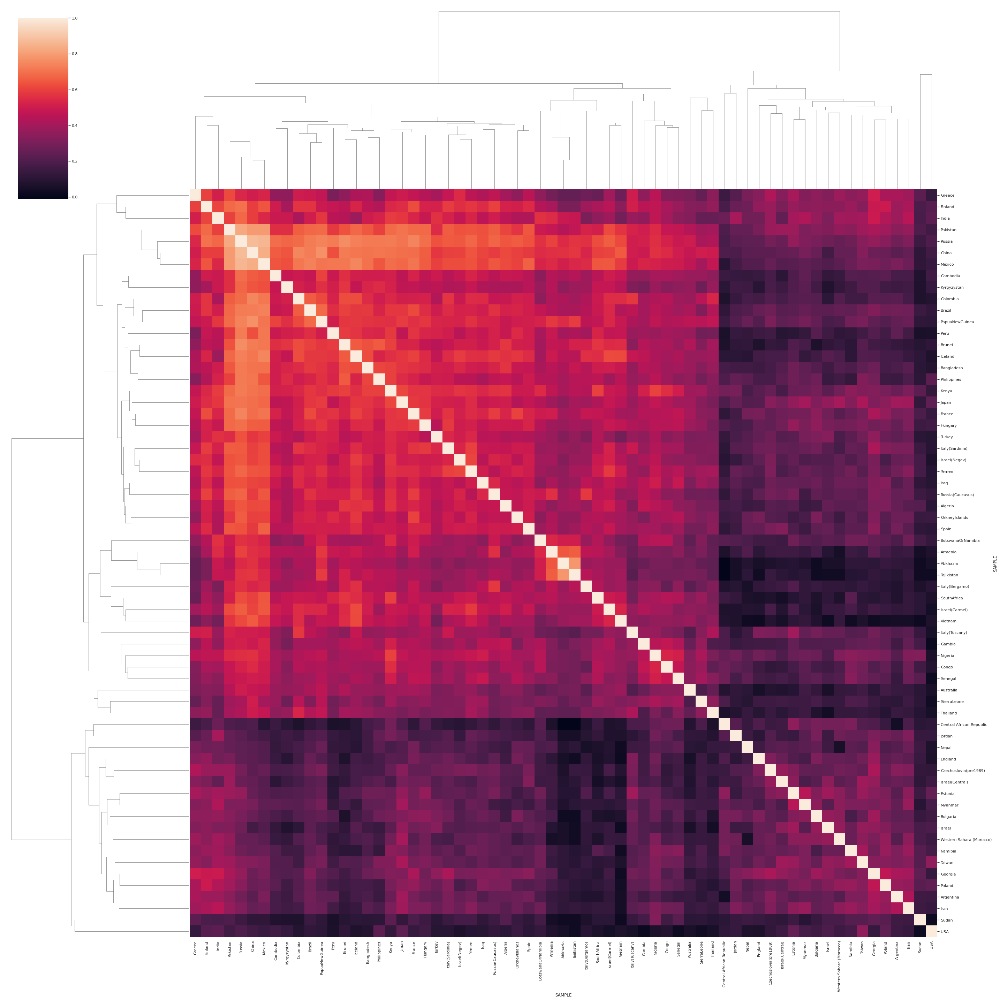

In [35]:
seaborn.set(font_scale=1)
corrmatrix = df.T.corr(method='pearson')
seaborn.clustermap(corrmatrix, figsize=(40,40))#, row_colors=row_colors, row_cluster=True, figsize=(40,40))


#row_colors = anotation_freq['10-Region'].map(lut)
#row_colors 
#seaborn.clustermap(corrmatrix, row_colors=row_colors, row_cluster=True, figsize=(40,40))

<h1> PCA

In [16]:
#track features for pca & tsne
count = counts.T
features = anotation.merge(count, left_index=True, right_index=True)
features = features.loc[:,["7-Gender","10-Region", "11-Country"]]
features

#imputation and normalization 
#imp = SimpleImputer(missing_values=np.nan, strategy='median')
#X = fit_transform(counts.T)
X = StandardScaler().fit_transform(counts.T)


#PCA
#pca = PCA(.95)
pca = PCA(n_components=10)
pca_results = pca.fit_transform(X)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3','component_4','component_5', 'component_6', 'component_7','component_8', 'component_9','component_10'],
                          index=features.index)




df_pca = features.merge(df_pca, left_index=True, right_index=True)
df_pca 

ValueError: n_components=10 must be between 0 and min(n_samples, n_features)=4 with svd_solver='full'

In [71]:
pca.explained_variance_ratio_

array([0.33645782, 0.25862761, 0.07542736, 0.04688273, 0.0229361 ,
       0.01867063, 0.01502003, 0.01272818, 0.01175016, 0.00943718])

In [72]:
df_pca_outlier = df_pca[df_pca['component_1'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_2'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_3'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_4'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_5'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_6'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_7'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_8'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_9'] < 20]
df_pca_outlier = df_pca_outlier[df_pca_outlier['component_10'] < 20]


outliers = pd.concat([df_pca,df_pca_outlier]).drop_duplicates(keep=False)

outlier_samples = list(outliers.index)
outlier_samples


['SAMEA3302707',
 'SAMEA3302875',
 'SAMEA3302745',
 'SAMEA3302758',
 'SAMEA3302747',
 'SAMEA3302814',
 'SAMEA3302734',
 'SAMEA3302755',
 'SAMEA3302854',
 'SAMEA3302882']

            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

<ipython-input-30-633177199b43>:46: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

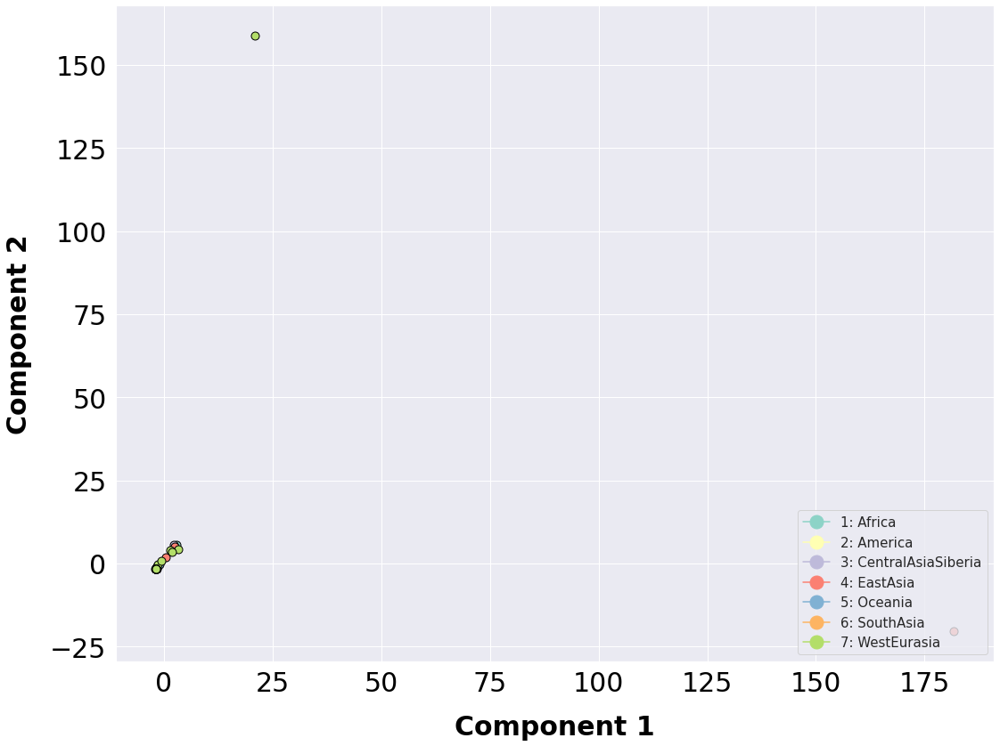

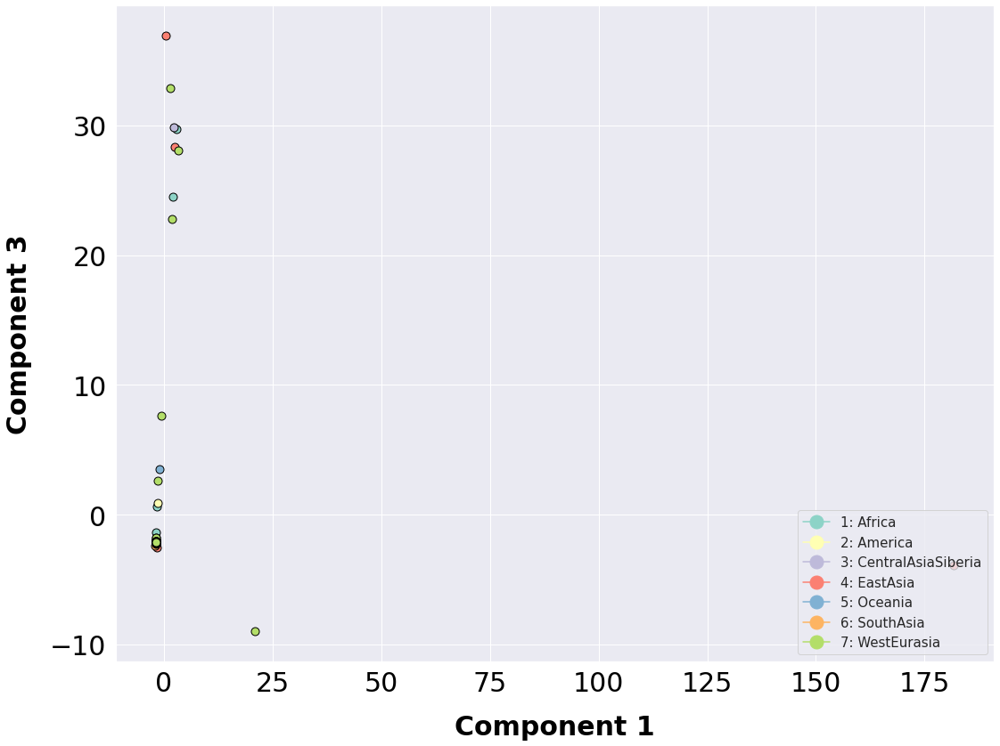

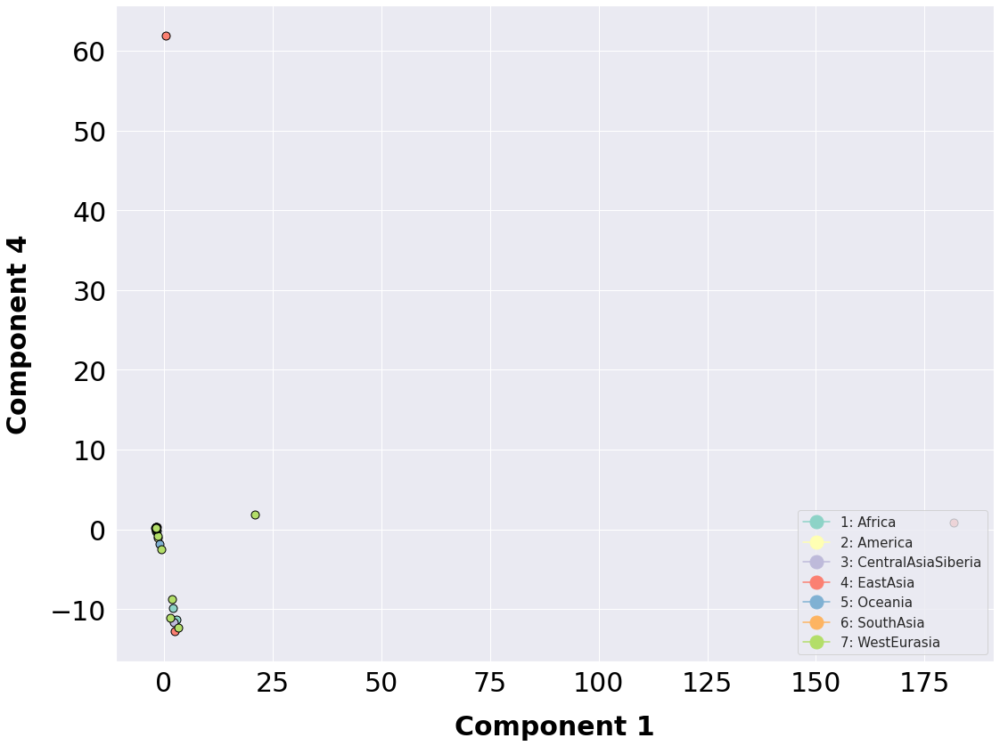

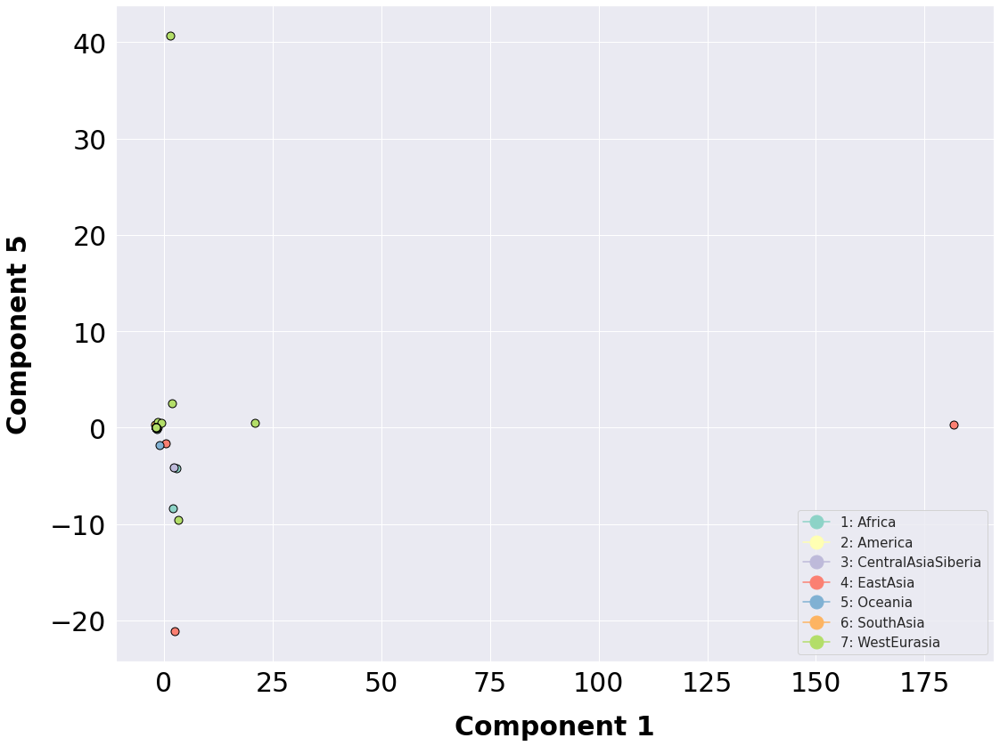

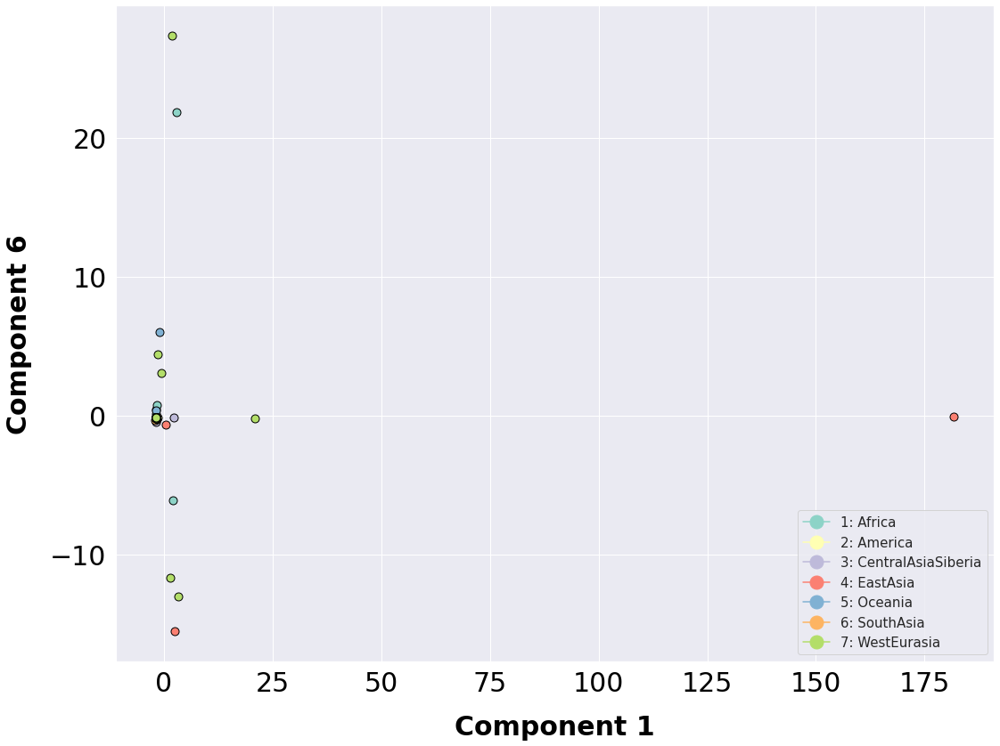

...

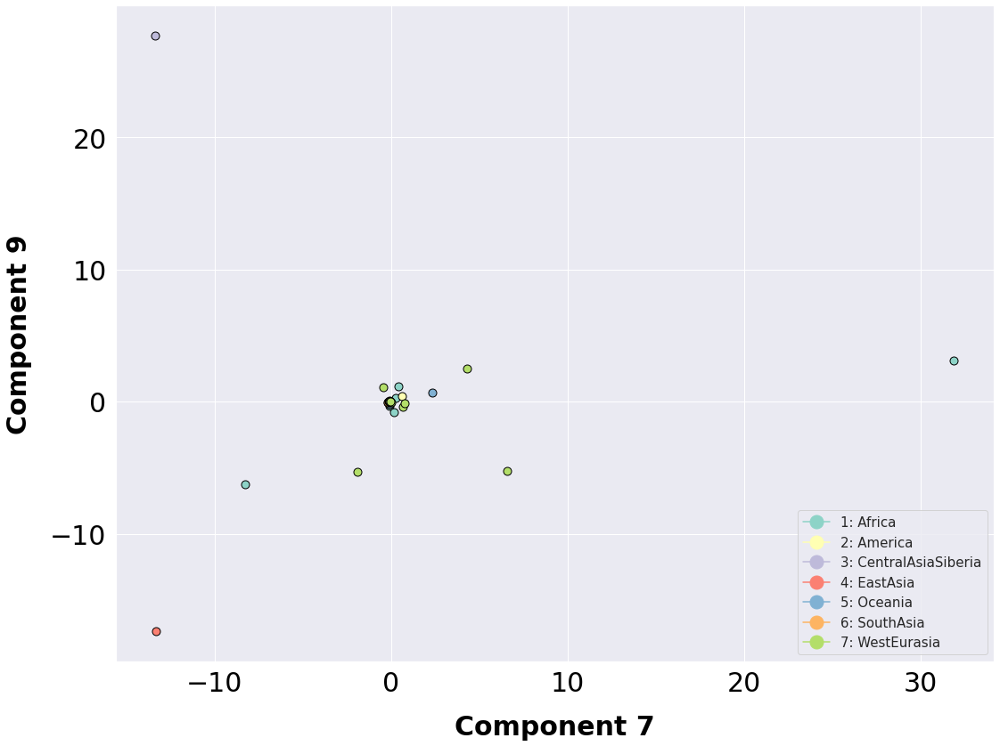

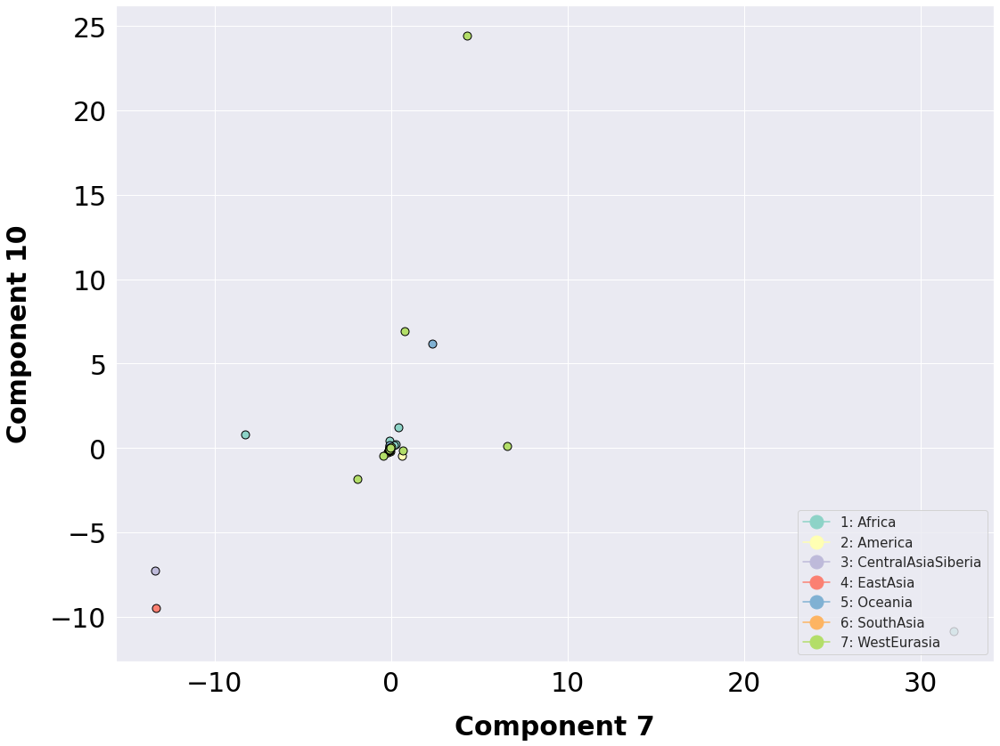

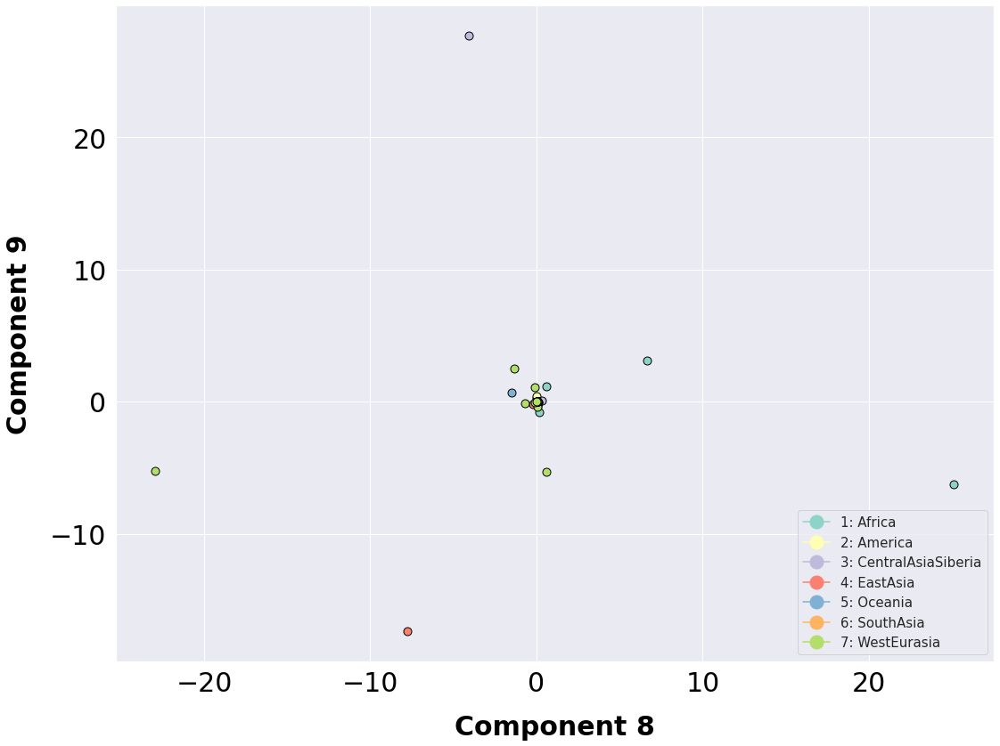

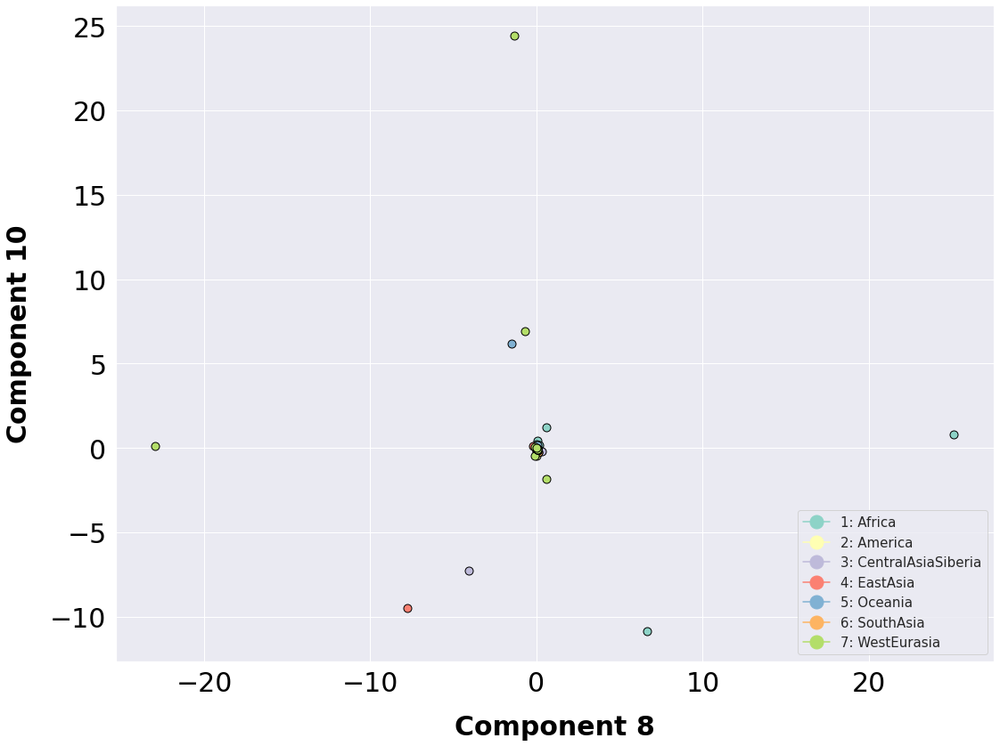

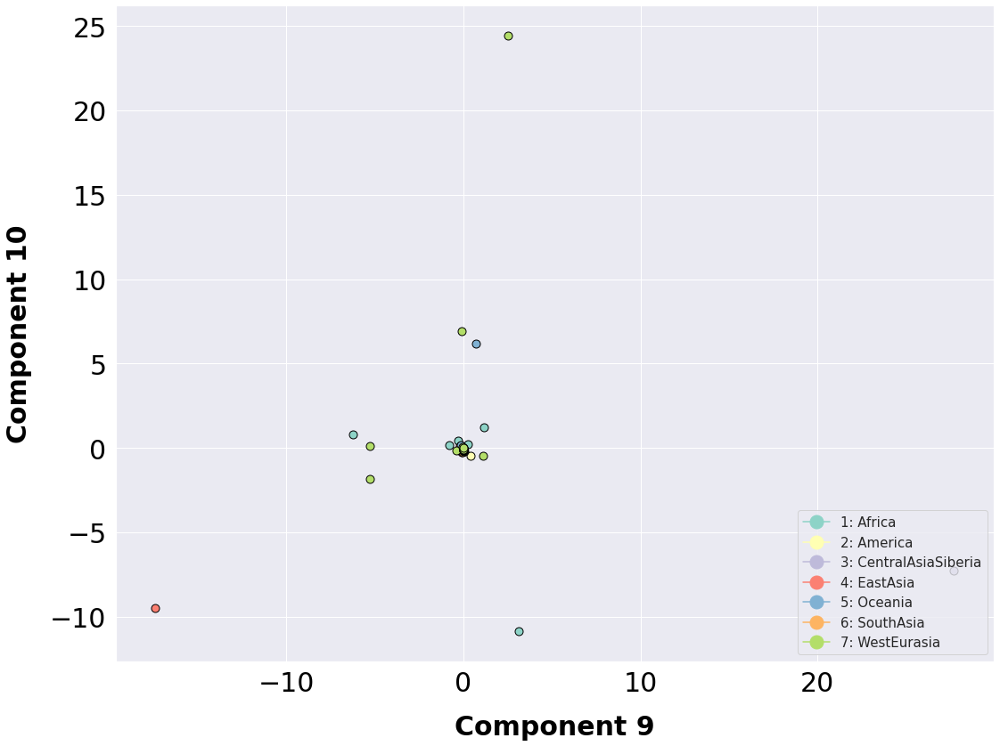

In [73]:

components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='Component '+ str(i[0]), label_vertical='Component '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

<ipython-input-30-633177199b43>:46: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

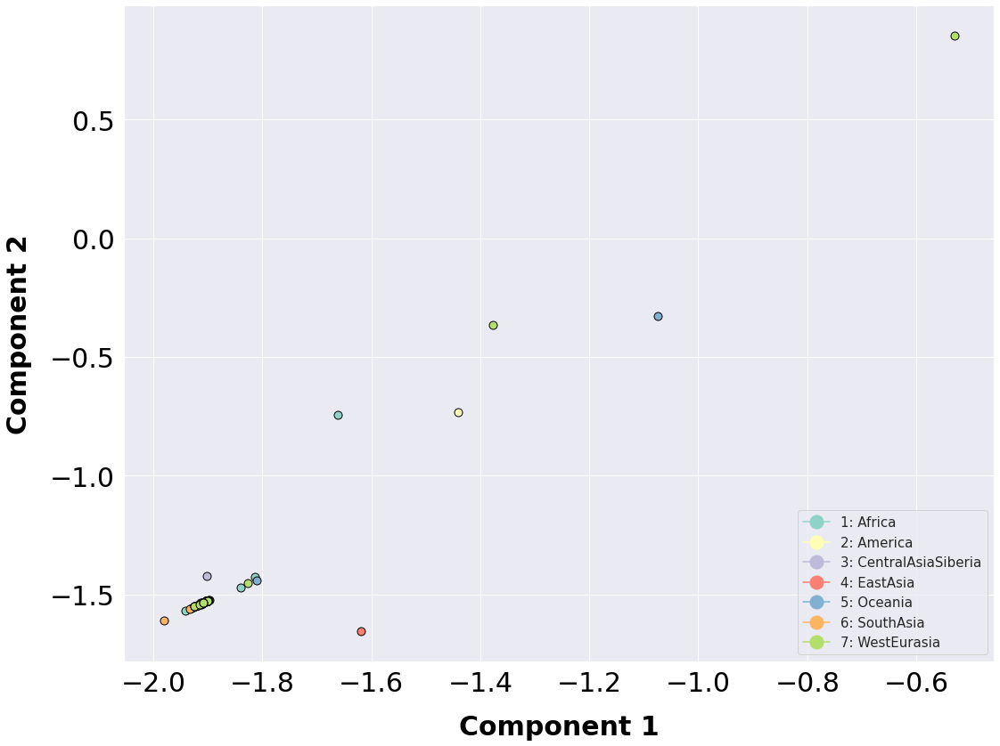

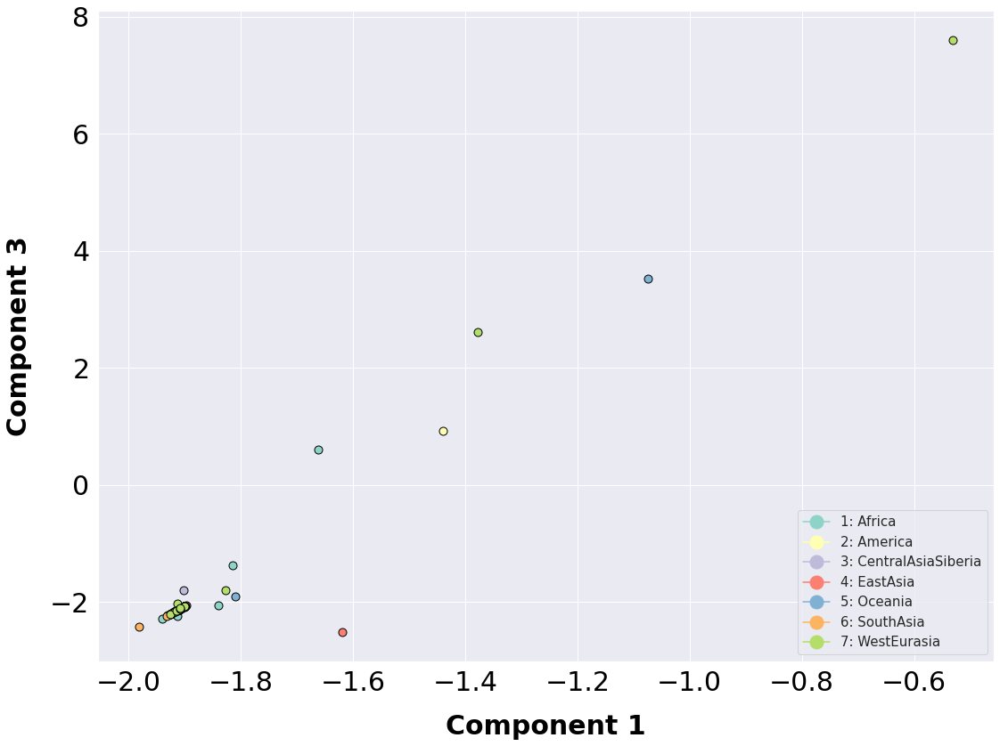

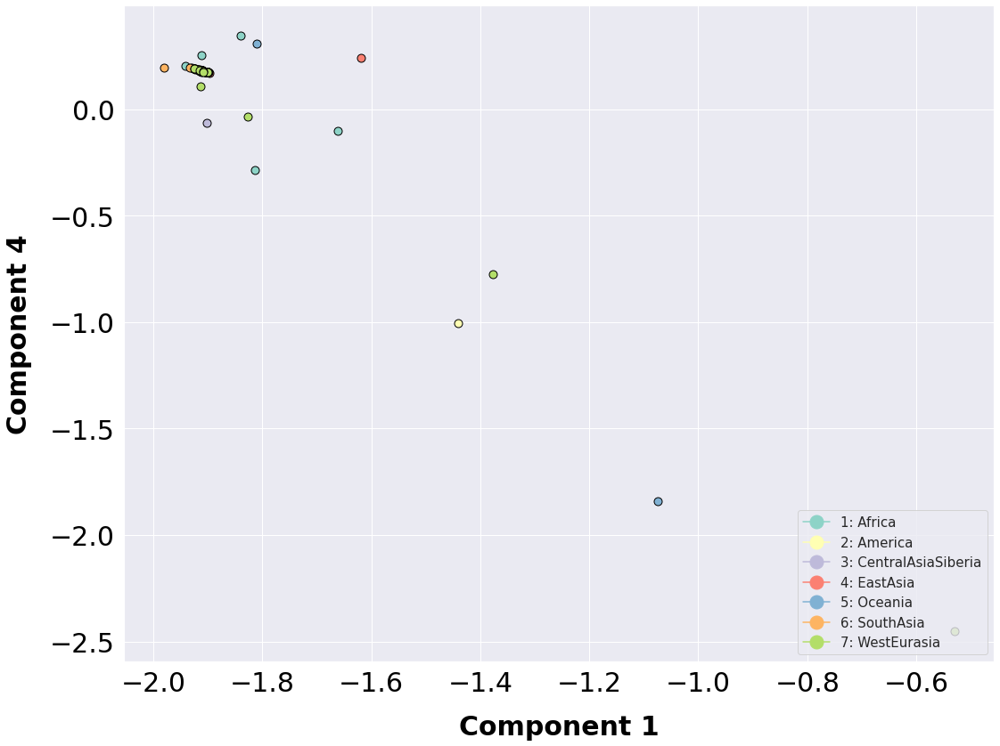

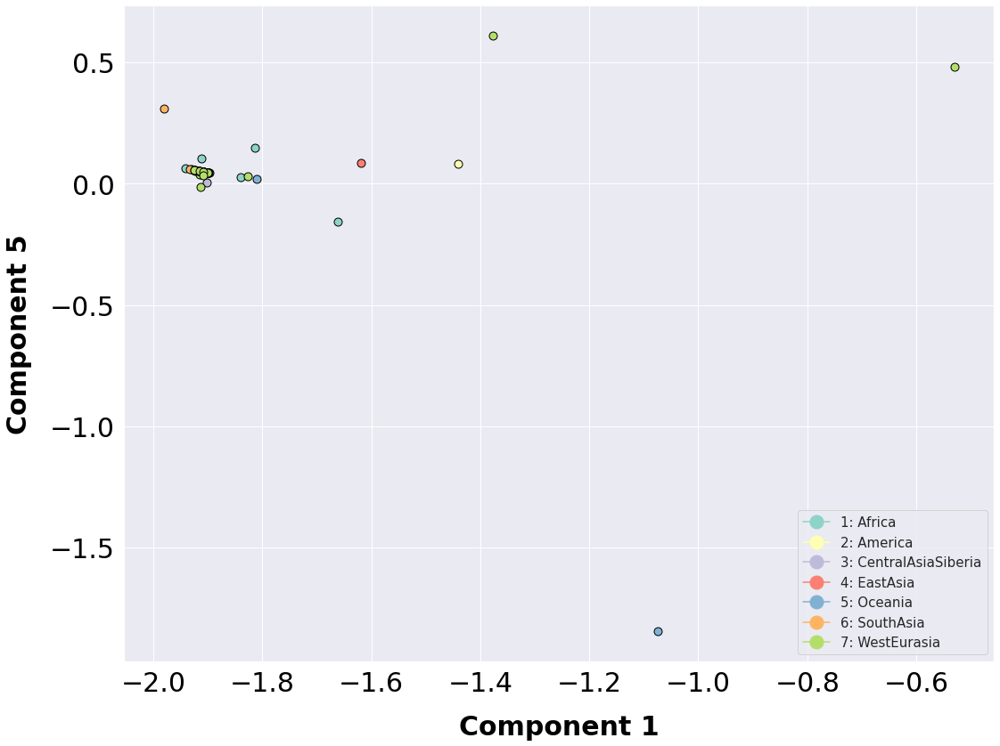

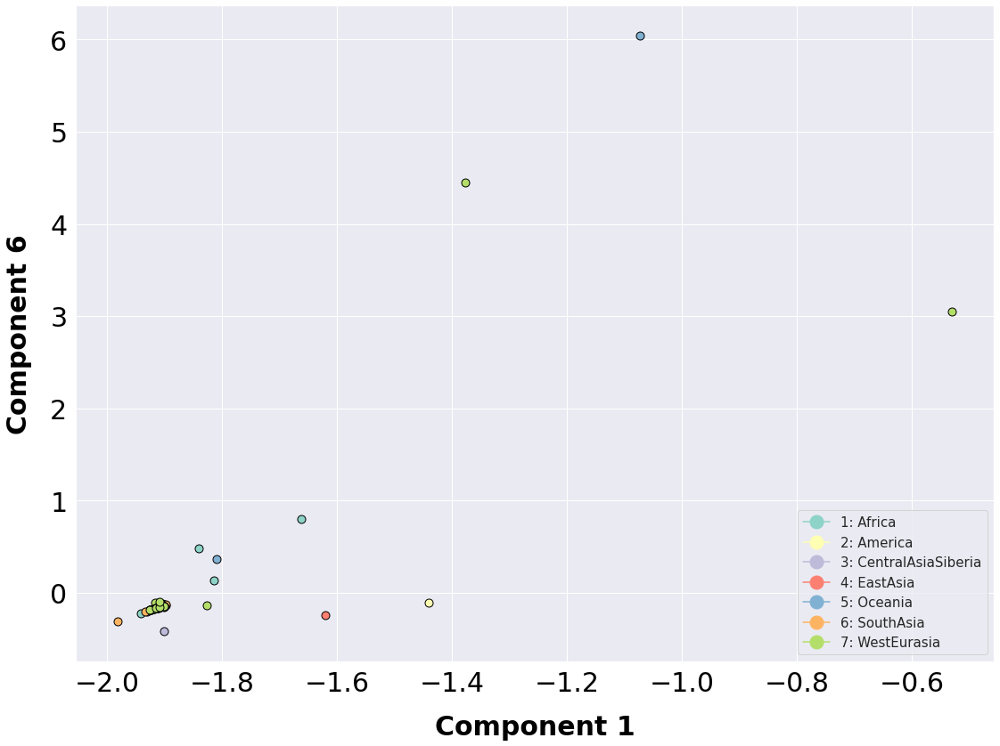

...

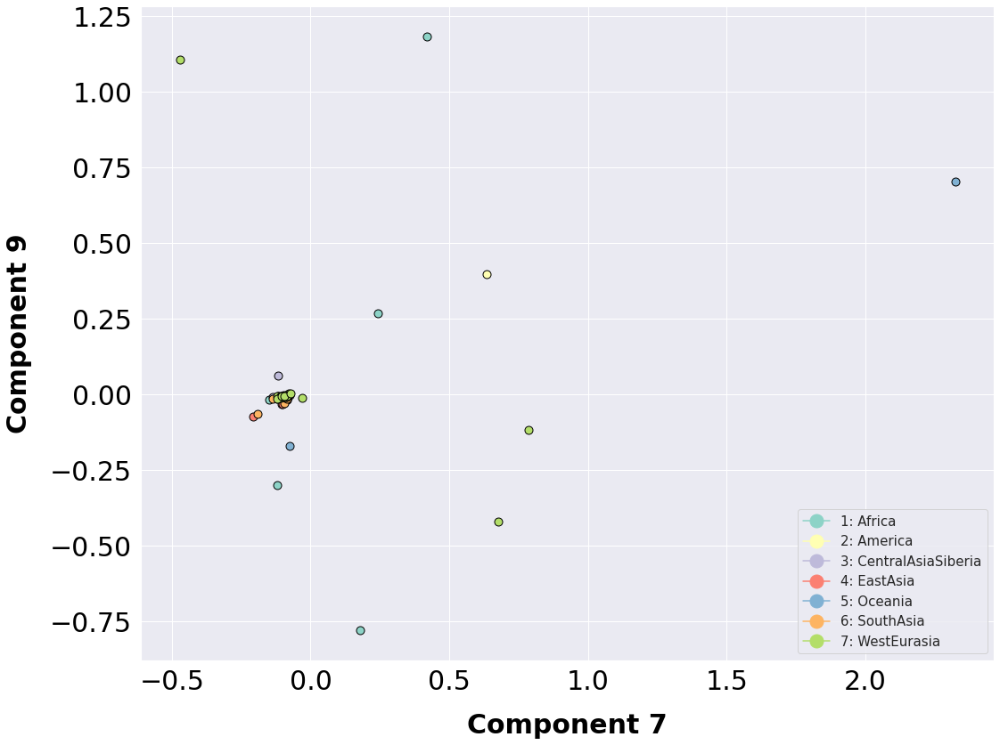

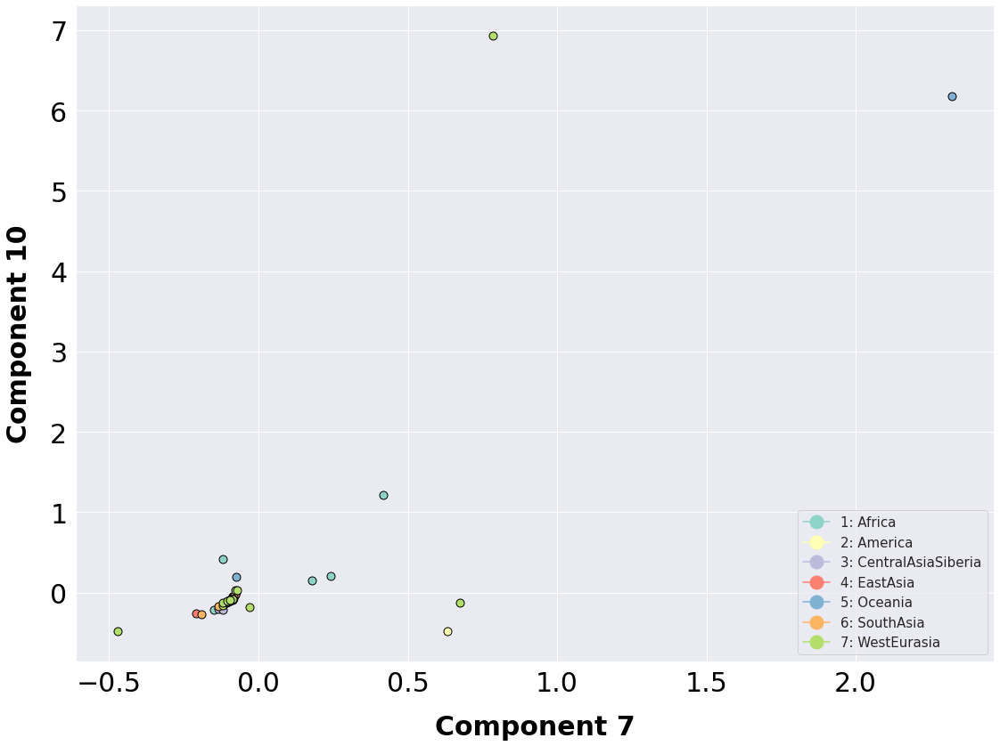

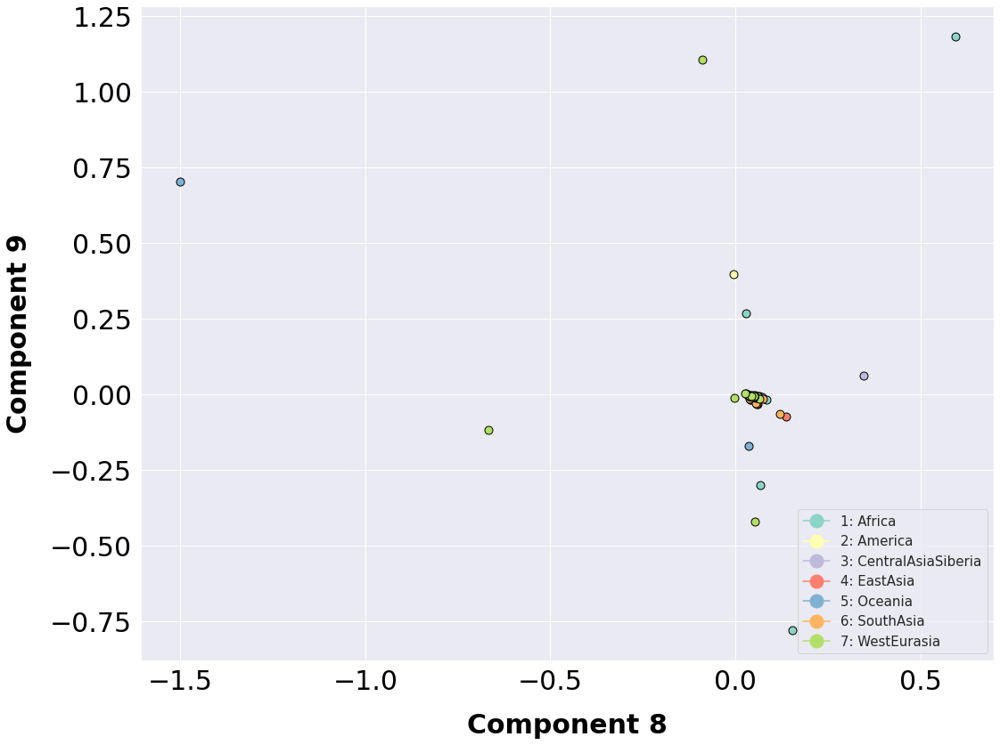

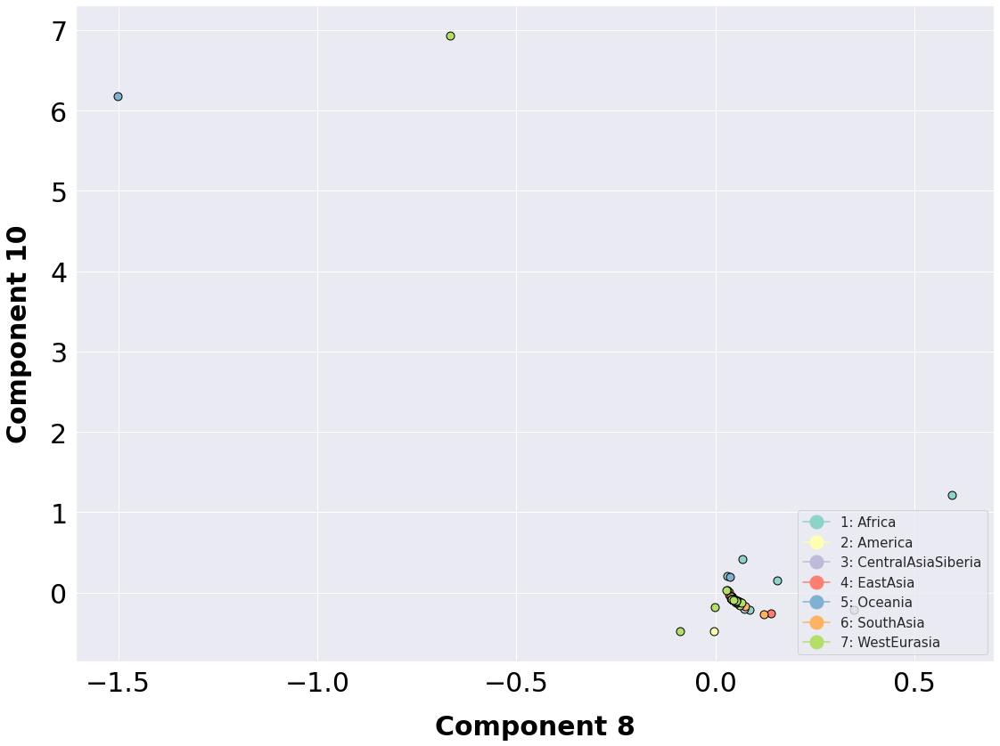

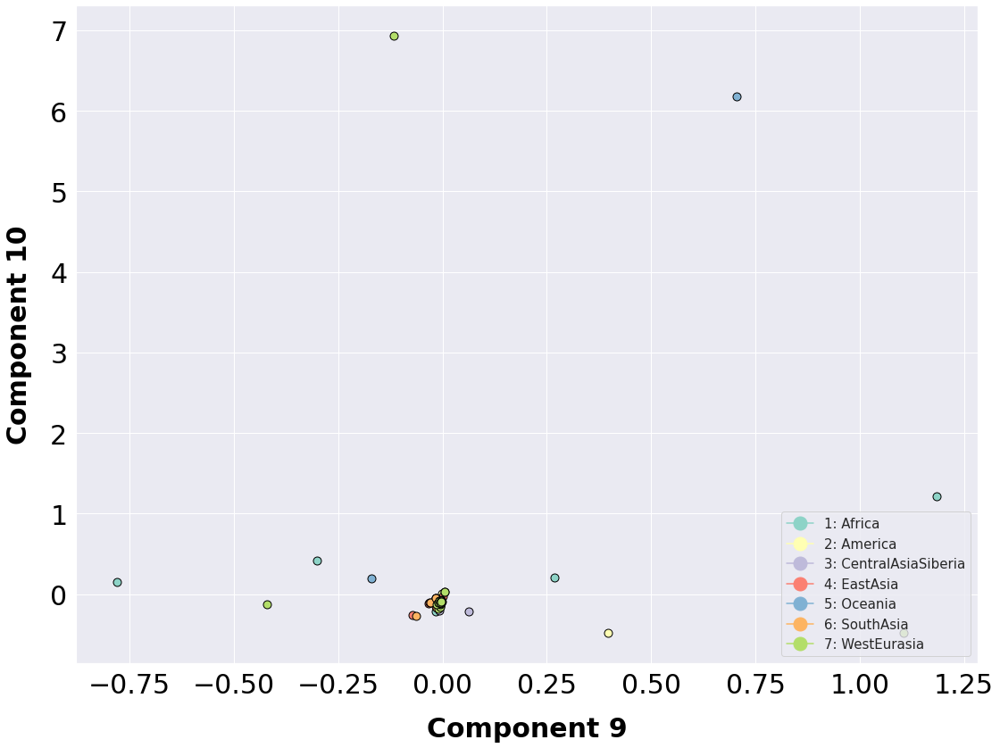

In [74]:


components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca_outlier, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='Component '+ str(i[0]), label_vertical='Component '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

                   7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                       
SouthAsia                 F   Pakistan    -1.907587    -1.532861    -2.111326   
SouthAsia                 M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia                 M   Pakistan    -1.908277    -1.533593    -2.115352   
CentralAsiaSiberia        M      China    -1.900420    -1.525360    -2.075469   
EastAsia                  M      China    -1.911094    -1.536591    -2.129893   
...                     ...        ...          ...          ...          ...   
Oceania                   M        USA    -1.925036    -1.551220    -2.201782   
America                   F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia                  M      China    -1.897135    -1.521939    -2.060005   
America                   M     Brazil    -1.900362    -1.525300    -2.075184   
America                   F 

                   7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                       
SouthAsia                 F   Pakistan    -1.907587    -1.532861    -2.111326   
SouthAsia                 M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia                 M   Pakistan    -1.908277    -1.533593    -2.115352   
CentralAsiaSiberia        M      China    -1.900420    -1.525360    -2.075469   
EastAsia                  M      China    -1.911094    -1.536591    -2.129893   
...                     ...        ...          ...          ...          ...   
Oceania                   M        USA    -1.925036    -1.551220    -2.201782   
America                   F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia                  M      China    -1.897135    -1.521939    -2.060005   
America                   M     Brazil    -1.900362    -1.525300    -2.075184   
America                   F 

                   7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                       
SouthAsia                 F   Pakistan    -1.907587    -1.532861    -2.111326   
SouthAsia                 M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia                 M   Pakistan    -1.908277    -1.533593    -2.115352   
CentralAsiaSiberia        M      China    -1.900420    -1.525360    -2.075469   
EastAsia                  M      China    -1.911094    -1.536591    -2.129893   
...                     ...        ...          ...          ...          ...   
Oceania                   M        USA    -1.925036    -1.551220    -2.201782   
America                   F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia                  M      China    -1.897135    -1.521939    -2.060005   
America                   M     Brazil    -1.900362    -1.525300    -2.075184   
America                   F 

<ipython-input-30-633177199b43>:46: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


                   7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                       
SouthAsia                 F   Pakistan    -1.907587    -1.532861    -2.111326   
SouthAsia                 M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia                 M   Pakistan    -1.908277    -1.533593    -2.115352   
CentralAsiaSiberia        M      China    -1.900420    -1.525360    -2.075469   
EastAsia                  M      China    -1.911094    -1.536591    -2.129893   
...                     ...        ...          ...          ...          ...   
Oceania                   M        USA    -1.925036    -1.551220    -2.201782   
America                   F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia                  M      China    -1.897135    -1.521939    -2.060005   
America                   M     Brazil    -1.900362    -1.525300    -2.075184   
America                   F 

                   7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                       
SouthAsia                 F   Pakistan    -1.907587    -1.532861    -2.111326   
SouthAsia                 M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia                 M   Pakistan    -1.908277    -1.533593    -2.115352   
CentralAsiaSiberia        M      China    -1.900420    -1.525360    -2.075469   
EastAsia                  M      China    -1.911094    -1.536591    -2.129893   
...                     ...        ...          ...          ...          ...   
Oceania                   M        USA    -1.925036    -1.551220    -2.201782   
America                   F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia                  M      China    -1.897135    -1.521939    -2.060005   
America                   M     Brazil    -1.900362    -1.525300    -2.075184   
America                   F 

                   7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                       
SouthAsia                 F   Pakistan    -1.907587    -1.532861    -2.111326   
SouthAsia                 M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia                 M   Pakistan    -1.908277    -1.533593    -2.115352   
CentralAsiaSiberia        M      China    -1.900420    -1.525360    -2.075469   
EastAsia                  M      China    -1.911094    -1.536591    -2.129893   
...                     ...        ...          ...          ...          ...   
Oceania                   M        USA    -1.925036    -1.551220    -2.201782   
America                   F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia                  M      China    -1.897135    -1.521939    -2.060005   
America                   M     Brazil    -1.900362    -1.525300    -2.075184   
America                   F 

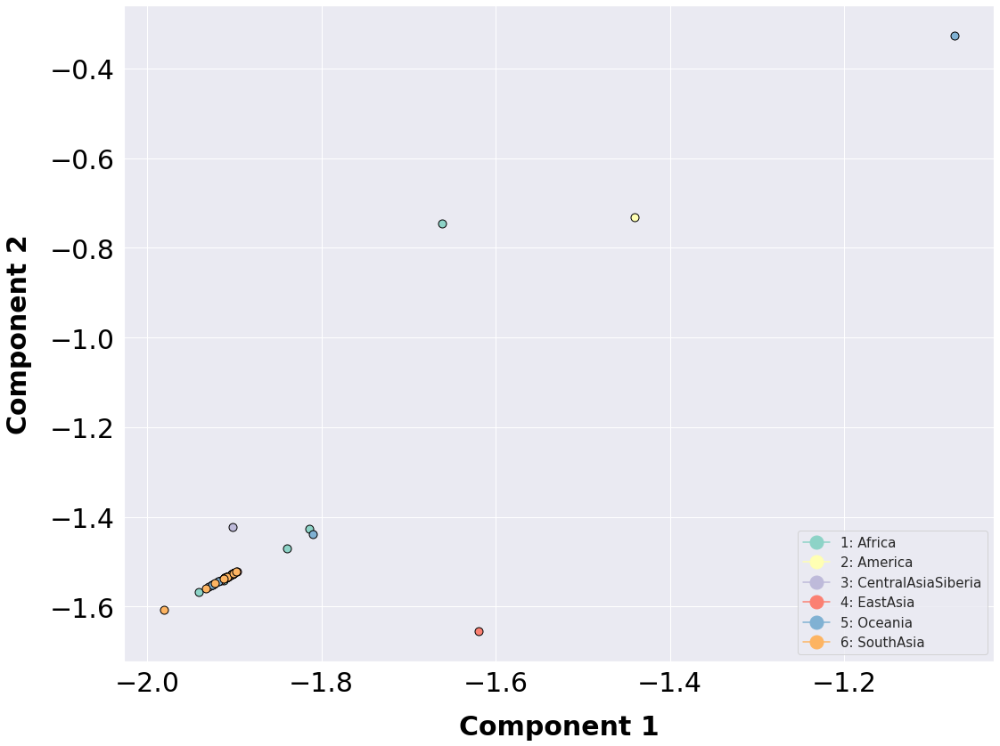

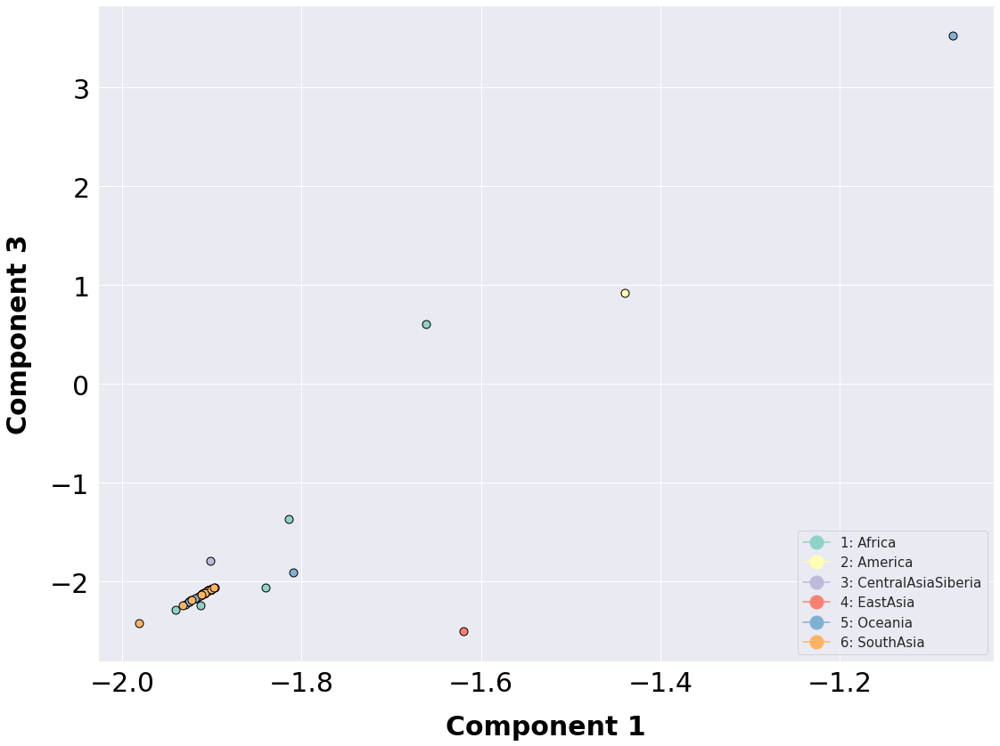

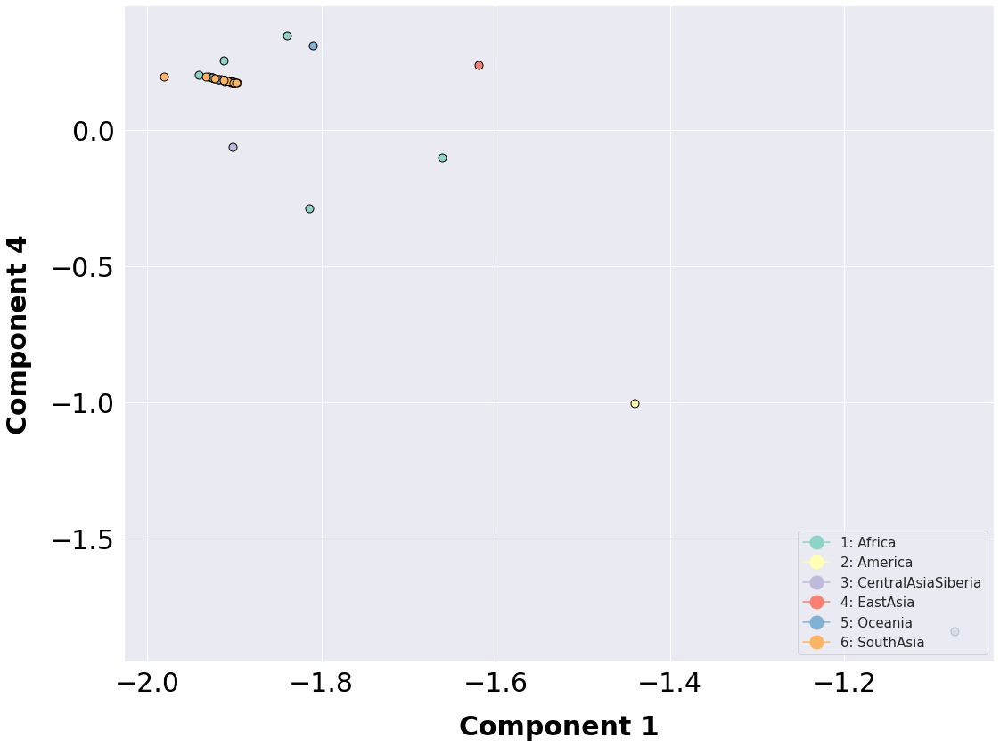

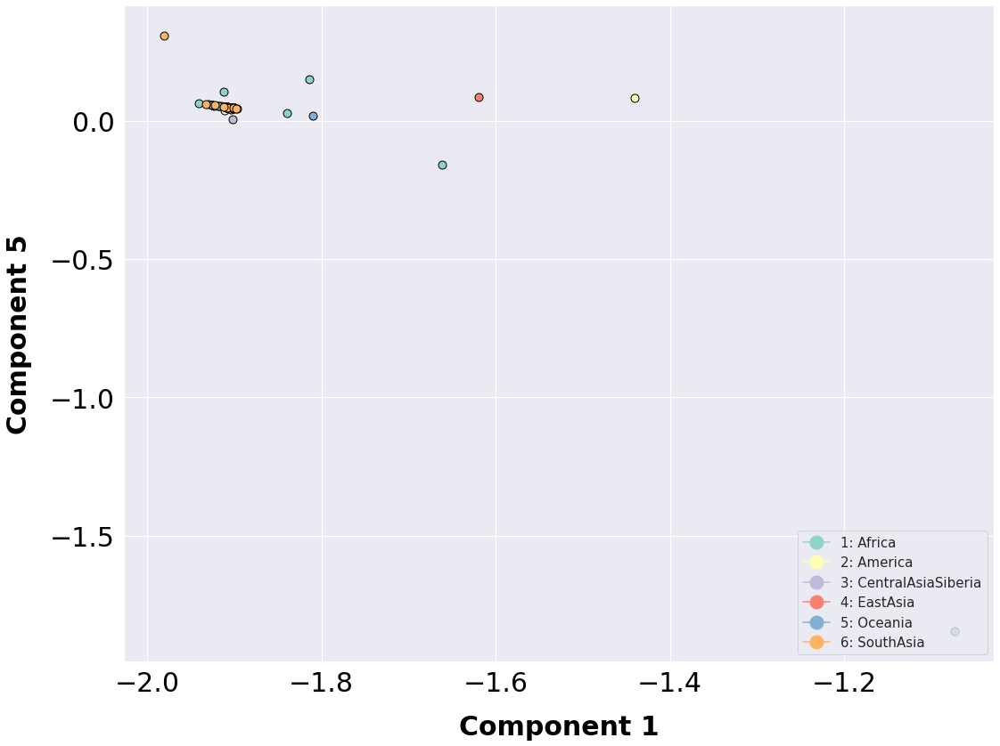

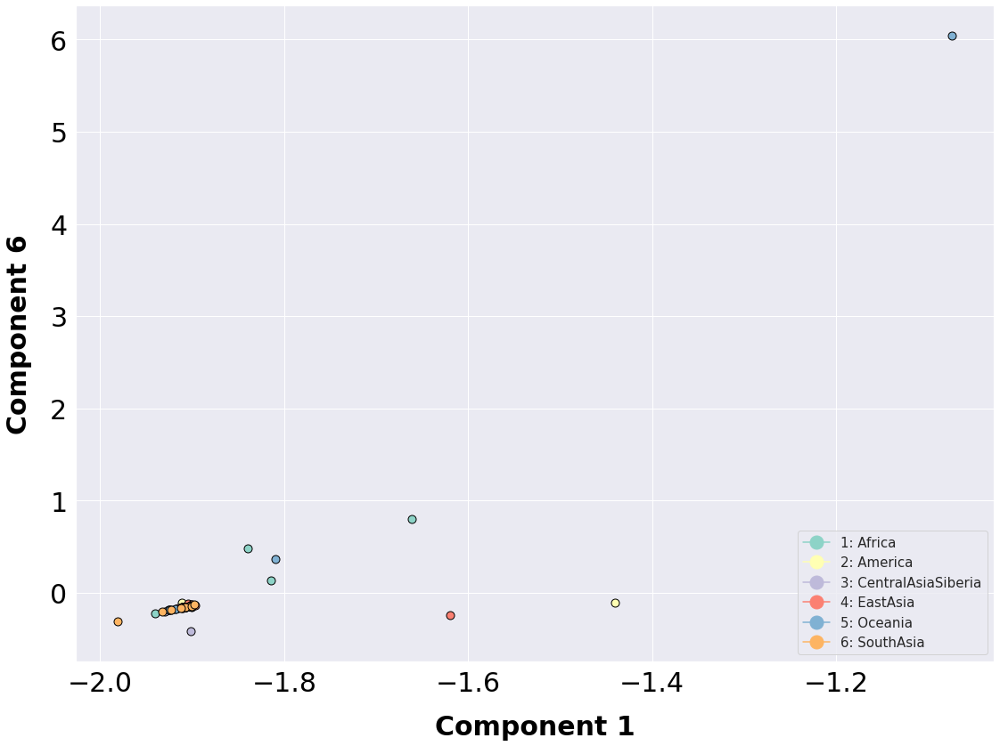

...

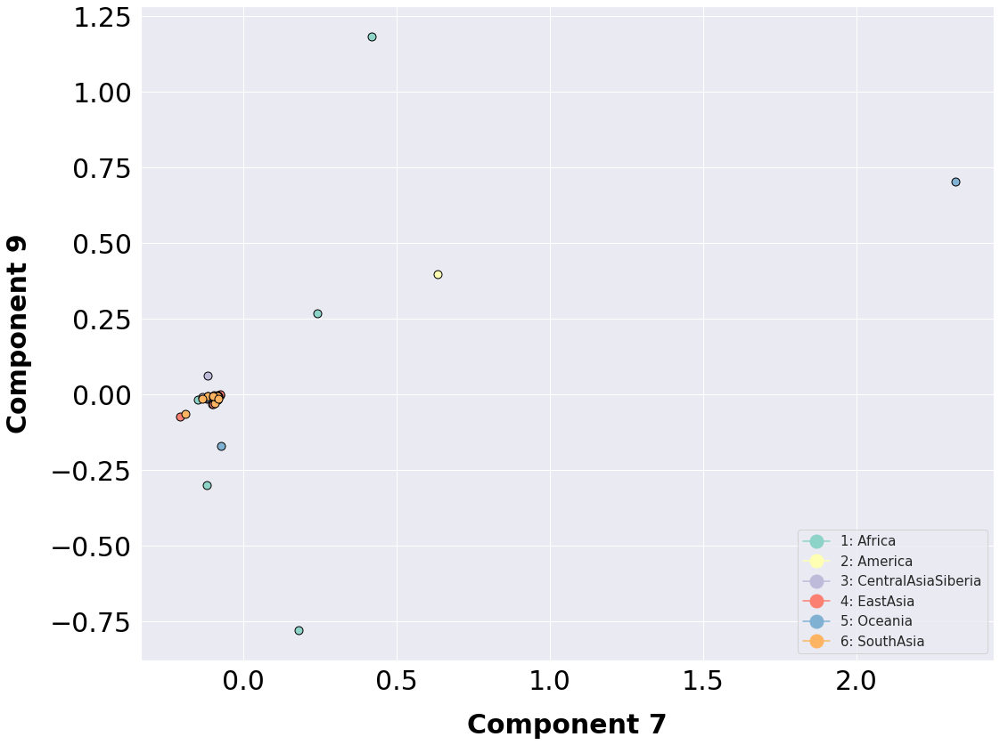

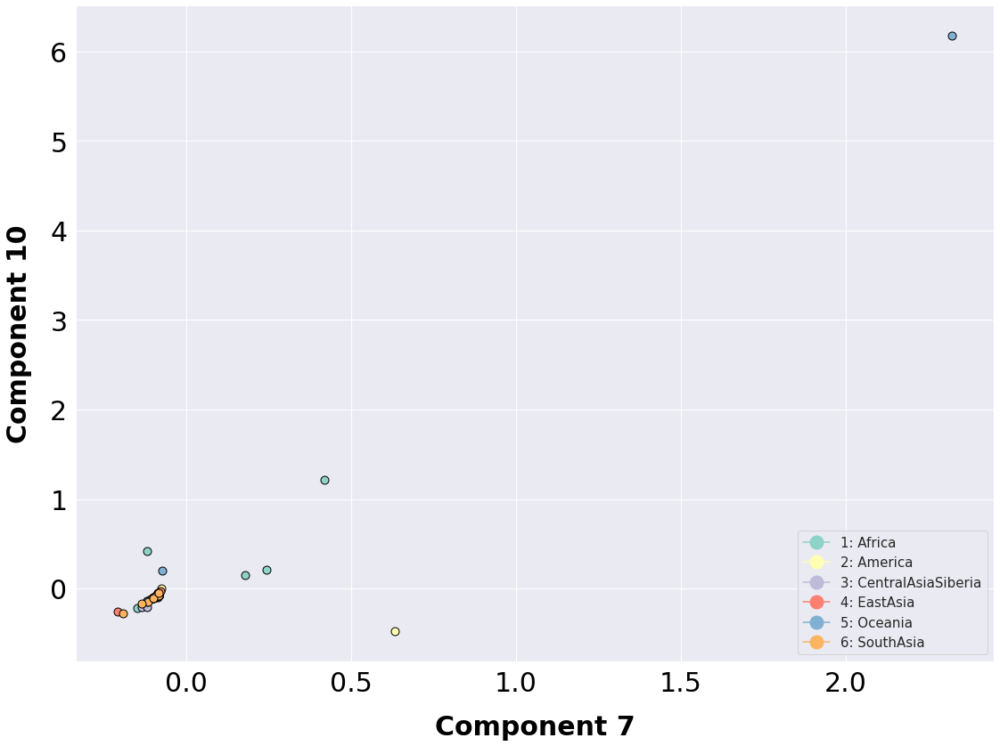

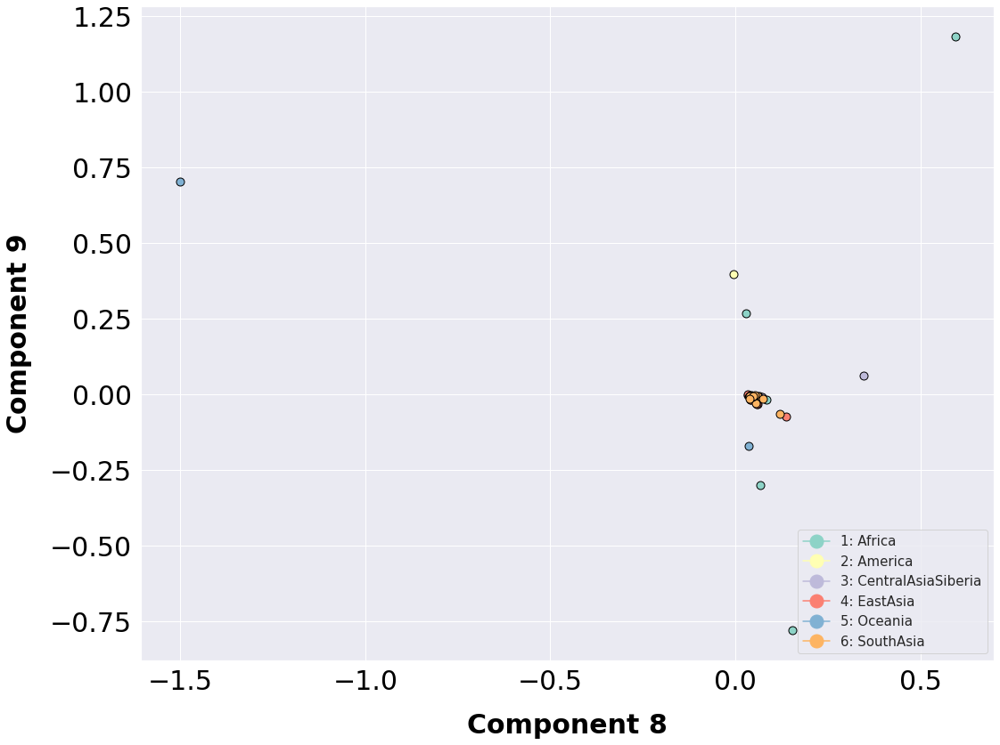

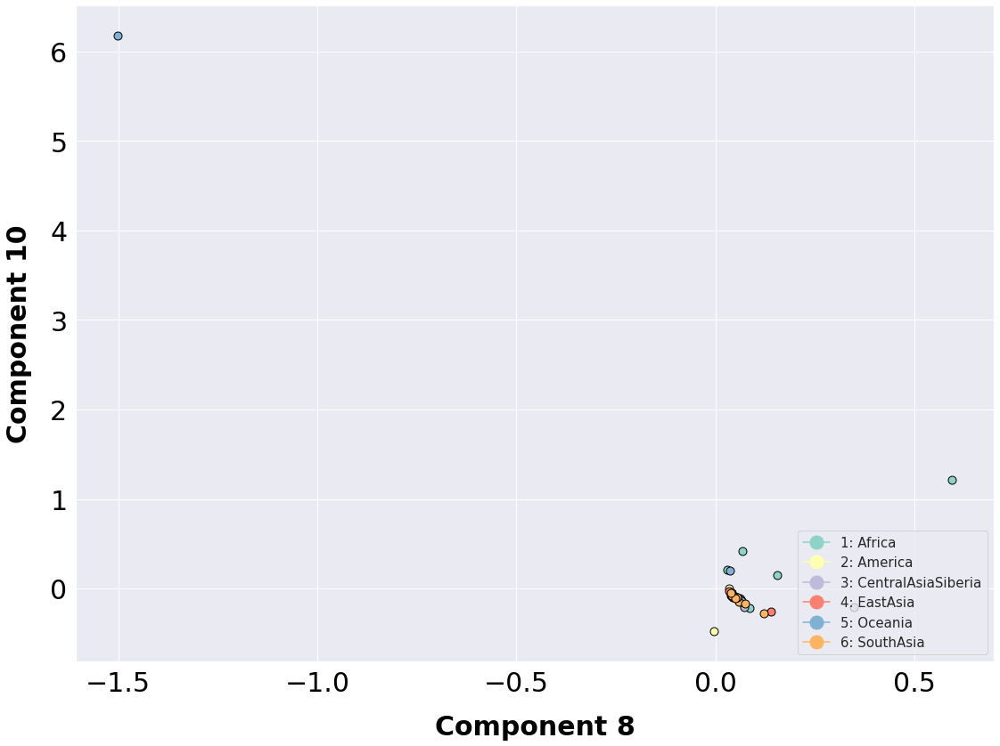

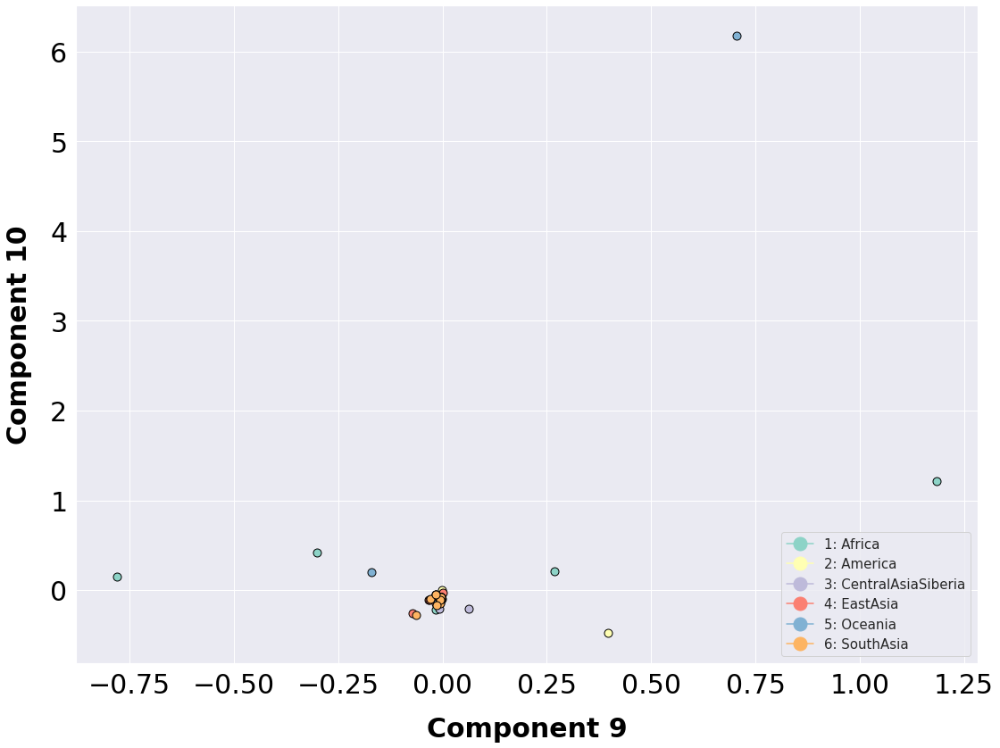

In [75]:
df_pca_outlier_no_europ = df_pca_outlier[df_pca_outlier['10-Region'] != 'WestEurasia']


components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca_outlier_no_europ, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='Component '+ str(i[0]), label_vertical='Component '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

In [42]:
#TSNE 
tsne = TSNE(n_components=3)
tsne_results = tsne.fit_transform(X)

df_tsne= pd.DataFrame(tsne_results,
                          columns=['component_1','component_2', 'component_3'],
                          index=features.index)



df_tsne = features.merge(df_tsne, left_index=True, right_index=True)
df_tsne

,7-Gender,10-Region,11-Country,component_1,component_2,component_3
SAMEA3302859,F,WestEurasia,Iceland,-8.193115,118.209015,110.329819
SAMEA3302837,F,WestEurasia,Iceland,125.728882,-128.112503,84.225410
SAMEA3302616,F,SouthAsia,Pakistan,-111.072876,106.978645,-22.346992
SAMEA3302771,M,SouthAsia,Pakistan,-85.251038,-103.856247,94.823837
SAMEA3302647,M,Africa,SierraLeone,-121.626740,-48.416988,-155.215302
...,...,...,...,...,...,...
SAMEA3302662,F,America,Brazil,100.306122,34.581524,52.034119
SAMEA3302766,F,WestEurasia,Russia,66.215996,50.114777,110.421219
SAMEA3302692,M,EastAsia,Myanmar,-117.779099,-23.503353,-57.149277
SAMEA3302716,F,Africa,Congo,-56.954037,-135.311111,0.007194


            7-Gender   11-Country  component_1  component_2  component_3
10-Region                                                               
WestEurasia        F      Iceland    -8.193115   118.209015   110.329819
WestEurasia        F      Iceland   125.728882  -128.112503    84.225410
SouthAsia          F     Pakistan  -111.072876   106.978645   -22.346992
SouthAsia          M     Pakistan   -85.251038  -103.856247    94.823837
Africa             M  SierraLeone  -121.626740   -48.416988  -155.215302
...              ...          ...          ...          ...          ...
America            F       Brazil   100.306122    34.581524    52.034119
WestEurasia        F       Russia    66.215996    50.114777   110.421219
EastAsia           M      Myanmar  -117.779099   -23.503353   -57.149277
Africa             F        Congo   -56.954037  -135.311111     0.007194
WestEurasia        M        Yemen   -99.066139   -63.021572   -24.002447

[229 rows x 5 columns]
Count of groups by factor: 

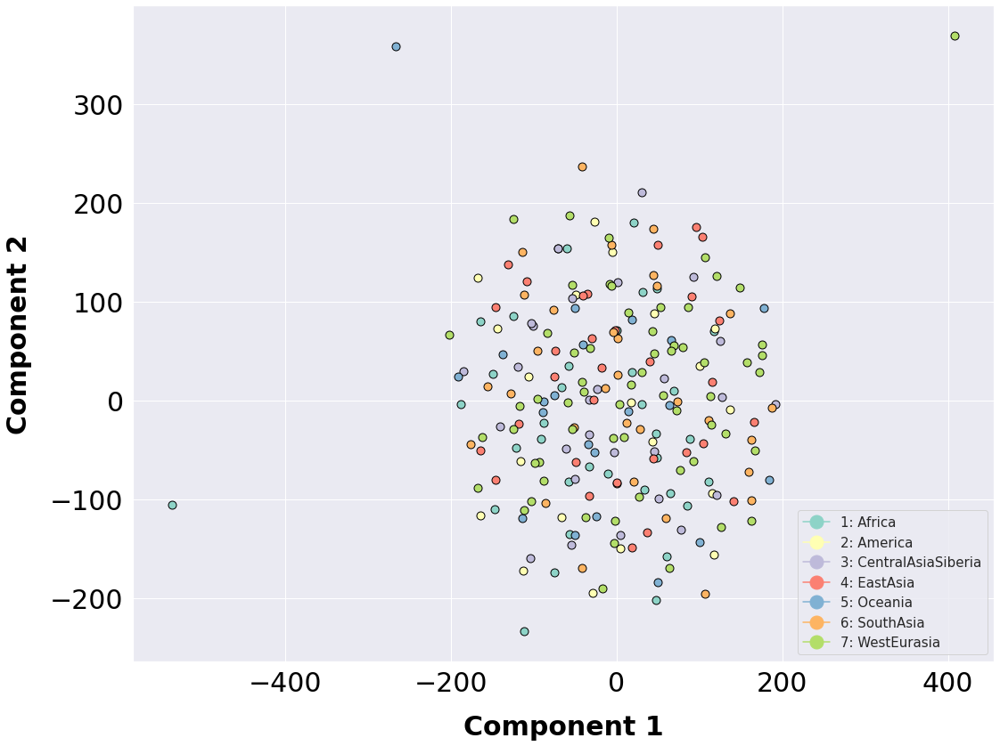

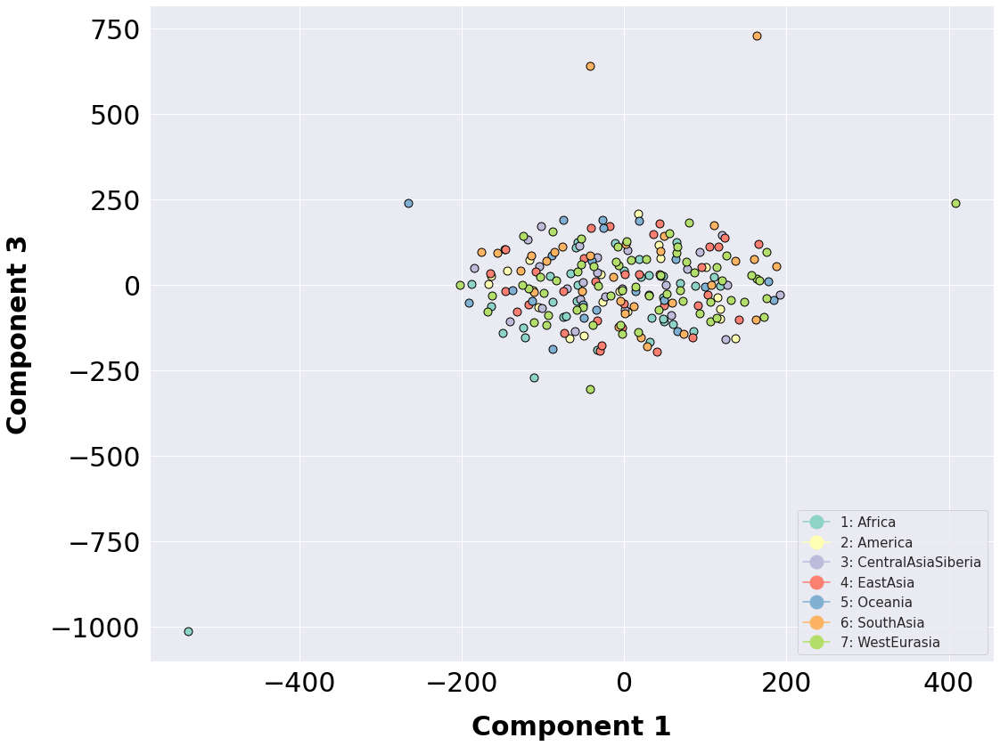

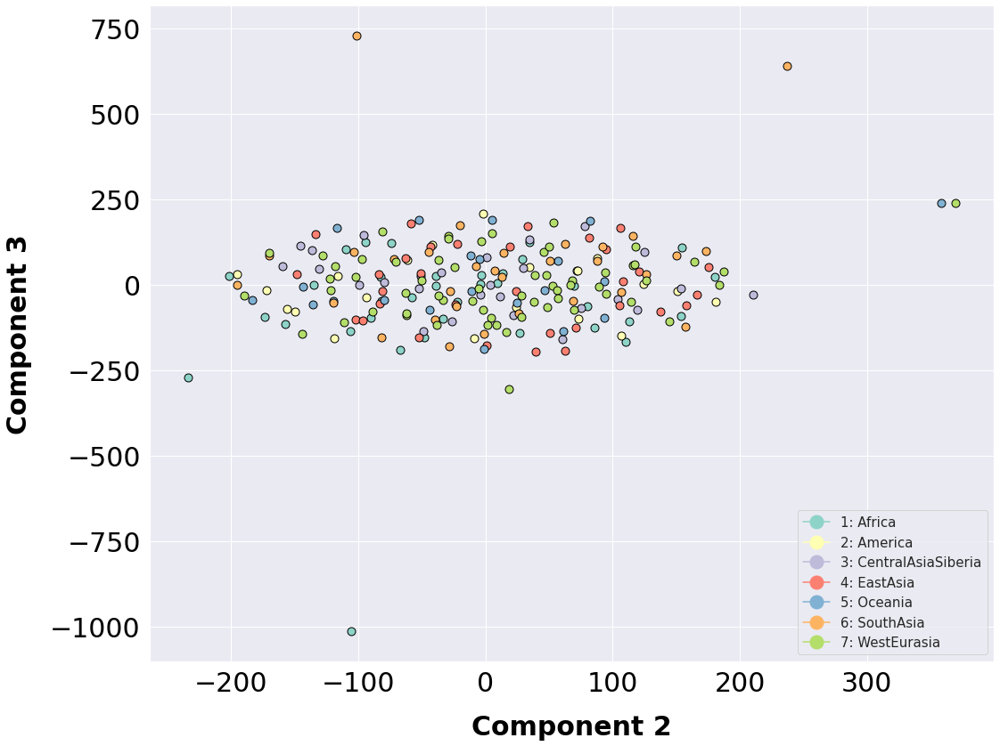

In [43]:
#tsneplot= plot_scatter_cluster(data=df_tsne, abscissa='component_1', ordinate='component_2', label_horizontal='Component 1', label_vertical='Component 2', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)

components = [1,2,3]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_tsne, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='Component '+ str(i[0]), label_vertical='Component '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland   -23.956218   -15.478631   -14.013601   
WestEurasia        F      Iceland     1.094153     0.627281    -1.035710   
SouthAsia          F     Pakistan   -22.203958     1.168628     8.272920   
SouthAsia          M     Pakistan    -1.098071    -1.146911     1.985196   
Africa             M  SierraLeone   -21.140573     0.268476   -12.060389   
...              ...          ...          ...          ...          ...   
America            F       Brazil    12.628014    -9.972286    -2.592210   
WestEurasia        F       Russia    11.723855    -4.708756    12.894374   
EastAsia           M      Myanmar    15.432476   -23.937415   -19.394219   
Africa             F        Congo     7.940804   -16.487629     9.274147   
WestEurasia        M        Yemen     4.179247    -8.767624   -10.014381   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland   -23.956218   -15.478631   -14.013601   
WestEurasia        F      Iceland     1.094153     0.627281    -1.035710   
SouthAsia          F     Pakistan   -22.203958     1.168628     8.272920   
SouthAsia          M     Pakistan    -1.098071    -1.146911     1.985196   
Africa             M  SierraLeone   -21.140573     0.268476   -12.060389   
...              ...          ...          ...          ...          ...   
America            F       Brazil    12.628014    -9.972286    -2.592210   
WestEurasia        F       Russia    11.723855    -4.708756    12.894374   
EastAsia           M      Myanmar    15.432476   -23.937415   -19.394219   
Africa             F        Congo     7.940804   -16.487629     9.274147   
WestEurasia        M        Yemen     4.179247    -8.767624   -10.014381   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland   -23.956218   -15.478631   -14.013601   
WestEurasia        F      Iceland     1.094153     0.627281    -1.035710   
SouthAsia          F     Pakistan   -22.203958     1.168628     8.272920   
SouthAsia          M     Pakistan    -1.098071    -1.146911     1.985196   
Africa             M  SierraLeone   -21.140573     0.268476   -12.060389   
...              ...          ...          ...          ...          ...   
America            F       Brazil    12.628014    -9.972286    -2.592210   
WestEurasia        F       Russia    11.723855    -4.708756    12.894374   
EastAsia           M      Myanmar    15.432476   -23.937415   -19.394219   
Africa             F        Congo     7.940804   -16.487629     9.274147   
WestEurasia        M        Yemen     4.179247    -8.767624   -10.014381   

           

/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland   -23.956218   -15.478631   -14.013601   
WestEurasia        F      Iceland     1.094153     0.627281    -1.035710   
SouthAsia          F     Pakistan   -22.203958     1.168628     8.272920   
SouthAsia          M     Pakistan    -1.098071    -1.146911     1.985196   
Africa             M  SierraLeone   -21.140573     0.268476   -12.060389   
...              ...          ...          ...          ...          ...   
America            F       Brazil    12.628014    -9.972286    -2.592210   
WestEurasia        F       Russia    11.723855    -4.708756    12.894374   
EastAsia           M      Myanmar    15.432476   -23.937415   -19.394219   
Africa             F        Congo     7.940804   -16.487629     9.274147   
WestEurasia        M        Yemen     4.179247    -8.767624   -10.014381   

           

Count of groups by factor: 7
            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland   -23.956218   -15.478631   -14.013601   
WestEurasia        F      Iceland     1.094153     0.627281    -1.035710   
SouthAsia          F     Pakistan   -22.203958     1.168628     8.272920   
SouthAsia          M     Pakistan    -1.098071    -1.146911     1.985196   
Africa             M  SierraLeone   -21.140573     0.268476   -12.060389   
...              ...          ...          ...          ...          ...   
America            F       Brazil    12.628014    -9.972286    -2.592210   
WestEurasia        F       Russia    11.723855    -4.708756    12.894374   
EastAsia           M      Myanmar    15.432476   -23.937415   -19.394219   
Africa             F        Congo     7.940804   -16.487629     9.274147   
WestEurasia        M        Yemen     4.179247    -8.767624

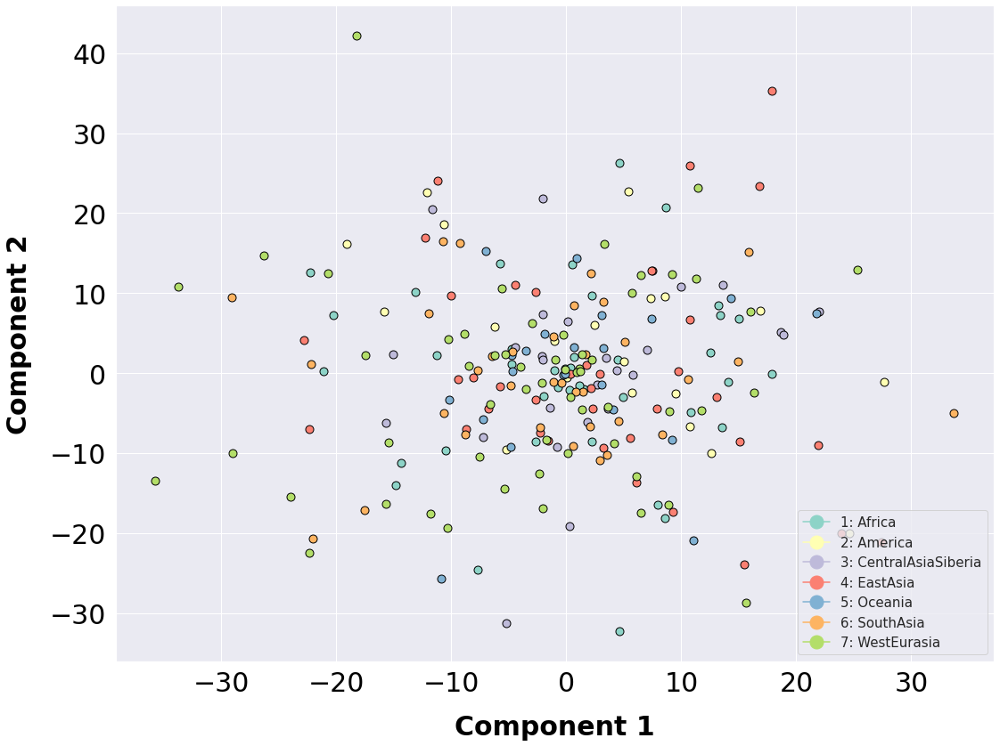

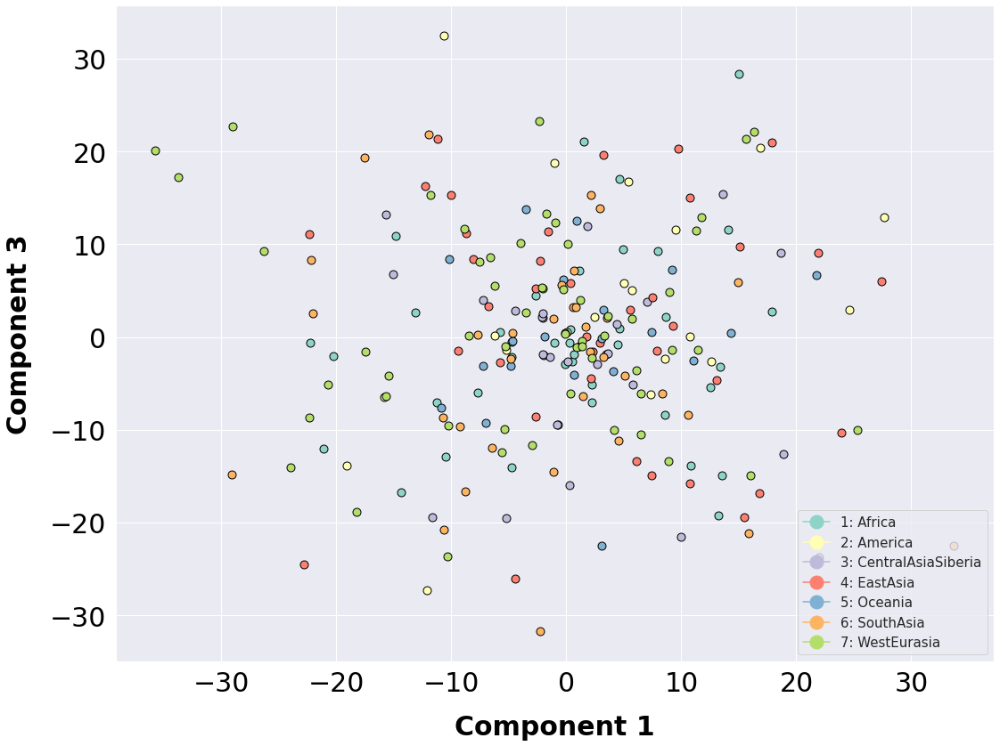

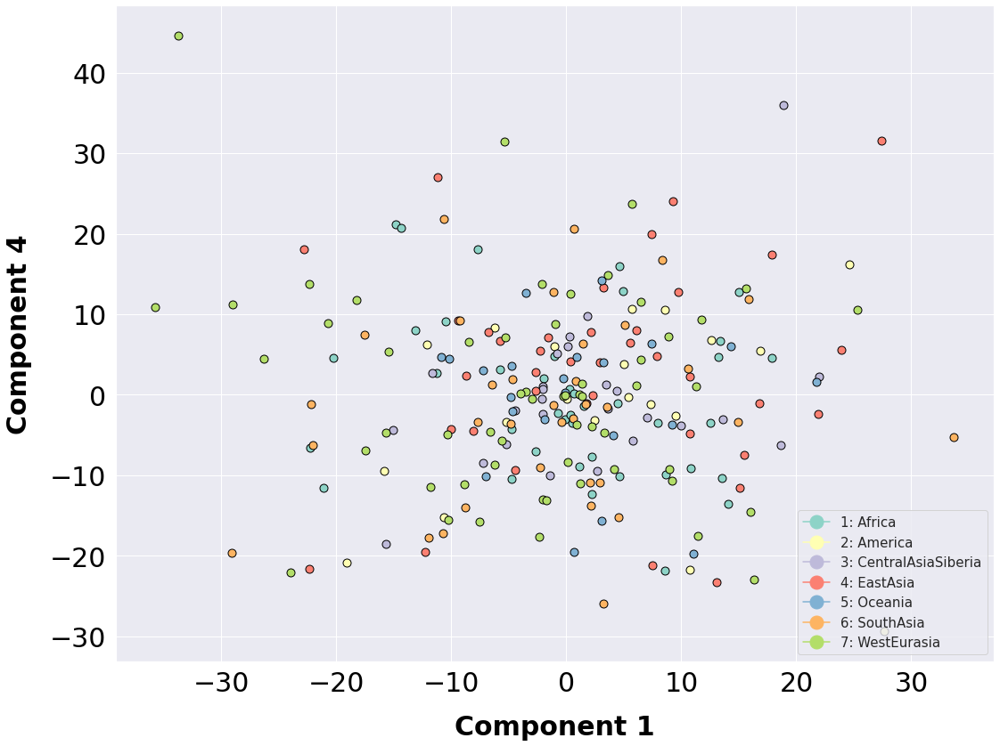

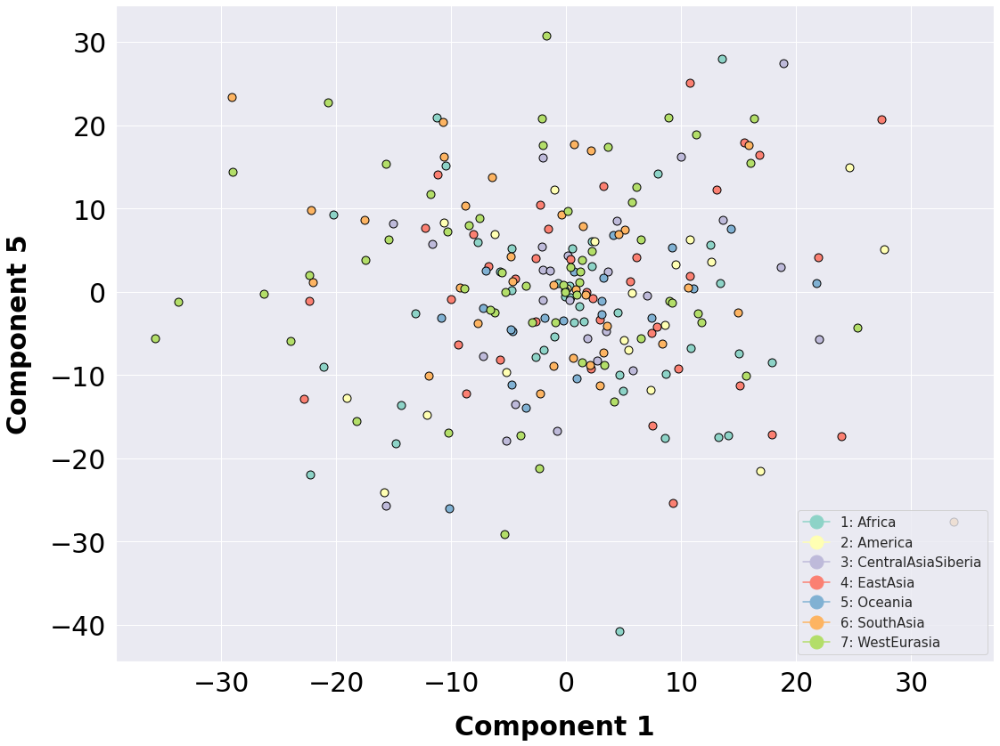

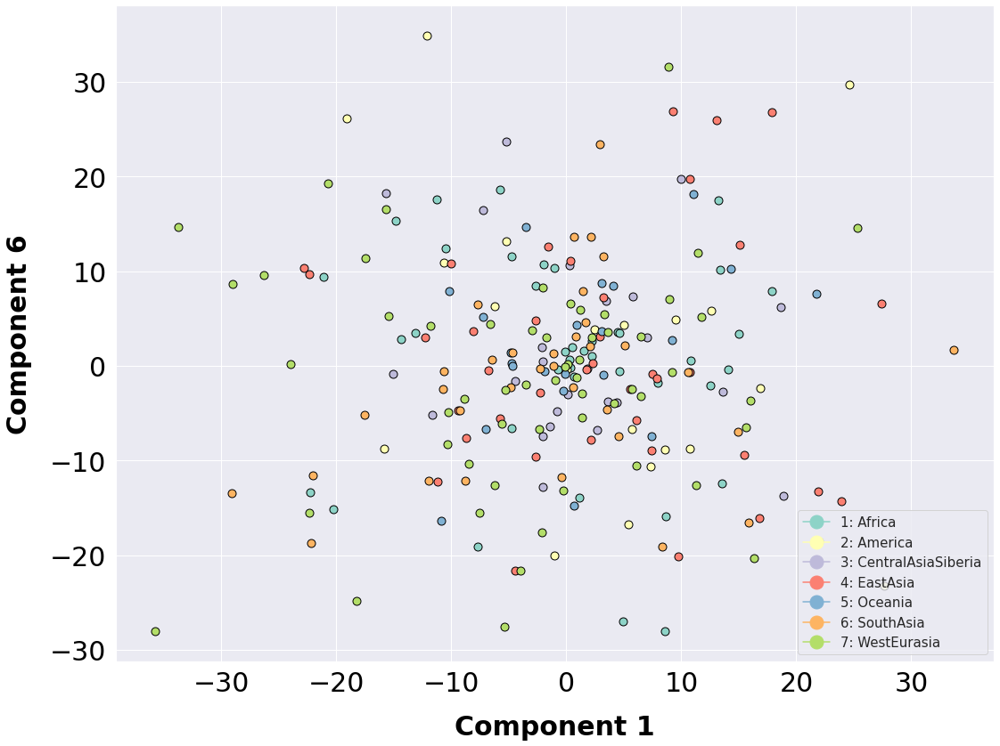

...

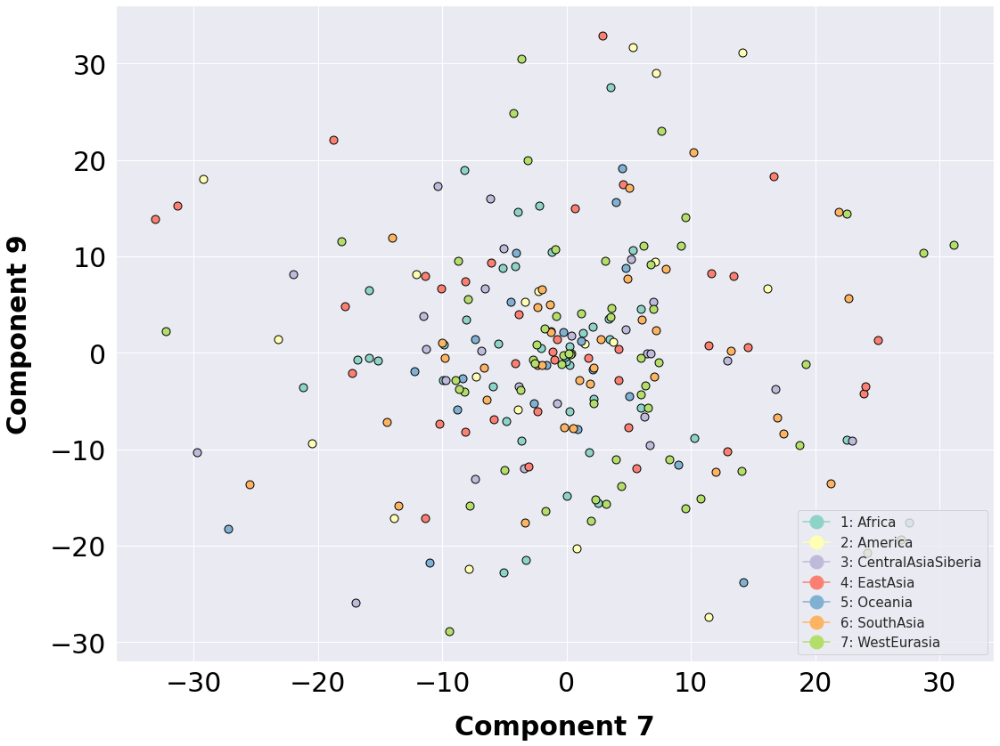

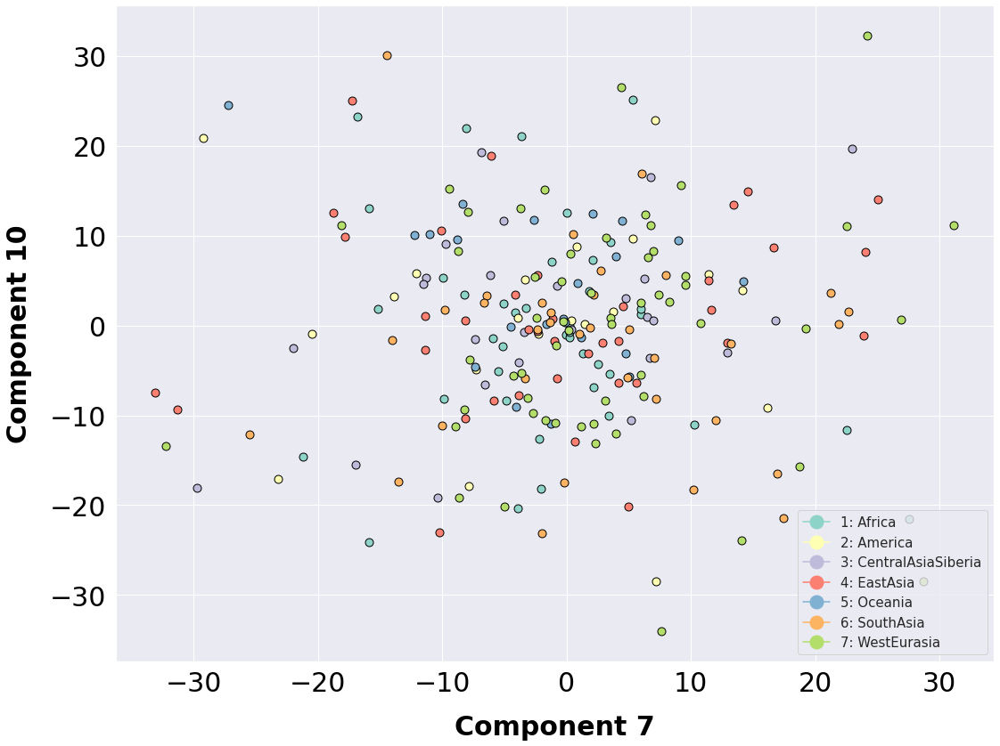

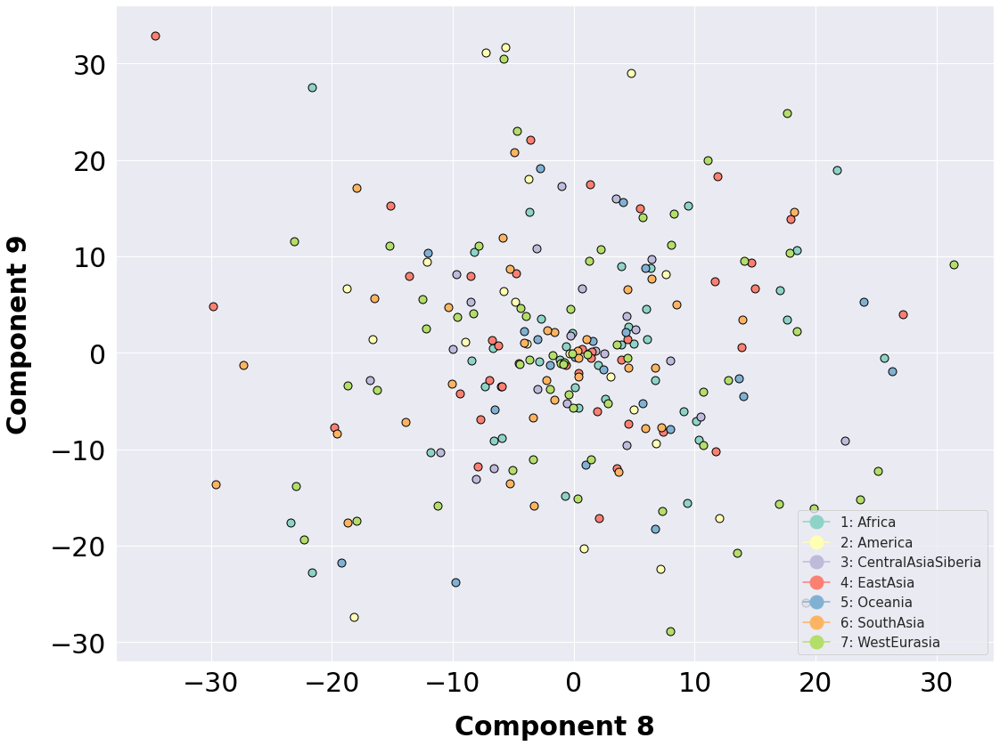

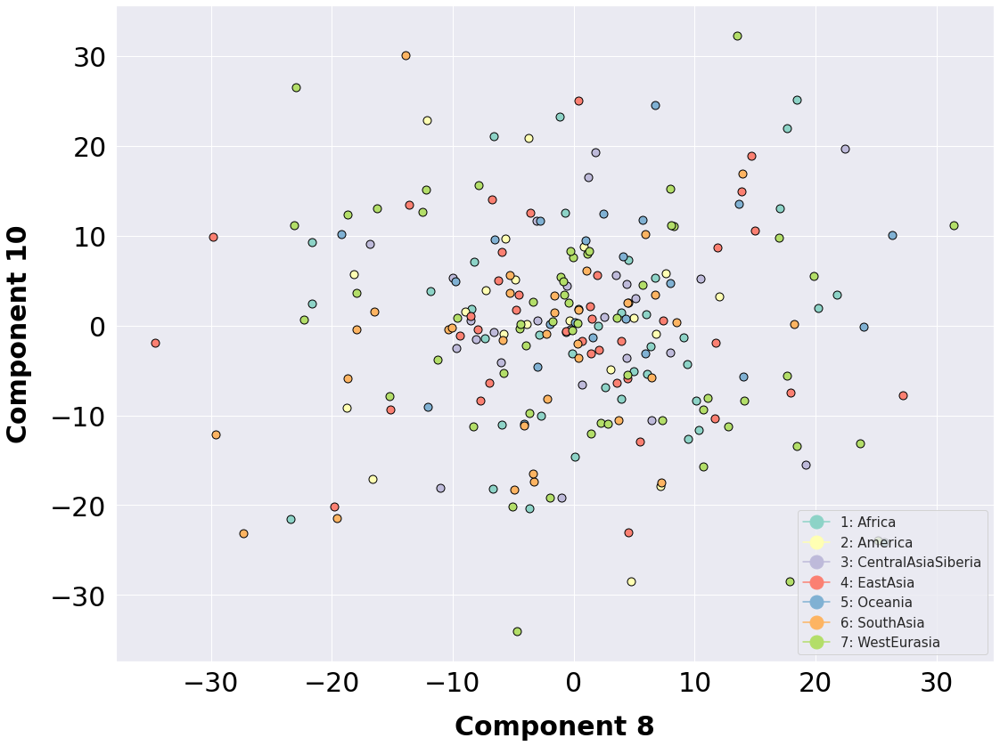

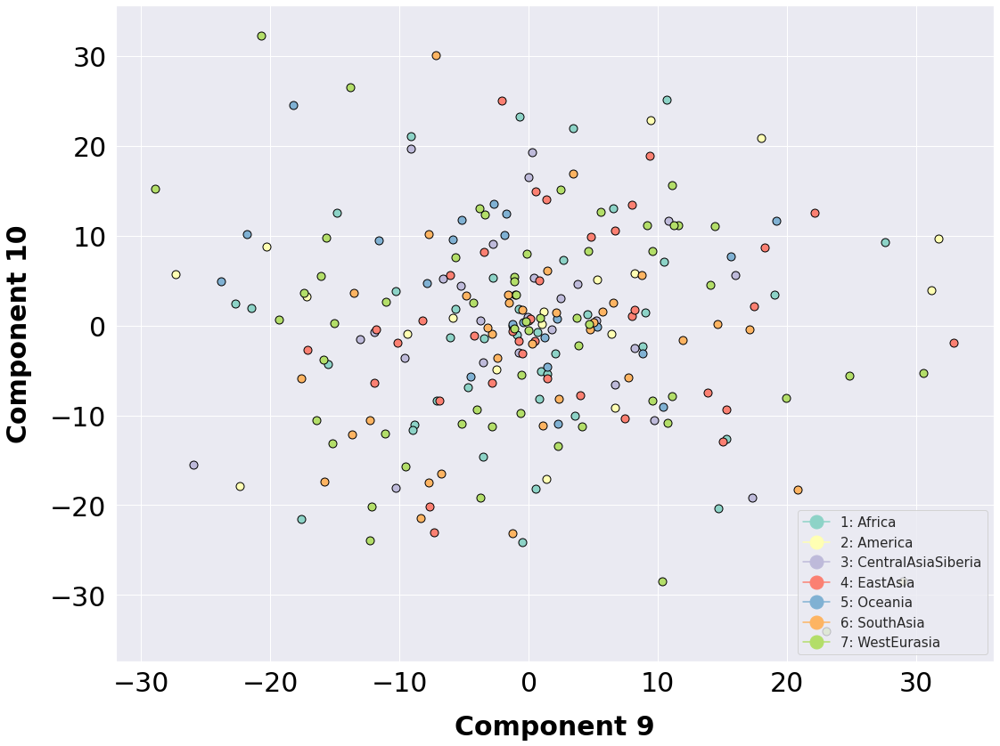

In [51]:
mds = MDS(10,random_state=0)
mds_results = mds.fit_transform(X)

df_mds= pd.DataFrame(mds_results,
                          columns=['component_1','component_2', 'component_3','component_4','component_5', 'component_6', 'component_7','component_8', 'component_9','component_10'],
                          index=features.index)



df_mds = features.merge(df_mds, left_index=True, right_index=True)
df_mds

components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_mds, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='Component '+ str(i[0]), label_vertical='Component '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    
   

<h1> CNV Regions

In [26]:
individual_cnv_cnvr = pd.read_table("/branchinecta/jbazanwilliamson/RANGE_HG38/cnvr_cnvnator/individual_cnv_cnvr.txt")

individual_cnv_cnvr['Chr'] = individual_cnv_cnvr['Chr'].astype(str)

individual_cnv_cnvr = individual_cnv_cnvr.pivot_table(index=["CNVR_ID", "Chr", "Start", "End"], 
                    columns='Sample_ID', 
                    values='CNV_Value').reset_index()

np_cnvr = individual_cnv_cnvr.to_numpy()

#Drop CNVR with less than X samples 
individual_cnv_cnvr = individual_cnv_cnvr.dropna(thresh=6)
individual_cnv_cnvr



Sample_ID,CNVR_ID,Chr,Start,End,SAMEA3302610,SAMEA3302611,SAMEA3302613,SAMEA3302614,SAMEA3302615,SAMEA3302616,...,SAMEA3302882,SAMEA3302883,SAMEA3302886,SAMEA3302887,SAMEA3302889,SAMEA3302896,SAMEA3302903,SAMEA3302906,SAMEA3302908,SAMEA3302911
0,CNVR_1,1,85001,4235000.0,NaN,NaN,NaN,NaN,NaN,NaN,...,1.0,NaN,NaN,3.0,NaN,NaN,NaN,NaN,NaN,4.0
1,CNVR_10,1,13665001,13800000.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,CNVR_100,1,114825001,115000000.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,CNVR_1000,7,104880001,105150000.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,CNVR_1001,7,105170001,105705000.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2169,CNVR_990,7,92605001,92855000.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2170,CNVR_991,7,93100001,93315000.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2174,CNVR_995,7,96975001,97655000.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,3.0,NaN,NaN,NaN,NaN,NaN,NaN
2176,CNVR_997,7,97960001,98130000.0,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [27]:
counts = individual_cnv_cnvr.iloc[:,4:283]

counts = counts.dropna(thresh=6)

counts = counts.fillna(2)

counts

Sample_ID,SAMEA3302610,SAMEA3302611,SAMEA3302613,SAMEA3302614,SAMEA3302615,SAMEA3302616,SAMEA3302618,SAMEA3302619,SAMEA3302620,SAMEA3302621,...,SAMEA3302882,SAMEA3302883,SAMEA3302886,SAMEA3302887,SAMEA3302889,SAMEA3302896,SAMEA3302903,SAMEA3302906,SAMEA3302908,SAMEA3302911
0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,1.0,2.0,2.0,3.0,2.000000,2.0,2.0,2.0,2.0,4.0
10,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.000000,2.0,2.0,2.0,2.0,2.0
20,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.000000,2.0,2.0,2.0,2.0,2.0
30,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,1.0,2.0,2.0,2.0,2.000000,2.0,1.0,2.0,0.0,2.0
31,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,1.000000,2.0,2.0,2.0,2.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2149,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,3.0,2.000000,2.0,2.0,2.0,3.0,2.0
2151,2.0,2.0,2.0,2.0,2.0,3.0,2.0,1.0,2.0,1.0,...,2.0,0.0,2.0,3.0,1.666667,2.0,1.0,2.0,2.0,2.0
2152,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.000000,2.0,2.0,2.0,2.0,2.0
2158,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.000000,2.0,2.0,1.0,2.0,2.0


In [28]:
hist = (np.array(counts).flatten())

seaborn.set(font_scale=2)
seaborn.histplot(hist)

AttributeError: module 'seaborn' has no attribute 'histplot'

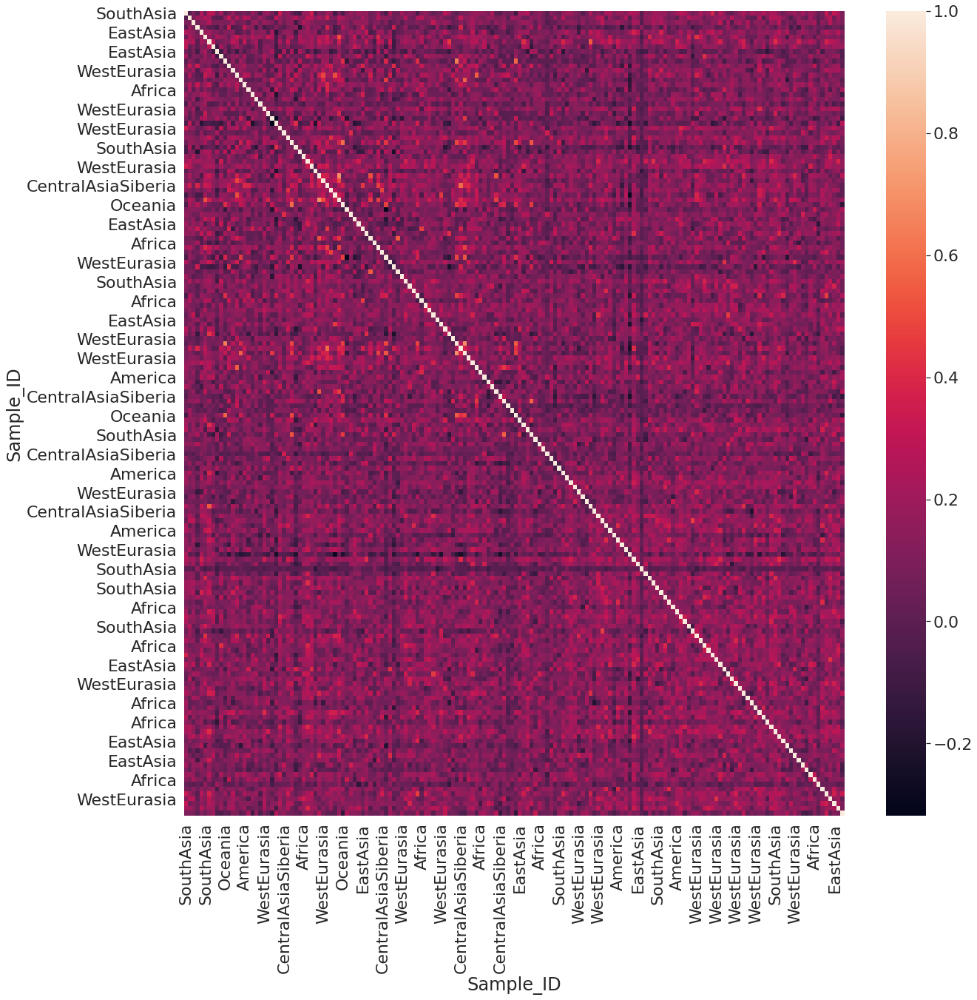

In [29]:
f, ax = plt.subplots(figsize=(20, 20))
seaborn.set(font_scale=2)
input_matrix = counts.rename(columns=anotation['10-Region'])
corrmatrix = input_matrix.corr()
seaborn.heatmap(corrmatrix)
plt.show()

In [31]:
seaborn.set(font_scale=2)

import seaborn as sns; sns.set_theme(color_codes=True)
lut = dict(zip(corrmatrix.columns.unique(), "rbgymck"))
lut

row_colors = corrmatrix.columns.map(lut)
seaborn.clustermap(corrmatrix, method='complete',row_colors=row_colors, row_cluster=True, figsize=(40,40))
#seaborn.clustermap(corrmatrix, figsize=(30,30))

TypeError: 'float' object is not iterable

<Figure size 2880x2880 with 0 Axes>

In [ ]:
corrmatrix.columns


In [ ]:
row_colors

In [154]:
freq = individual_cnv_cnvr.iloc[:,4:283]
freq_input = freq.rename(columns=anotation['11-Country'])
df = freq_input.T

df = df.notnull().groupby(level=0).mean()

high_freq_mex = df.T

high_freq_mex['Mexico'].sort_values()





1057    0.000000
1304    0.000000
1305    0.000000
1310    0.000000
1313    0.000000
          ...   
703     0.666667
1181    0.666667
1571    0.777778
1947    0.777778
1703    0.888889
Name: Mexico, Length: 1031, dtype: float64

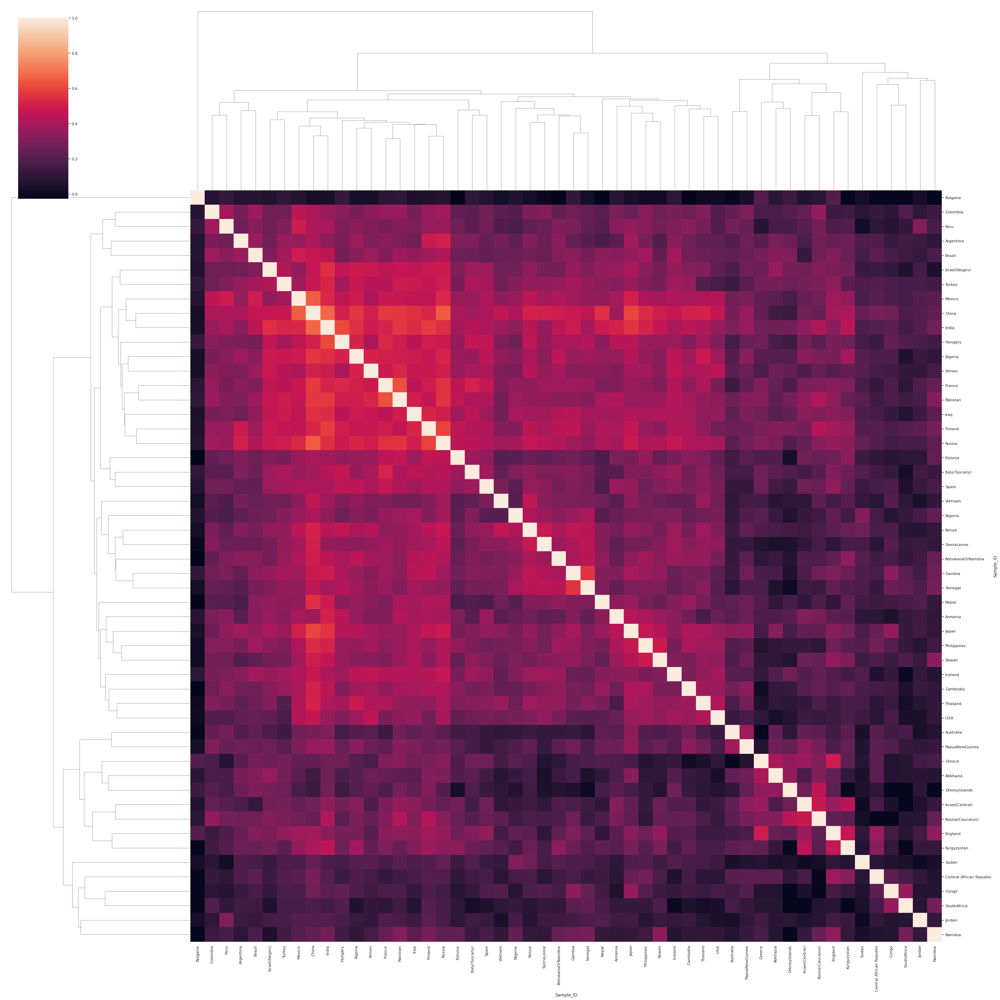

In [158]:
corrmatrix = df.T.corr(method='pearson')
seaborn.clustermap(corrmatrix, row_cluster=True,figsize=(40,40))

In [156]:
corrmatrix

Sample_ID,Abkhazia,Algeria,Argentina,Armenia,Australia,BotswanaOrNamibia,Brazil,Bulgaria,Cambodia,Central African Republic,...,SierraLeone,SouthAfrica,Spain,Sudan,Taiwan,Thailand,Turkey,USA,Vietnam,Yemen
Sample_ID,,,,,,,,,,,,,,,,,,,,,
Abkhazia,1.000000,0.204490,0.284731,0.181148,0.230877,0.131110,0.317057,0.093465,0.125763,0.221679,...,0.046530,0.081532,0.156545,0.049054,0.101029,0.104449,0.276898,0.034367,0.082710,0.255592
Algeria,0.204490,1.000000,0.376505,0.359591,0.194046,0.449452,0.329349,0.038474,0.380714,0.184653,...,0.332335,0.057401,0.450141,0.200097,0.324468,0.486634,0.475958,0.379322,0.347992,0.515926
Argentina,0.284731,0.376505,1.000000,0.215027,0.196705,0.333113,0.368612,0.073393,0.267247,0.187578,...,0.255643,0.146048,0.239696,0.182867,0.191013,0.229952,0.361846,0.234063,0.279069,0.301322
Armenia,0.181148,0.359591,0.215027,1.000000,0.211154,0.241242,0.322788,0.082172,0.259902,0.090417,...,0.222802,0.113933,0.368674,0.095595,0.361257,0.167758,0.325967,0.247246,0.213491,0.307638
Australia,0.230877,0.194046,0.196705,0.211154,1.000000,0.123806,0.230879,-0.009993,0.270462,0.212067,...,0.118553,0.166207,0.122516,0.041779,0.185049,0.174974,0.135409,0.126312,0.111568,0.217942
BotswanaOrNamibia,0.131110,0.449452,0.333113,0.241242,0.123806,1.000000,0.318536,-0.022599,0.350838,0.146661,...,0.371855,0.113774,0.280912,0.203026,0.331801,0.353957,0.358638,0.287568,0.302108,0.387419
Brazil,0.317057,0.329349,0.368612,0.322788,0.230879,0.318536,1.000000,0.074723,0.259360,0.220969,...,0.248299,0.145282,0.231529,0.158541,0.235527,0.257381,0.388955,0.238920,0.247240,0.373830
Bulgaria,0.093465,0.038474,0.073393,0.082172,-0.009993,-0.022599,0.074723,1.000000,-0.026528,-0.010376,...,0.005502,-0.008752,0.073354,0.034059,0.018871,0.009072,0.102815,0.014462,0.029345,0.037668
Cambodia,0.125763,0.380714,0.267247,0.259902,0.270462,0.350838,0.259360,-0.026528,1.000000,0.160426,...,0.323651,0.056940,0.292562,0.168917,0.295528,0.370784,0.361880,0.358516,0.235463,0.402152


In [126]:
#track features for pca & tsne
count = counts.T
features = anotation.merge(count, left_index=True, right_index=True)
features = features.loc[:,["7-Gender","10-Region", "11-Country"]]
features

#imputation and normalization 
imp = SimpleImputer(missing_values=np.nan, strategy='median')
X = imp.fit_transform(counts.T)
X = StandardScaler().fit_transform(X)


#PCA
#pca = PCA(.95)
pca = PCA(n_components=10)
pca_results = pca.fit_transform(X)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3','component_4','component_5', 'component_6', 'component_7','component_8', 'component_9','component_10'],
                          index=features.index)




df_pca = features.merge(df_pca, left_index=True, right_index=True)
df_pca 

,7-Gender,10-Region,11-Country,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
SAMEA3302859,F,WestEurasia,Iceland,0.082305,0.114150,-1.259018,1.400353,1.016684,1.339390,-1.293509,-0.210966,0.161407,-1.242697
SAMEA3302837,F,WestEurasia,Iceland,-0.630896,-3.460171,0.983413,-1.491465,-1.121212,0.367552,0.665919,0.482924,-1.058171,-0.384223
SAMEA3302616,F,SouthAsia,Pakistan,1.132595,-3.520926,-0.385913,2.367290,-2.073696,1.692845,-0.591748,0.474293,0.729114,3.074386
SAMEA3302647,M,Africa,SierraLeone,-1.653982,0.008290,1.264782,-0.329936,-1.257966,0.296188,1.548021,-1.473770,-0.230375,0.299668
SAMEA3302748,F,Africa,SierraLeone,2.036764,-2.620773,-0.141586,-1.259937,-2.153230,5.259516,-1.451586,0.306195,-1.065551,-1.226488
...,...,...,...,...,...,...,...,...,...,...,...,...,...
SAMEA3302786,M,WestEurasia,Russia,-1.021014,0.303784,-1.154690,-0.451603,0.469007,1.102035,-0.041794,0.235821,0.118471,-0.757779
SAMEA3302790,M,America,Brazil,2.965192,-5.637190,-0.036912,-2.785528,-0.851483,-0.928288,-1.065506,-0.359887,-0.832069,1.023656
SAMEA3302662,F,America,Brazil,-1.131771,0.282373,-0.664397,0.650262,-0.060357,1.062655,1.064509,0.094361,0.600710,-0.370063
SAMEA3302766,F,WestEurasia,Russia,10.481973,-0.379208,-0.875872,-3.126815,6.281587,6.048018,0.206719,-0.385665,1.405393,0.353029


In [127]:
pca.explained_variance_ratio_

array([0.07720469, 0.05985872, 0.04454467, 0.03587778, 0.03516548,
       0.03177203, 0.02692814, 0.02584067, 0.02472234, 0.02267785])

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.813826    -1.521713    -2.299448   
WestEurasia        F      Iceland    -0.964825    -1.163838    -1.600882   
SouthAsia          F     Pakistan   -17.434566    19.917897    16.764831   
Africa             M  SierraLeone    -0.452392    -1.632767    -1.750613   
Africa             F  SierraLeone    -0.472312     0.670128    -1.795600   
...              ...          ...          ...          ...          ...   
WestEurasia        M       Russia     0.045675    -1.576359    -1.782124   
America            M       Brazil    -1.875883    -0.526765    -1.189442   
America            F       Brazil    -0.172438    -1.811935    -1.955336   
WestEurasia        F       Russia    -1.259428     1.711453     0.744677   
WestEurasia        M        Yemen    -0.698532    -2.284791    -1.430787   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.813826    -1.521713    -2.299448   
WestEurasia        F      Iceland    -0.964825    -1.163838    -1.600882   
SouthAsia          F     Pakistan   -17.434566    19.917897    16.764831   
Africa             M  SierraLeone    -0.452392    -1.632767    -1.750613   
Africa             F  SierraLeone    -0.472312     0.670128    -1.795600   
...              ...          ...          ...          ...          ...   
WestEurasia        M       Russia     0.045675    -1.576359    -1.782124   
America            M       Brazil    -1.875883    -0.526765    -1.189442   
America            F       Brazil    -0.172438    -1.811935    -1.955336   
WestEurasia        F       Russia    -1.259428     1.711453     0.744677   
WestEurasia        M        Yemen    -0.698532    -2.284791    -1.430787   

           

            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.813826    -1.521713    -2.299448   
WestEurasia        F      Iceland    -0.964825    -1.163838    -1.600882   
SouthAsia          F     Pakistan   -17.434566    19.917897    16.764831   
Africa             M  SierraLeone    -0.452392    -1.632767    -1.750613   
Africa             F  SierraLeone    -0.472312     0.670128    -1.795600   
...              ...          ...          ...          ...          ...   
WestEurasia        M       Russia     0.045675    -1.576359    -1.782124   
America            M       Brazil    -1.875883    -0.526765    -1.189442   
America            F       Brazil    -0.172438    -1.811935    -1.955336   
WestEurasia        F       Russia    -1.259428     1.711453     0.744677   
WestEurasia        M        Yemen    -0.698532    -2.284791    -1.430787   

           

<ipython-input-33-633177199b43>:46: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.813826    -1.521713    -2.299448   
WestEurasia        F      Iceland    -0.964825    -1.163838    -1.600882   
SouthAsia          F     Pakistan   -17.434566    19.917897    16.764831   
Africa             M  SierraLeone    -0.452392    -1.632767    -1.750613   
Africa             F  SierraLeone    -0.472312     0.670128    -1.795600   
...              ...          ...          ...          ...          ...   
WestEurasia        M       Russia     0.045675    -1.576359    -1.782124   
America            M       Brazil    -1.875883    -0.526765    -1.189442   
America            F       Brazil    -0.172438    -1.811935    -1.955336   
WestEurasia        F       Russia    -1.259428     1.711453     0.744677   
WestEurasia        M        Yemen    -0.698532    -2.284791    -1.430787   

           

[168 rows x 12 columns]
Count of groups by factor: 7
            7-Gender   11-Country  component_1  component_2  component_3  \
10-Region                                                                  
WestEurasia        F      Iceland    -0.813826    -1.521713    -2.299448   
WestEurasia        F      Iceland    -0.964825    -1.163838    -1.600882   
SouthAsia          F     Pakistan   -17.434566    19.917897    16.764831   
Africa             M  SierraLeone    -0.452392    -1.632767    -1.750613   
Africa             F  SierraLeone    -0.472312     0.670128    -1.795600   
...              ...          ...          ...          ...          ...   
WestEurasia        M       Russia     0.045675    -1.576359    -1.782124   
America            M       Brazil    -1.875883    -0.526765    -1.189442   
America            F       Brazil    -0.172438    -1.811935    -1.955336   
WestEurasia        F       Russia    -1.259428     1.711453     0.744677   
WestEurasia        M        Yemen  

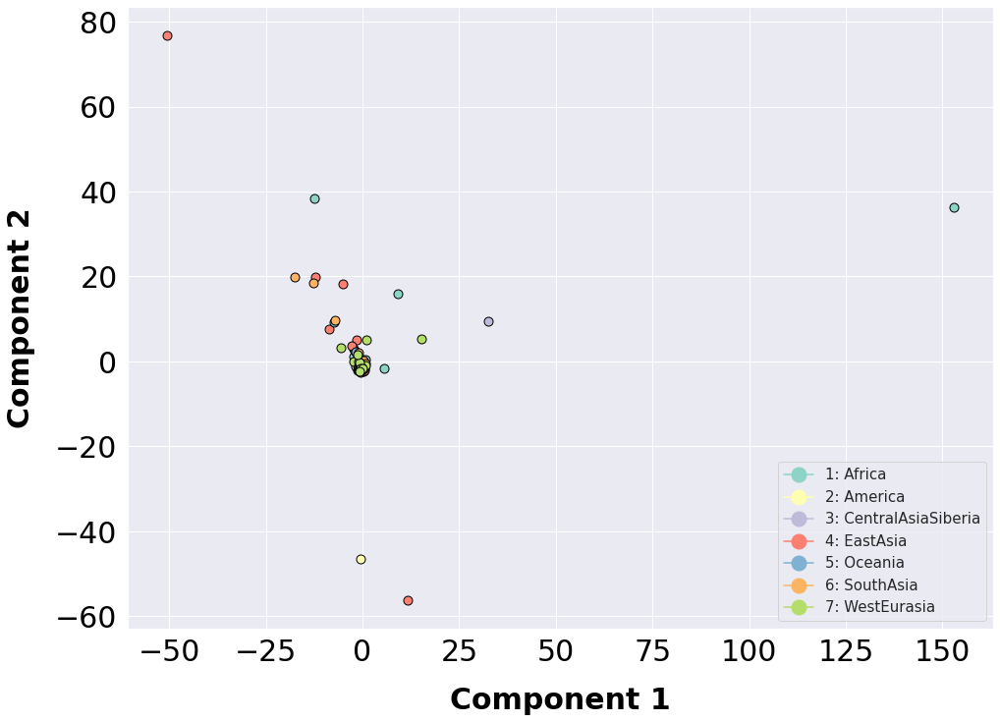

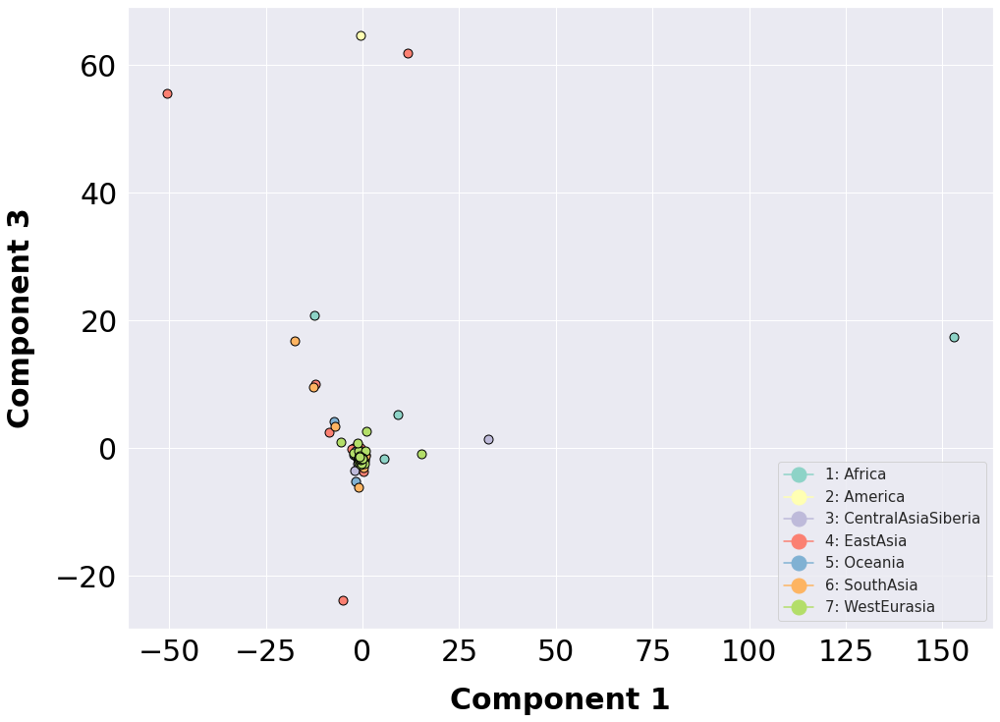

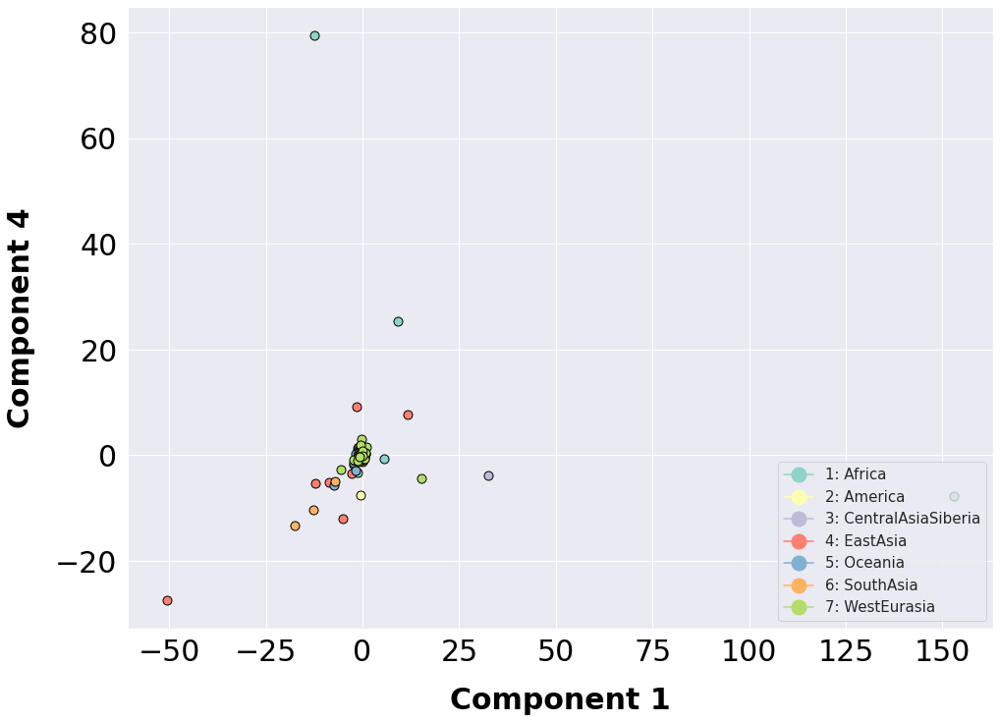

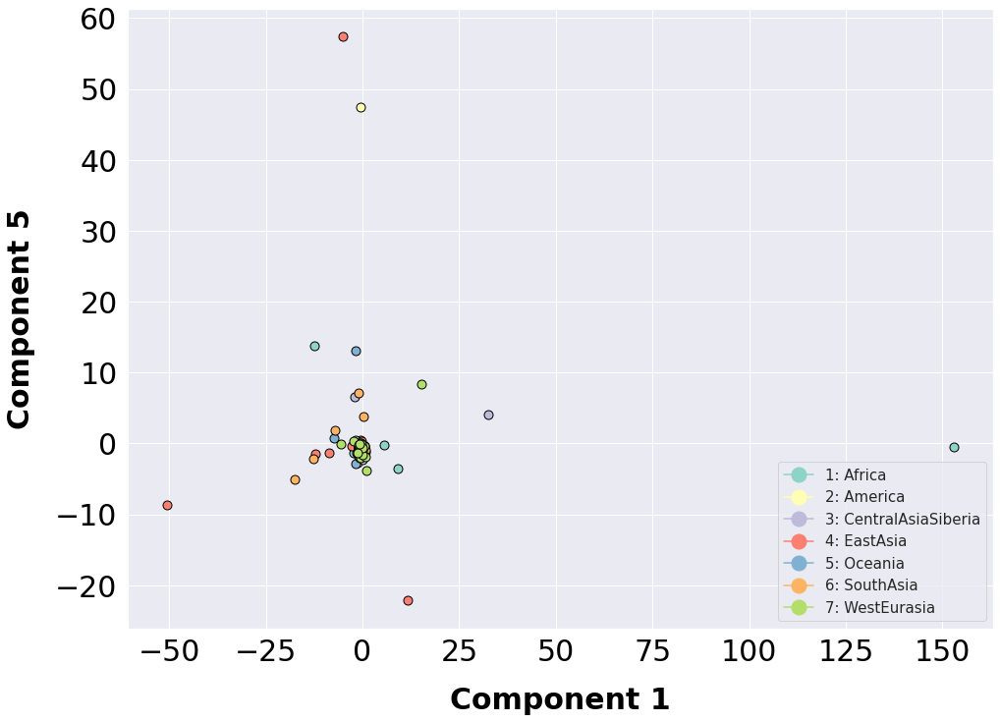

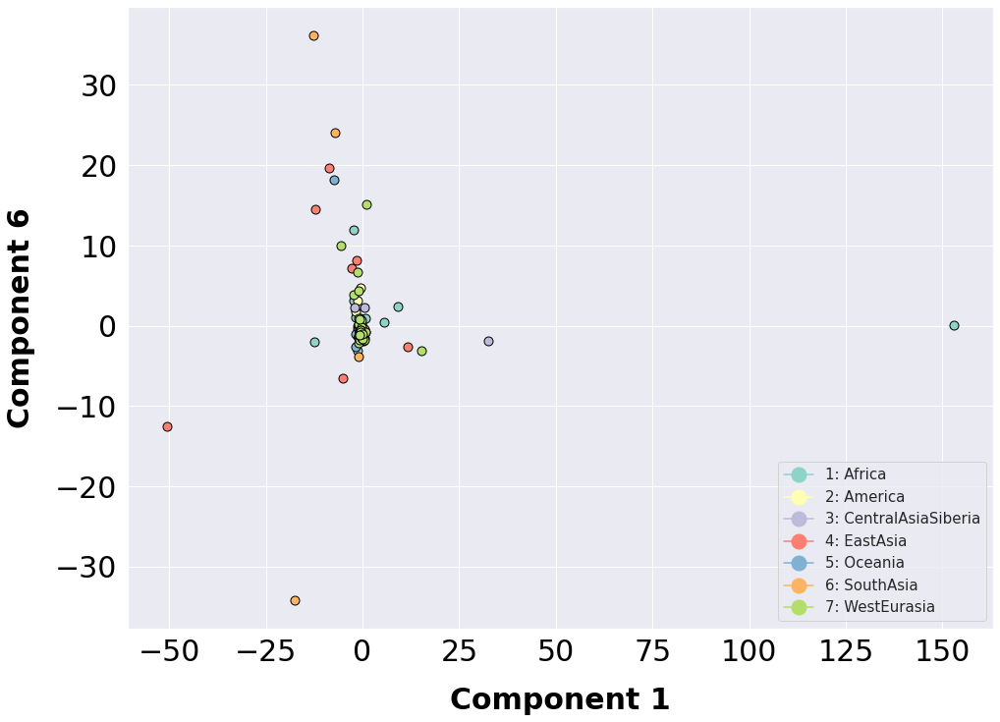

...

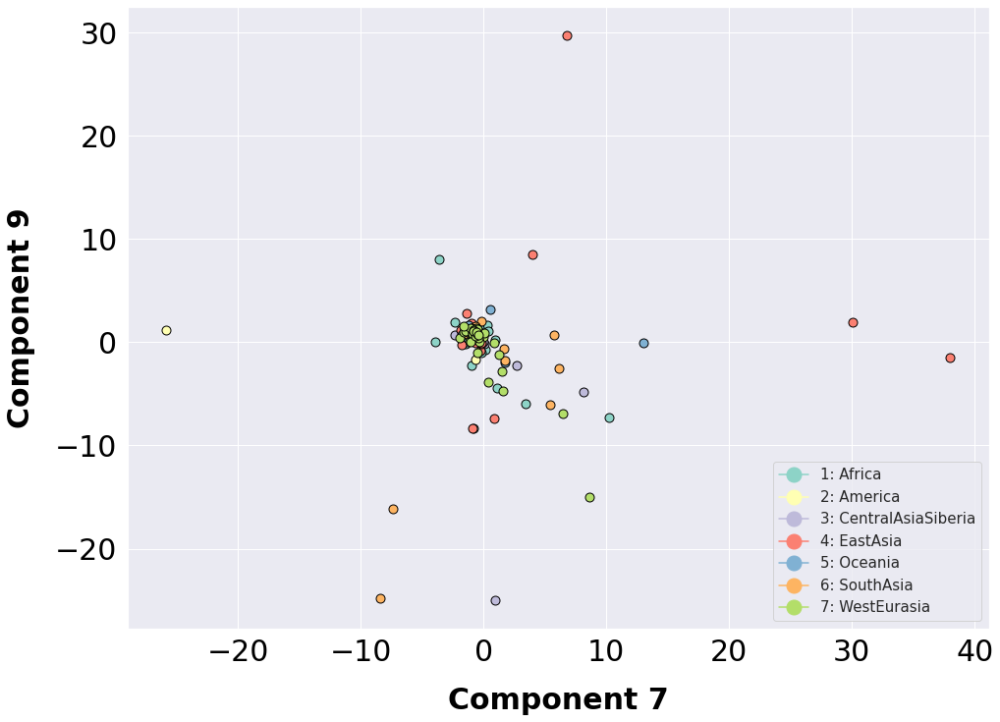

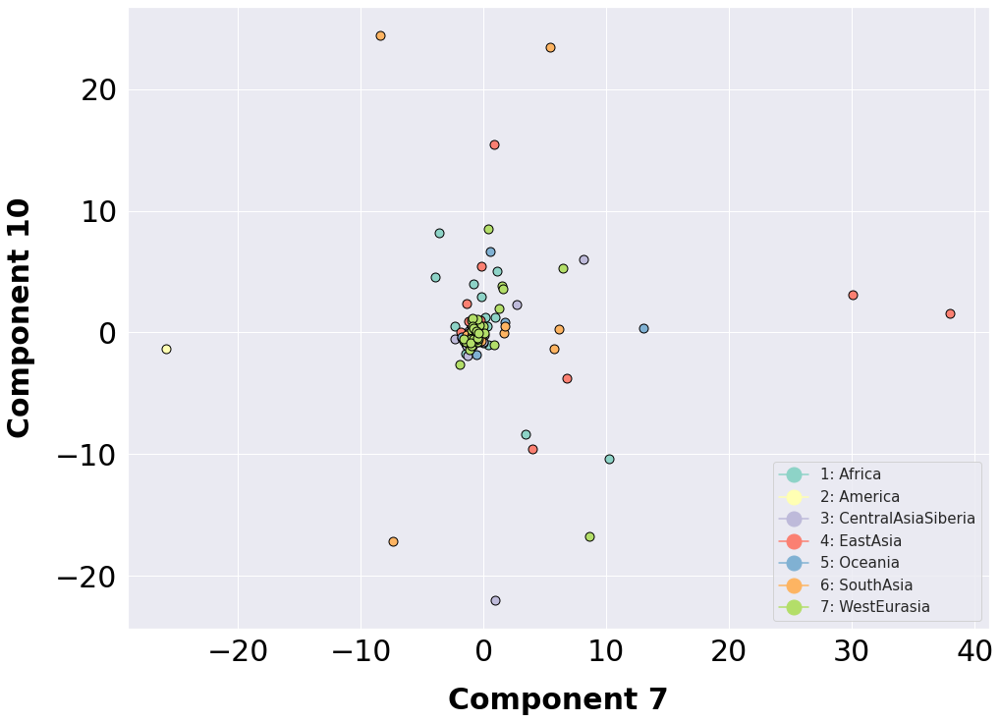

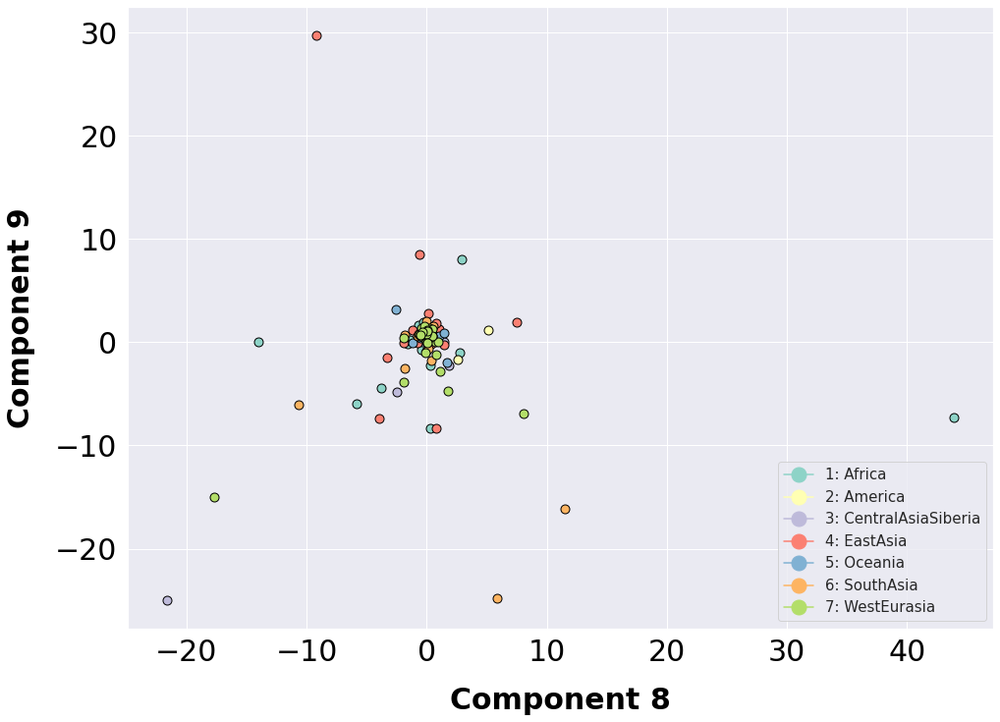

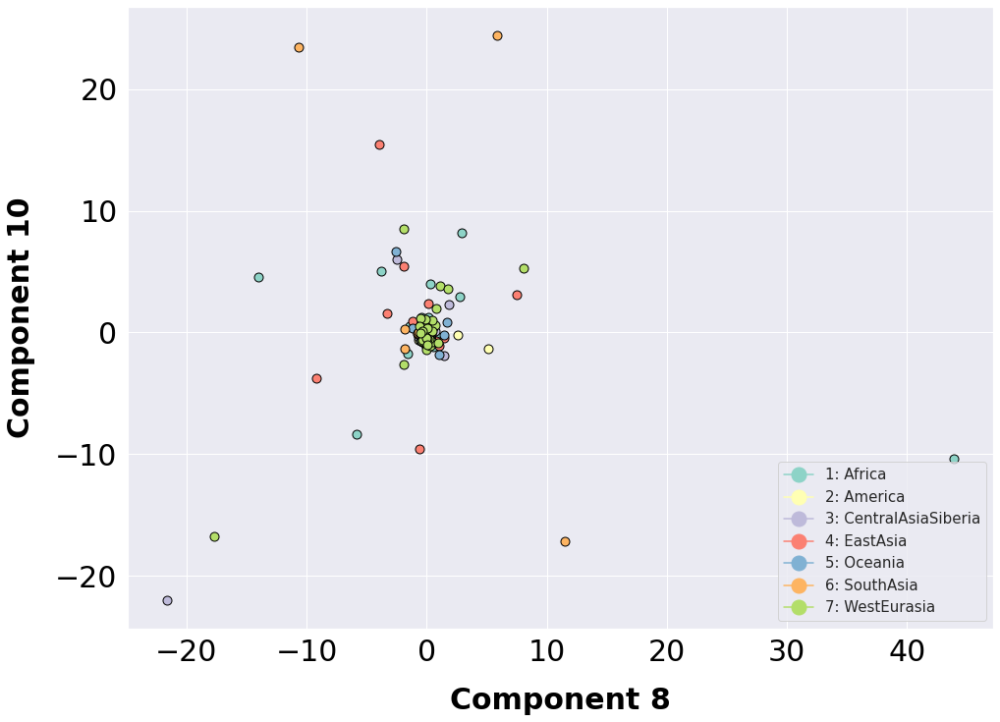

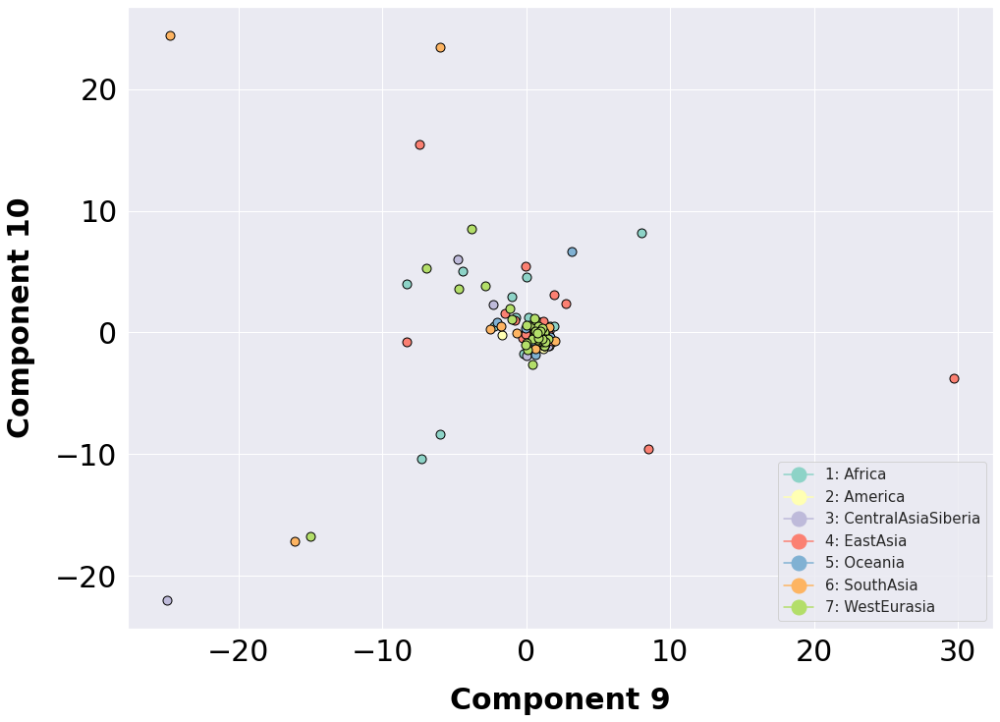

In [34]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='Component '+ str(i[0]), label_vertical='Component '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

<h1> CNVs Overlaped 

In [30]:
overlapped = []


for cnv_q in qdnaseq_df.to_numpy():
    for cnv_c in cnvnator_style.to_numpy():
    
        if cnv_q[1] == cnv_c[1]: #Chromosome
            # QDNASEQ CNVS in CNVNator CNVs(CNVnator bigger than  QDNASEQ)
            if (cnv_c[2] <= cnv_q[2] <= cnv_c[3]) & (cnv_c[2] <= cnv_q[3] <= cnv_c[3]):
                leng_dqna = (cnv_q[3]-cnv_q[2])
                leng_cnvnator = (cnv_c[3]-cnv_c[2])
                if (leng_dqna/leng_cnvnator)>0.6:
                    overlapped.append(cnv_q)
            # CNVNator CNVS in QDNASEQ CNVs(QDNASEQ bigger than  CNVnator)
            
            if (cnv_q[2] <= cnv_c[2] <= cnv_q[3]) & (cnv_q[2] <= cnv_c[3] <= cnv_q[3]):
                leng_dqna = (cnv_q[3]-cnv_q[2])
                leng_cnvnator = (cnv_c[3]-cnv_c[2])
                if (leng_cnvnator/leng_dqna)>0.6:
                    overlapped.append(cnv_q)
                    
            #
                    
                    
            #
            
                
#            if telomere[3] <= cnv[3] <= telomere[3]:
#                overlapped.append(cnv)
         
        
#wotelomeres = np.array(wotelomeres)


KeyboardInterrupt: 

In [ ]:

## WISECONDOR

In [67]:
#track features for pca & tsne
count = counts.T
features = anotation.merge(count, left_index=True, right_index=True)
features = features.loc[:,["7-Gender","10-Region", "11-Country"]]
features

#imputation and normalization 
#imp = SimpleImputer(missing_values=np.nan, strategy='median')
#X = fit_transform(counts.T)
X = StandardScaler().fit_transform(counts.T)


#PCA
#pca = PCA(.95)
pca = PCA(n_components=10)
pca_results = pca.fit_transform(X)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3','component_4','component_5', 'component_6', 'component_7','component_8', 'component_9','component_10'],
                          index=features.index)




df_pca = features.merge(df_pca, left_index=True, right_index=True)
df_pca 

,7-Gender,10-Region,11-Country,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
SAMEA3302616,F,SouthAsia,Pakistan,-1.907587,-1.532861,-2.111326,0.178065,0.048230,-0.152429,-0.094050,0.044611,-0.004306,-0.090293
SAMEA3302655,M,WestEurasia,Abkhazia,-1.900420,-1.525360,-2.075469,0.173148,0.045426,-0.141390,-0.085433,0.039762,-0.003896,-0.076056
SAMEA3302693,M,WestEurasia,Russia,-1.900362,-1.525300,-2.075184,0.173109,0.045404,-0.141307,-0.085370,0.039727,-0.003892,-0.075961
SAMEA3302731,M,SouthAsia,Pakistan,-1.900362,-1.525300,-2.075184,0.173109,0.045404,-0.141307,-0.085370,0.039727,-0.003893,-0.075959
SAMEA3302749,M,SouthAsia,Pakistan,-1.908277,-1.533593,-2.115352,0.178685,0.048728,-0.154742,-0.096203,0.046485,-0.005014,-0.097085
...,...,...,...,...,...,...,...,...,...,...,...,...,...
SAMEA3302709,F,America,Peru,-1.900684,-1.525643,-2.077185,0.173426,0.045654,-0.142415,-0.086363,0.040339,-0.003940,-0.078050
SAMEA3302878,M,EastAsia,China,-1.897135,-1.521939,-2.060005,0.171134,0.044461,-0.137960,-0.083114,0.038813,-0.003981,-0.074839
SAMEA3302786,M,WestEurasia,Russia,-1.908084,-1.533482,-2.107391,0.172657,0.035858,-0.100986,-0.070702,0.026834,0.004073,0.026918
SAMEA3302790,M,America,Brazil,-1.900362,-1.525300,-2.075184,0.173109,0.045404,-0.141307,-0.085370,0.039727,-0.003892,-0.075960


            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

<ipython-input-30-633177199b43>:46: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

             component_4  component_5

Count of groups by factor: 7
            7-Gender 11-Country  component_1  component_2  component_3  \
10-Region                                                                
SouthAsia          F   Pakistan    -1.907587    -1.532861    -2.111326   
WestEurasia        M   Abkhazia    -1.900420    -1.525360    -2.075469   
WestEurasia        M     Russia    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.900362    -1.525300    -2.075184   
SouthAsia          M   Pakistan    -1.908277    -1.533593    -2.115352   
...              ...        ...          ...          ...          ...   
America            F       Peru    -1.900684    -1.525643    -2.077185   
EastAsia           M      China    -1.897135    -1.521939    -2.060005   
WestEurasia        M     Russia    -1.908084    -1.533482    -2.107391   
America            M     Brazil    -1.900362    -1.525300    -2.075184   
America            F     Brazil    -1.923273    -1.549198    -2.190362   

        

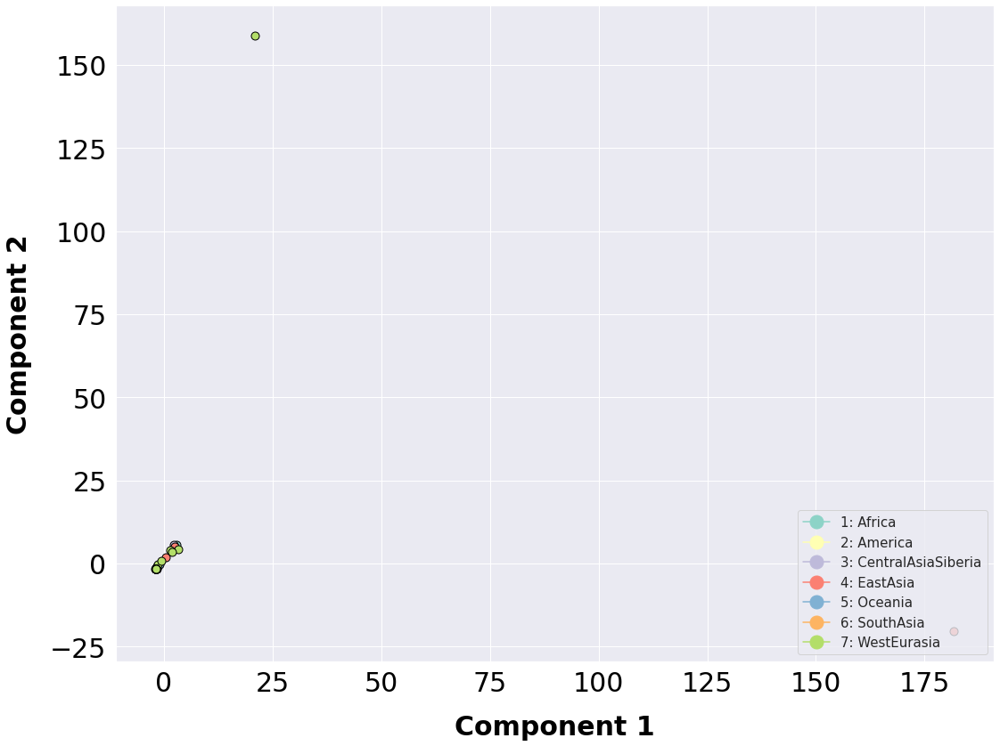

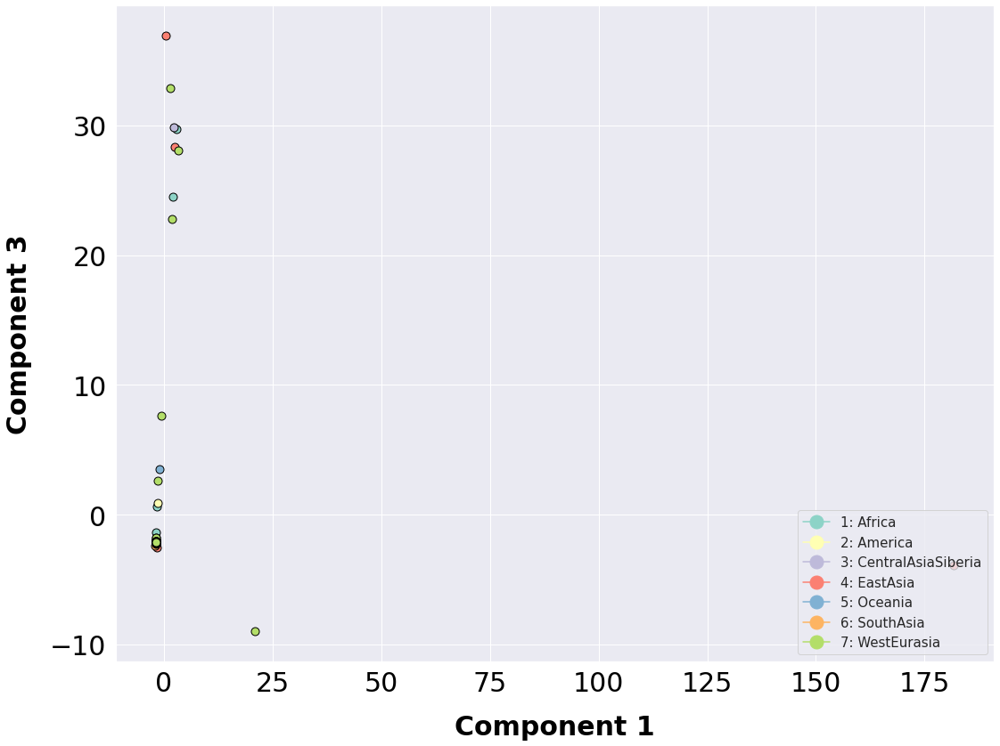

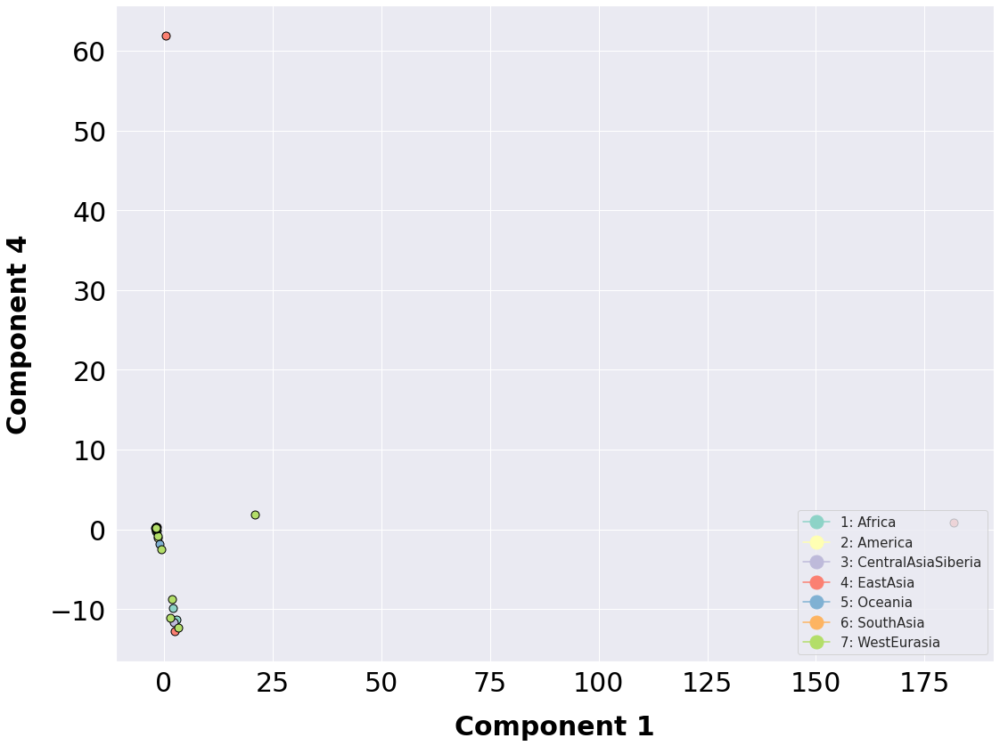

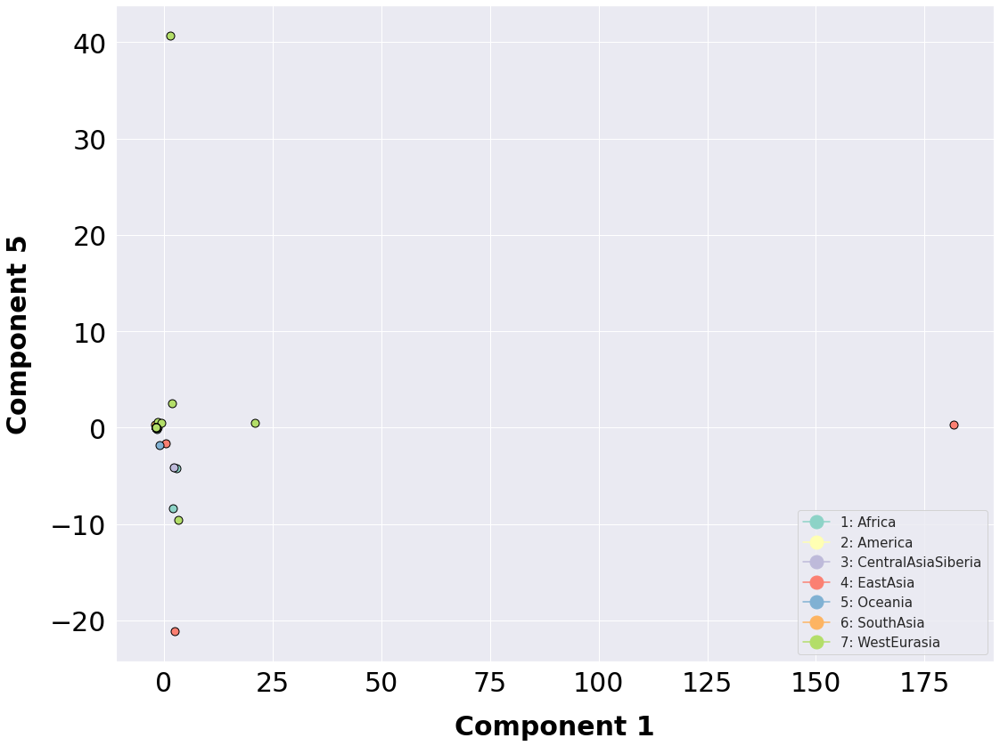

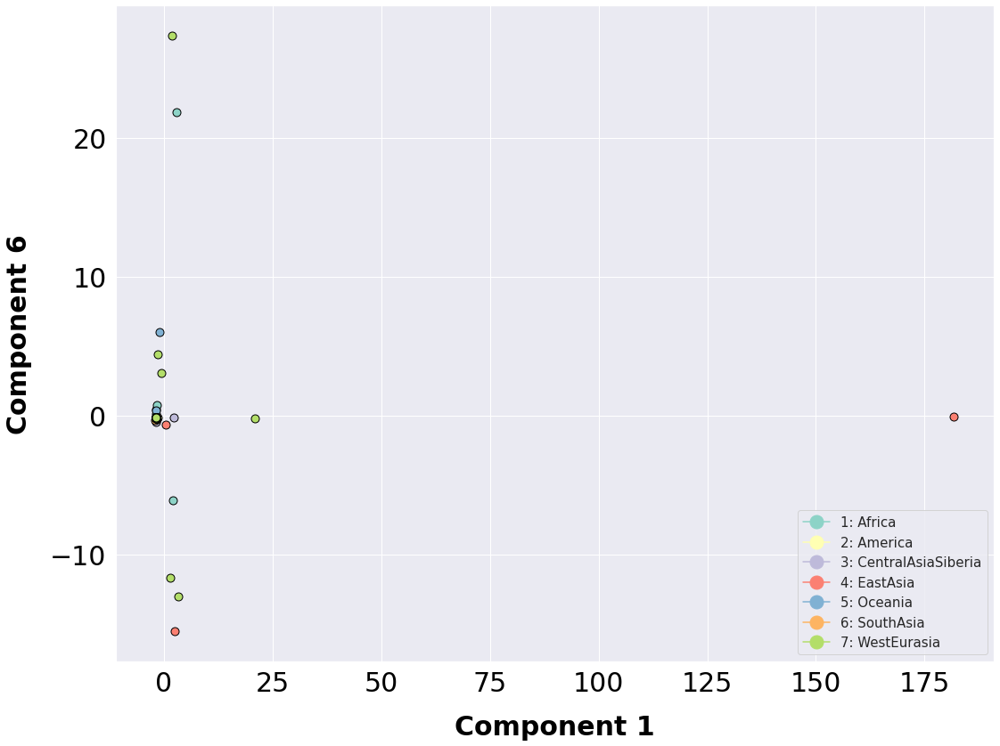

...

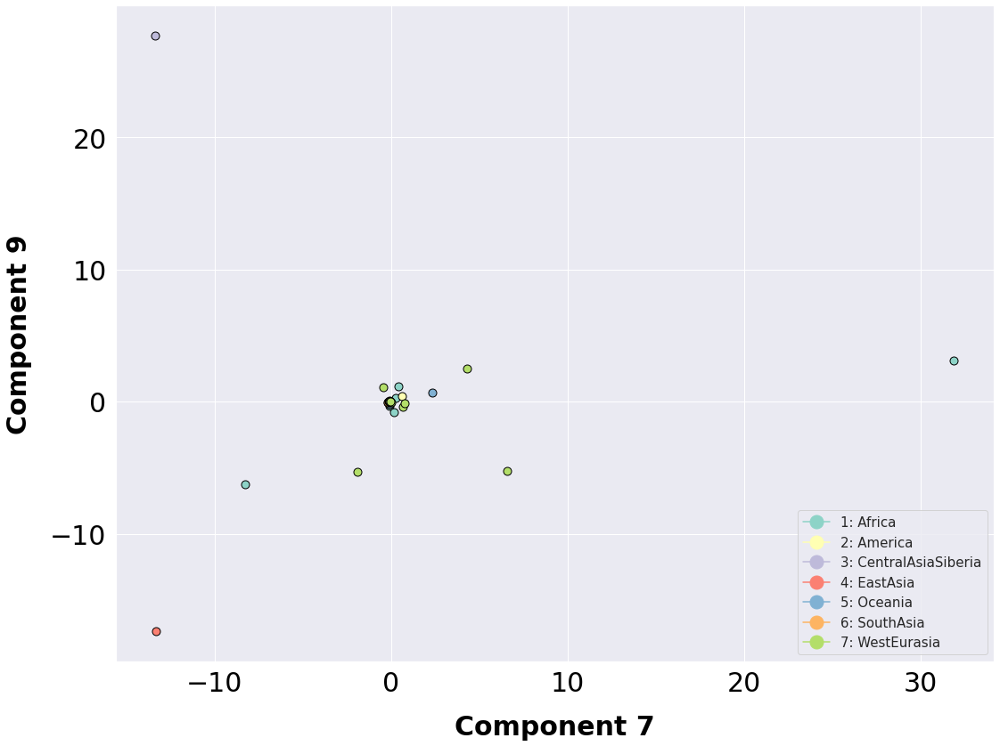

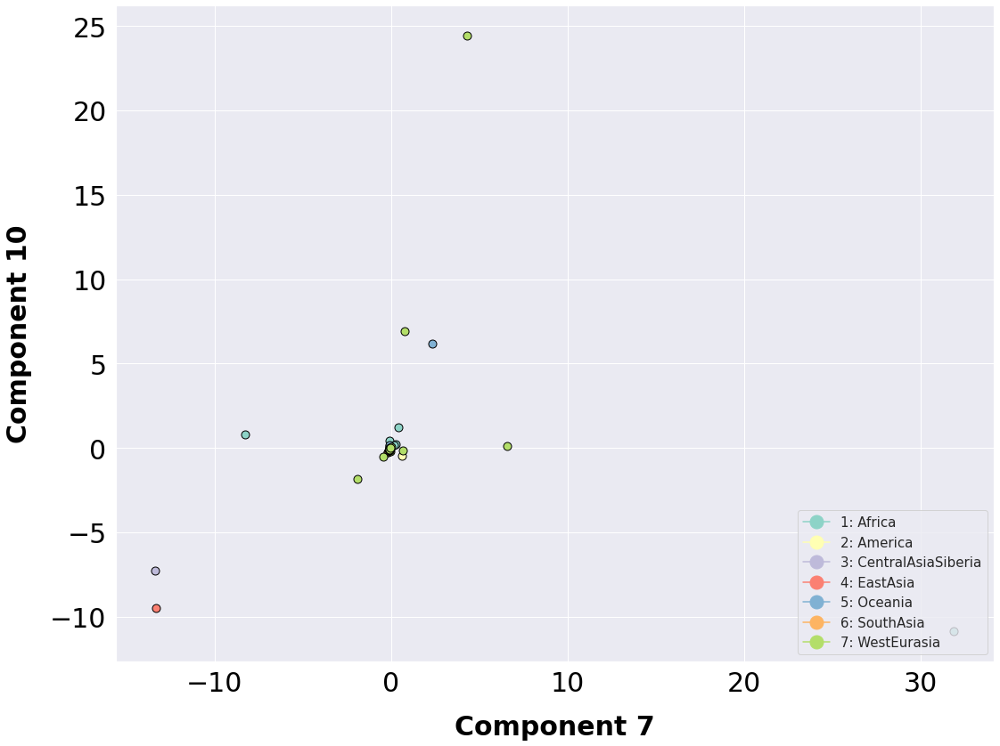

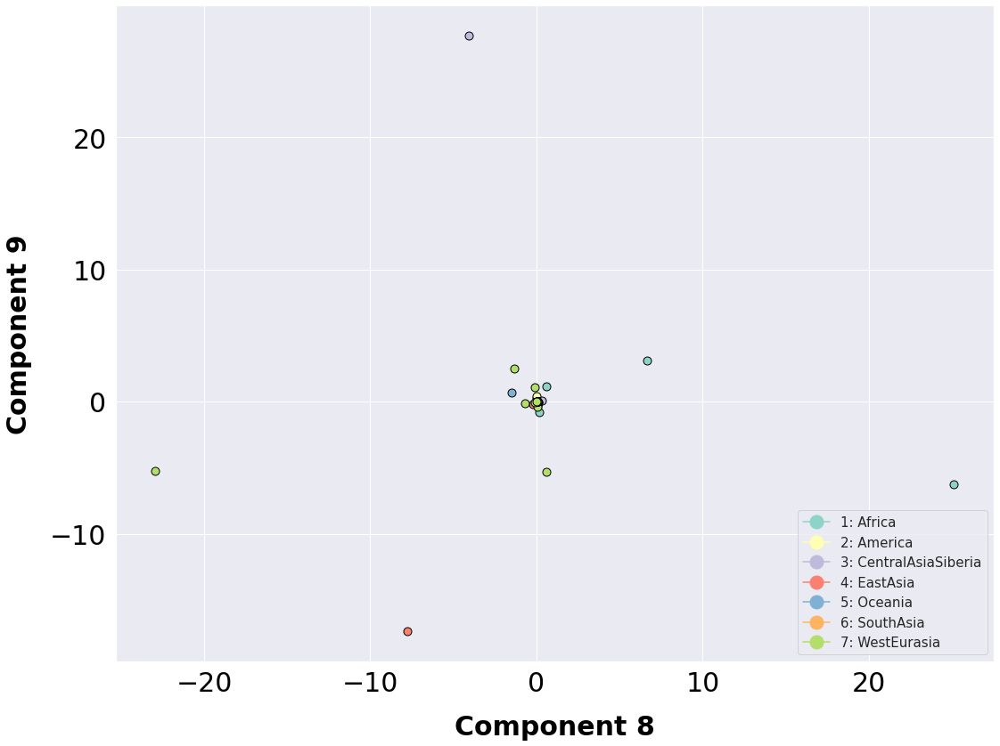

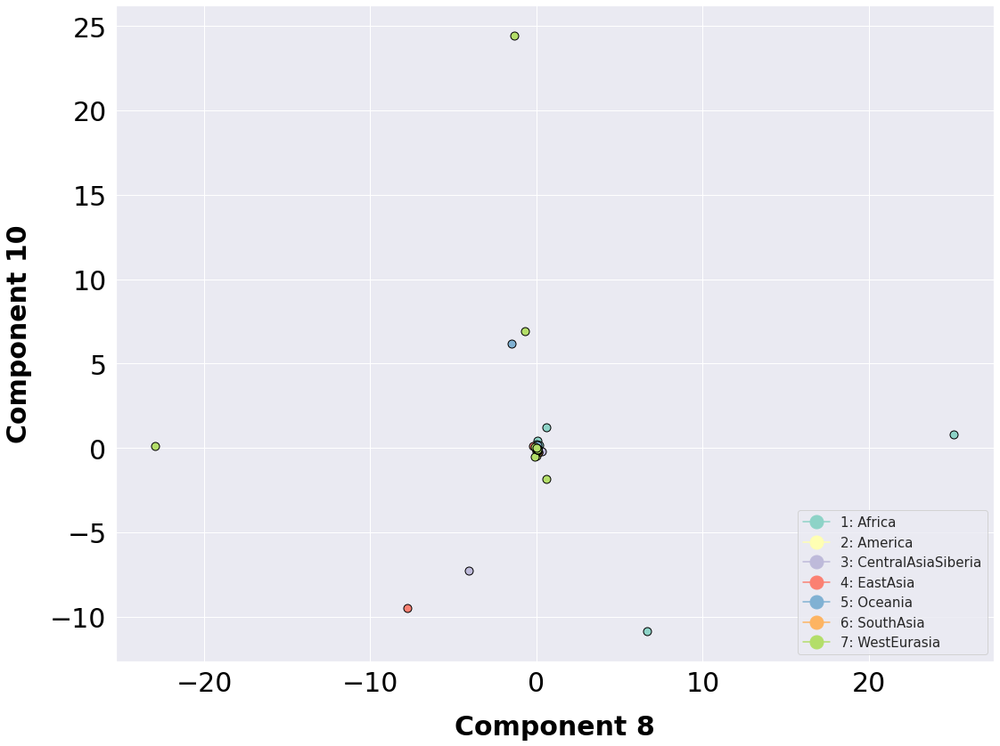

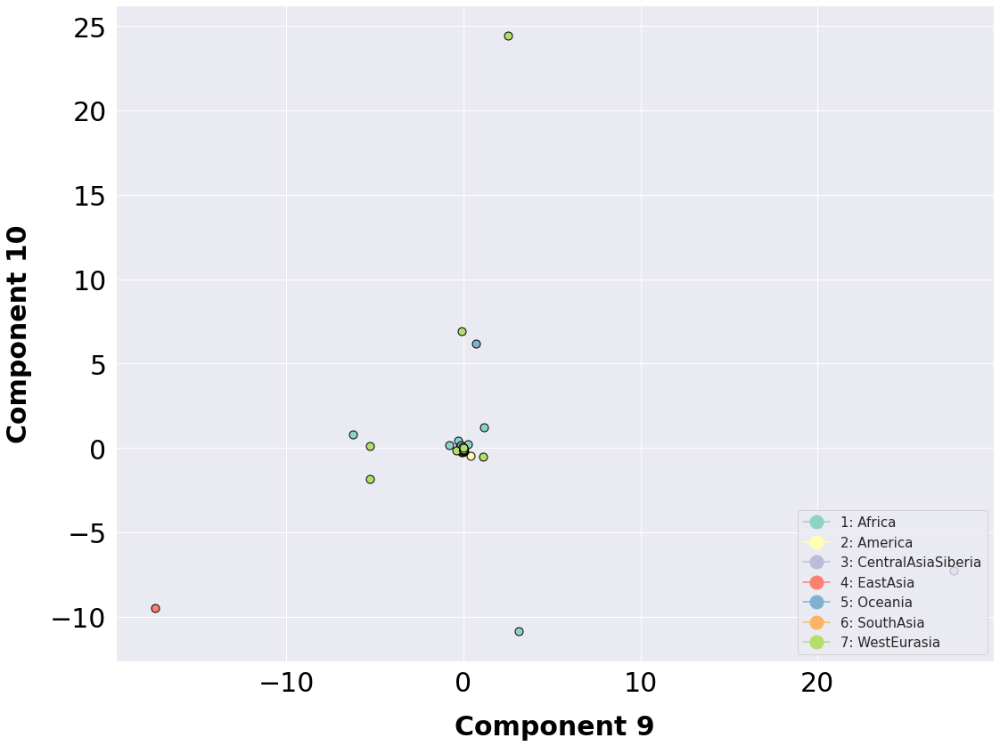

In [68]:
pca.explained_variance_ratio_
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='Component '+ str(i[0]), label_vertical='Component '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

In [69]:
pca.explained_variance_ratio_

array([0.33645782, 0.25862761, 0.07542736, 0.04688273, 0.0229361 ,
       0.01867063, 0.01502003, 0.01272818, 0.01175016, 0.00943722])

In [ ]:
# WISECONDOR AND QDNASEQ 


In [55]:
over = []

wocentromeres = []

q = qdnaseq_df.to_numpy()
w = wisecondor_data.to_numpy()
for cnv_q in q:
    for cnv_w in w:
        if cnv_q[0] == cnv_w[0]: #Sample
            if cnv_q[1] == cnv_w[1]: #Chromosome
                if cnv_w[2] <= cnv_q[2] <= cnv_w[3]:
                    over.append(cnv_q)
                
                if cnv_w[3] <= cnv_q[3] <= cnv_w[3]:
                    over.append(cnv_q)

SAMPLE,SAMEA3302613,SAMEA3302614,SAMEA3302615,SAMEA3302616,SAMEA3302619,SAMEA3302620,SAMEA3302621,SAMEA3302622,SAMEA3302624,SAMEA3302625,...,SAMEA3302889,SAMEA3302890,SAMEA3302893,SAMEA3302894,SAMEA3302900,SAMEA3302903,SAMEA3302906,SAMEA3302908,SAMEA3302911,SAMEA3449877
0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
1,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
2,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
3,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
4,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
789,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
790,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
791,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
792,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,1.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0


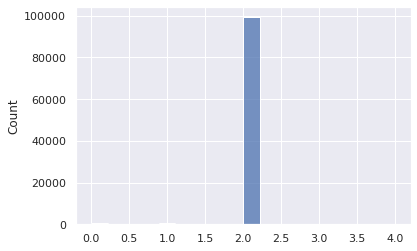

In [66]:
overlap = pd.DataFrame(over)
overlap.columns =['SAMPLE', 'CHR', 'START', 'END', 'SIZE','TYPE','SCORE']

overlap_df = overlap.pivot_table(index=["CHR", "START", "END"], 
                    columns='SAMPLE', 
                    values='TYPE').reset_index()


counts = overlap_df.iloc[:,3:283]

counts = counts.fillna(2)

hist = (np.array(counts).flatten())
seaborn.histplot(hist)


counts

In [65]:
overlap 

,SAMPLE,CHR,START,END,SIZE,TYPE,SCORE
0,SAMEA3302900,X,865001,910000,45000,4,0.48
1,SAMEA3302790,Y,18640001,18680000,40000,3,0.52
2,SAMEA3302634,8,2600001,3460000,860000,3,0.49
3,SAMEA3302874,14,43530001,46380000,2850000,3,0.58
4,SAMEA3302871,6,60620001,61665000,1045000,3,0.51
...,...,...,...,...,...,...,...
1519,SAMEA3302816,X,156010001,156035000,25000,0,-2.10
1520,SAMEA3302816,Y,2780001,26675000,23895000,0,-0.94
1521,SAMEA3302866,X,141475001,141595000,120000,1,-2.46
1522,SAMEA3302842,X,2780001,155705000,152925000,0,-1.03


In [58]:
qdnaseq_df.to_numpy()

array([['SAMEA3302854', '3', 75665001, ..., 45000, 3, 0.9],
       ['SAMEA3302854', '4', 9010001, ..., 495000, 3, 0.59],
       ['SAMEA3302854', '4', 68815001, ..., 40000, 3, 0.45],
       ...,
       ['SAMEA3302800', 'X', 155455001, ..., 50000, 0, -6.15],
       ['SAMEA3302800', 'Y', 2780001, ..., 23860000, 0, -20.51],
       ['SAMEA3302800', 'Y', 26640001, ..., 35000, 1, -5.8]], dtype=object)

In [60]:
wisecondor_data

,SAMPLE_NAME,CHR,START,END,RATIO,ZSCORE,TYPE
0,SAMEA3302611,3,187800001,190700000,-0.0440,-3.014739,loss
1,SAMEA3302611,18,68800001,70200000,0.0741,3.517015,gain
2,SAMEA3302612,7,12100001,16700000,0.0256,3.676230,gain
3,SAMEA3302612,18,58300001,60900000,-0.0423,-3.680554,loss
4,SAMEA3302612,X,62800001,80100000,-0.0578,-3.425668,loss
...,...,...,...,...,...,...,...
1130,SAMEA3302911,Y,23300001,26700000,-0.5524,-8.411547,loss
1131,SAMEA3449877,6,127800001,128500000,-0.2057,-6.220780,loss
1132,SAMEA3449877,X,200001,58000000,-0.1044,-6.413301,loss
1133,SAMEA3449877,X,62800001,156100000,-0.1198,-6.602066,loss


In [30]:
def plot_scatter_cluster(
data=None,
abscissa=None,
ordinate=None,
label_horizontal=None,
label_vertical=None,
factor=None,
fonts=None,
colors=None,
legend=None,
):
    """
    Creates a figure of a chart of type histogram to represent the frequency
    distribution of a single series of values.
    arguments:
        data (object): Pandas data frame of groups, series, and values
        abscissa (str): name of data column with independent variable
        ordinate (str): name of data column with dependent variable
        label_horizontal (str): label for horizontal axis
        label_vertical (str): label for vertical axis
        factor (str): name of data column with groups or factors of samples
        fonts (dict<object>): references to definitions of font properties
        colors (dict<tuple>): references to definitions of color properties
        legend (bool): whether to include a legend for series on the chart
    raises:
    returns:
        (object): figure object
    """
##########
# Organize data.
# Separate points by groups.
# Define groups.
    data = data.copy(deep=True)
    data.set_index(
        factor,
append=False,
drop=True,
inplace=True
    )
    print(data)
    groups = data.groupby(level=[factor])
    print("Count of groups by factor: " + str(len(groups)))
    colors_series = list(seaborn.color_palette("Set3", n_colors=len(groups)))
##########
# Create figure.
    figure = matplotlib.pyplot.figure(
    figsize=(15.748, 11.811),
    tight_layout=True
    )
# Create axes.
    axes = matplotlib.pyplot.axes()
    axes.set_xlabel(
    xlabel=label_horizontal,
labelpad=20,
alpha=1.0,
backgroundcolor=colors["white"],
color=colors["black"],
fontproperties=fonts["properties"]["one"]
    )
    axes.set_ylabel(
        ylabel=label_vertical,
        labelpad=20,
        alpha=1.0,
        backgroundcolor=colors["white"],
        color=colors["black"],
        fontproperties=fonts["properties"]["one"]
    )
    axes.tick_params(
        axis="both",
        which="both",
        direction="out",
        length=5.0,
        width=3.0,
        color=colors["black"],
        pad=5,
        labelsize=fonts["values"]["one"]["size"],
        labelcolor=colors["black"]
    )
# Plot points for values from each group.
    index = 0
    for name, group in groups:
        values_x = group[abscissa].to_list()
        values_y = group[ordinate].to_list()
        handle = axes.plot(
            values_x,
            values_y,
linestyle="",
marker="o",
markersize=9,
markeredgecolor=colors["black"],#colors_series[index],
markerfacecolor=colors_series[index]
        )
        index += 1
        pass
# Plot labels for each group.
    labels = []
    index = 0
    for name, group in groups:
        values_x = group[abscissa].to_list()
        mean_x = statistics.median(values_x)
        values_y = group[ordinate].to_list()
        mean_y = statistics.median(values_y)
#        axes.text(
#            mean_x,
#            mean_y,
#str(index+1),
#backgroundcolor=colors["white_faint"],
#color=colors["black"],
#fontproperties=fonts["properties"]["three"],
#horizontalalignment="center",
#verticalalignment="center"
#        )
        label = str(index+1) + ": " + name
        labels.append(label)
        index += 1
        pass
# Create legend.
# Create custome elements for the legend
    elements = create_legend_elements(
colors=colors_series,
labels=labels
    )
    axes.legend(
handles=elements,
loc="lower right",
prop=fonts["properties"]["four"],
    )
    return figure


def define_font_properties():
    """
    Defines font properties.
    arguments:
    raises:
    returns:
        (dict<object>): references to definitions of font properties
    """
# Define font values.
    values_one = {
"family": "sans-serif",
"style": "normal",
"variant": "normal",
"stretch": 1000,
"weight": 1000,
"size": 30
    }
    values_two = {
"family": "sans-serif",
"style": "normal",
"variant": "normal",
"stretch": 500,
"weight": 1000,
"size": 25
    }
    values_three = {
"family": "sans-serif",
"style": "normal",
"variant": "normal",
"stretch": 500,
"weight": 1000,
"size": 20
    }
    values_four = {
"family": "sans-serif",
"style": "normal",
"variant": "normal",
"stretch": 500,
"weight": 500,
"size": 15
    }
# Define font properties.
    properties_one = matplotlib.font_manager.FontProperties(
family=values_one["family"],
style=values_one["style"],
variant=values_one["variant"],
stretch=values_one["stretch"],
weight=values_one["weight"],
size=values_one["size"]
    )
    properties_two = matplotlib.font_manager.FontProperties(
family=values_two["family"],
style=values_two["style"],
variant=values_two["variant"],
stretch=values_two["stretch"],
weight=values_two["weight"],
size=values_two["size"]
    )
    properties_three = matplotlib.font_manager.FontProperties(
family=values_three["family"],
style=values_three["style"],
variant=values_three["variant"],
stretch=values_three["stretch"],
weight=values_three["weight"],
size=values_three["size"]
    )
    properties_four = matplotlib.font_manager.FontProperties(
family=values_four["family"],
style=values_four["style"],
variant=values_four["variant"],
stretch=values_four["stretch"],
weight=values_four["weight"],
size=values_four["size"]
    )
# Compile and return references.
    return {
"values": {
"one": values_one,
"two": values_two,
"three": values_three,
"four": values_four
        },
"properties": {
"one": properties_one,
"two": properties_two,
"three": properties_three,
"four": properties_four
        }
    }



def define_color_properties():
    """
    Defines color properties.
    arguments:
    raises:
    returns:
        (dict<tuple>): references to definitions of color properties
    """
# Black.
    black = (0.0, 0.0, 0.0, 1.0)
# White.
    white = (1.0, 1.0, 1.0, 1.0)
    white_faint = (1.0, 1.0, 1.0, 0.75)
# Blue.
    blue = (0.0, 0.2, 0.5, 1.0)
    blue_faint = (0.0, 0.2, 0.5, 0.75)
# Orange.
    orange = (1.0, 0.6, 0.2, 1.0)
    orange_faint = (1.0, 0.6, 0.2, 0.75)
# Compile and return references.
    return {
"black": black,
"white": white,
"white_faint": white_faint,
"blue": blue,
"blue_faint": blue_faint,
"orange": orange,
"orange_faint": orange_faint
    }


def create_legend_elements(
colors=None,
labels=None,
):
    """
    Creates custom elements for legend.
    arguments:
        colors (list<dict>): colors
        labels (str): name of data column with independent variable
    raises:
    returns:
        (list<object>): elements for legend
    """
    elements = []
    for index in range(len(labels)):
        element = matplotlib.lines.Line2D(
            [0],
            [0],
            marker="o",
            color=colors[index],
            label=labels[index],
            markerfacecolor=colors[index],
            markersize=15,
        )
        elements.append(element)
    return elements



